# 正規分布の共役事前分布(正規ガンマ分布)
 
黒木玄

2017-11-28～2018-01-26, 2018-04-02, 2018-10-11

* Copyright 2018 Gen Kuroki
* License: MIT https://opensource.org/licenses/MIT

<h1>目次<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#解説" data-toc-modified-id="解説-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>解説</a></span><ul class="toc-item"><li><span><a href="#正規分布とガンマ分布" data-toc-modified-id="正規分布とガンマ分布-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>正規分布とガンマ分布</a></span></li><li><span><a href="#共役事前分布(正規ガンマ分布)" data-toc-modified-id="共役事前分布(正規ガンマ分布)-1.2"><span class="toc-item-num">1.2&nbsp;&nbsp;</span>共役事前分布(正規ガンマ分布)</a></span></li><li><span><a href="#共役事前分布のベイズ更新" data-toc-modified-id="共役事前分布のベイズ更新-1.3"><span class="toc-item-num">1.3&nbsp;&nbsp;</span>共役事前分布のベイズ更新</a></span></li><li><span><a href="#予測分布" data-toc-modified-id="予測分布-1.4"><span class="toc-item-num">1.4&nbsp;&nbsp;</span>予測分布</a></span></li><li><span><a href="#分配函数" data-toc-modified-id="分配函数-1.5"><span class="toc-item-num">1.5&nbsp;&nbsp;</span>分配函数</a></span></li><li><span><a href="#LOOCV-(1個抜き出し交差検証,-leave-one-out-cross-validation)" data-toc-modified-id="LOOCV-(1個抜き出し交差検証,-leave-one-out-cross-validation)-1.6"><span class="toc-item-num">1.6&nbsp;&nbsp;</span>LOOCV (1個抜き出し交差検証, leave-one-out cross-validation)</a></span></li><li><span><a href="#ベイズ自由エネルギー" data-toc-modified-id="ベイズ自由エネルギー-1.7"><span class="toc-item-num">1.7&nbsp;&nbsp;</span>ベイズ自由エネルギー</a></span></li><li><span><a href="#対数尤度函数およびその二乗の期待値" data-toc-modified-id="対数尤度函数およびその二乗の期待値-1.8"><span class="toc-item-num">1.8&nbsp;&nbsp;</span>対数尤度函数およびその二乗の期待値</a></span></li><li><span><a href="#WBIC" data-toc-modified-id="WBIC-1.9"><span class="toc-item-num">1.9&nbsp;&nbsp;</span>WBIC</a></span></li><li><span><a href="#WAIC" data-toc-modified-id="WAIC-1.10"><span class="toc-item-num">1.10&nbsp;&nbsp;</span>WAIC</a></span></li><li><span><a href="#improved-WBIC?" data-toc-modified-id="improved-WBIC?-1.11"><span class="toc-item-num">1.11&nbsp;&nbsp;</span>improved WBIC?</a></span></li></ul></li><li><span><a href="#パッケージの読み込み" data-toc-modified-id="パッケージの読み込み-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>パッケージの読み込み</a></span></li><li><span><a href="#逆温度βの擬似確率分布の定義" data-toc-modified-id="逆温度βの擬似確率分布の定義-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>逆温度βの擬似確率分布の定義</a></span></li><li><span><a href="#正規ガンマ分布" data-toc-modified-id="正規ガンマ分布-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>正規ガンマ分布</a></span></li><li><span><a href="#ベイズ更新" data-toc-modified-id="ベイズ更新-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>ベイズ更新</a></span></li><li><span><a href="#WBICとWAIC" data-toc-modified-id="WBICとWAIC-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>WBICとWAIC</a></span></li><li><span><a href="#AICとBIC" data-toc-modified-id="AICとBIC-7"><span class="toc-item-num">7&nbsp;&nbsp;</span>AICとBIC</a></span></li><li><span><a href="#事前分布,-事後分布,-WAIC,-WBICのプロット" data-toc-modified-id="事前分布,-事後分布,-WAIC,-WBICのプロット-8"><span class="toc-item-num">8&nbsp;&nbsp;</span>事前分布, 事後分布, WAIC, WBICのプロット</a></span></li><li><span><a href="#ベイズ自由エネルギーの積分による近似計算" data-toc-modified-id="ベイズ自由エネルギーの積分による近似計算-9"><span class="toc-item-num">9&nbsp;&nbsp;</span>ベイズ自由エネルギーの積分による近似計算</a></span></li><li><span><a href="#事前分布選択" data-toc-modified-id="事前分布選択-10"><span class="toc-item-num">10&nbsp;&nbsp;</span>事前分布選択</a></span></li></ul></div>

## 解説

### 正規分布とガンマ分布

正規分布の確率密度函数を

$$
p_N(x|\mu,\lambda) = \frac{1}{\sqrt{2\pi}}e^{-\lambda(x-\mu)^2/2}\lambda^{1/2}
$$

と表わすことにする. この正規分布の平均と標準偏差はそれぞれ $\mu$, $\sigma=1/\sqrt{\lambda}$ である.

ガンマ分布の確率密度函数を

$$
p_\Gamma(\lambda|\alpha,\theta) = \frac{1}{\Gamma(\alpha)\theta^\alpha}e^{-\lambda/\theta}\lambda^{\alpha-1}
$$

と表わす. このガンマ分布の平均と標準偏差はそれぞれ $\mu_\lambda=\alpha\theta$, $\sigma_\lambda=\sqrt{\alpha\theta^2}$ である.

### 共役事前分布(正規ガンマ分布)

正規分布の共役事前分布 $\varphi$ が次のように定義される:

$$
\begin{aligned}
\varphi(\mu,\lambda|\mu_0,\lambda_0,\alpha,\theta) &=
p_N(\mu|\mu_0, \lambda\lambda_0)p_\Gamma(\lambda|\alpha,\theta) \\ & =
\sqrt{\frac{\lambda_0}{2\pi}} \frac{1}{\Gamma(\alpha)\theta^\alpha}
\exp\left[-\frac{\lambda}{2}\left( \lambda_0(\mu-\mu_0)^2 + 2\theta^{-1} \right)\right]
\lambda^{\alpha+1/2-1}.
\end{aligned}
$$

この確率密度函数で定義される確率分布を**正規ガンマ分布**と呼ぶことにする. 

正規ガンマ分布 $\varphi(\mu,\lambda)=\varphi(\mu,\lambda|\mu_0,\lambda_0,\alpha,\theta)$ に関する $f(\mu,\lambda)$ の平均を

$$
E_{\varphi(\mu,\lambda)}[f(\mu,\lambda)]
=\int_0^\infty d\lambda\int_{-\infty}^\infty d\mu\;f(\mu,\lambda)\varphi(\mu,\lambda)
$$

と書くことにする.

$\mu_\lambda = \alpha\theta$ とおく. このとき

$$
\begin{aligned}
&
E_{\varphi(\mu,\lambda)}[\mu] = \mu_0, 
& &
E_{\varphi(\mu,\lambda)}[(\mu-\mu_0)^2] = 
\begin{cases}
\dfrac{1}{\lambda_0\mu_\lambda(1-\alpha^{-1})} & (\alpha > 1),\\
\infty & (0<\alpha\leqq 1),
\end{cases}
\\ &
E_{\varphi(\mu,\lambda)}[\lambda] = \alpha\theta = \mu_\lambda,
& &
E_{\varphi(\mu,\lambda)}[(\lambda-\mu_\lambda)^2] = \alpha\theta^2 = \frac{\mu_\lambda^2}{\alpha}.
\end{aligned}
$$

$\mu_0$ と $\mu_\lambda$ を一定とするとき, $\mu,\lambda$ の分散を大きくするためには $\alpha$ と $\lambda_0$ を小さくすればよい.

### 共役事前分布のベイズ更新

事前分布 $\varphi(\mu,\lambda)$ と サンプル $X_1,\ldots,X_n$ に関する逆温度 $\beta$ の事後分布 $\tilde\varphi(\mu,\lambda)$ は次の式で定義される:

$$
\tilde\varphi(\mu,\lambda) =
\frac
{\left(\prod_{i=1}^n p_N(X_i|\mu,\lambda)\right)^\beta\varphi(\mu,\lambda)}
{\int_0^\infty d\lambda\int_{-\infty}^\infty d\mu\,\left(\prod_{i=1}^n p_N(X_i|\mu,\lambda)\right)^\beta\varphi(\mu,\lambda)}.
$$

$\varphi(\mu,\lambda) = \varphi(\mu,\lambda|\mu_0,\lambda_0,\alpha,\theta)$ のとき

$$
\tilde\varphi(\mu,\lambda) = \varphi(\mu,\lambda|\tilde\mu_0, \tilde\lambda_0, \tilde\alpha, \tilde\theta)
$$

となる. ただし, $\tilde\mu_0, \tilde\lambda_0, \tilde\alpha, \tilde\theta$ は, サンプルの平均と分散を

$$
\bar X = \frac{1}{n}\sum_{i=1}^n X_i, \quad
V(X) = \frac{1}{n}\sum_{i=1}^n (X_i - \bar X)^2.
$$

書くことにすると, 以下のように定義される:

$$
\begin{aligned}
&
\tilde\mu_0 = \frac{\lambda_0\mu_0 + \beta n \bar X}{\lambda_0 + \beta n}, %\quad
& &
\tilde\lambda_0 = \lambda_0 + \beta n, \quad
\\ &
\tilde\alpha = \alpha + \frac{1}{2}\beta n, %\quad
& &
{\tilde\theta}^{-1} = \theta^{-1}\left[
1 + \frac{\theta}{2}\left(
\frac{\beta n\lambda_0}{\lambda_0 + \beta n}\left(\bar X - \mu_0\right)^2 + \beta n V(X)
\right)
\right].
\end{aligned}
$$

これを共役事前分布のベイズ更新と呼ぶ. 共役分布のベイズ更新はもとのパラメーターと $\beta n$, $\bar X$, $V(X)$ で表わされる. サンプルのサイズと逆温度の積, サンプルの平均, サンプルの分散の情報があればベイズ更新可能である.

### 予測分布

$\varphi(\mu,\lambda) = \varphi(\mu,\lambda|\mu_0,\lambda_0,\alpha,\theta)$ に関する予測分布 $p^*(x)$ が

$$
p^*(x) = E_{\varphi(\mu,\lambda)}[p_N(x|\mu,\lambda)] = \int_0^\infty d\lambda\int_{-\infty}^\infty p_N(x|\mu,\lambda)\varphi(\mu,\lambda)
$$

と定義される.  予測分布は次の形になる:

$$
p^*(x) =
\sqrt{\frac{1}{2\pi}\frac{\theta\lambda_0}{\lambda_0+1}}\;
\frac{\Gamma(\alpha+1/2)}{\Gamma(\alpha)}
\left[
1 + \frac{1}{2}\frac{\theta\lambda_0}{\lambda_0+1}(x-\mu_0)^2
\right]^{-(\alpha+1/2)}.
$$

この分布は自由度 $\nu = 2\alpha$ のt分布を $\mu_0$ が中心になるように平行移動し, $\displaystyle \rho = \sqrt{\frac{\lambda_0+1}{\lambda_0\alpha\theta}}$ 倍でスケール変換して得らえる確率分布である. この予測分布に従う確率変数 $X^*$ は自由度 $\nu$ のt分布に従う確率変数 $T(\nu)$ によって

$$
X^* = \mu_0 + \rho\,T(\nu), \quad \rho = \sqrt{\frac{\lambda_0+1}{\lambda_0\alpha\theta}}, \quad \nu=2\alpha
$$

と表わされる. 自由度 $\nu$ を大きくするとt分布は正規分布に近付く.

サンプルサイズ $n$ を大きくすると, 予測分布は平均 $\bar X$, 分散 $V(X)$ の正規分布に漸近して行く.

### 分配函数

$\varphi(\mu,\lambda) = \varphi(\mu,\lambda|\mu_0,\lambda_0,\alpha,\theta)$ に関する逆温度 $\beta$ の分配函数が次のように定義される:

$$
Z^\beta(X_1,\ldots,X_n|\mu_0,\lambda_0,\alpha,\theta) = 
\int_0^\infty d\lambda\int_{-\infty}^\infty d\mu\;
\left(\prod_{i=1}^n p_N(X_i|\mu,\lambda)\right)^\beta\varphi(\mu,\lambda).
$$

これは次のように表わされる:

$$
Z^\beta(X_1,\ldots,X_n|\mu_0,\lambda_0,\alpha,\theta) = 
\frac
{z(\tilde\mu_0, \tilde\lambda_0, \tilde\alpha, \tilde\theta)}
{(2\pi)^{\beta n/2}\; z(\mu_0,\lambda_0,\alpha,\theta)}.
$$

ここで, 

$$
z(\mu_0,\lambda_0,\alpha,\theta) =
\sqrt{\frac{2\pi}{\lambda_0}} \Gamma(\alpha)\theta^\alpha.
$$

この公式を用いれば対数分配函数 $\log Z^\beta(\mu_0,\lambda_0,\alpha,\theta)$ に関する公式も得られる:

$$
\log Z^\beta(X_1,\ldots,X_n|\mu_0,\lambda_0,\alpha,\theta) = \log z(\tilde\mu_0, \tilde\lambda_0, \tilde\alpha, \tilde\theta) - \log z(\mu_0,\lambda_0,\alpha,\theta) -\frac{\beta n}{2}\log(2\pi).
$$

ここで

$$
\log z(\mu_0,\lambda_0,\alpha,\theta) = \frac{1}{2}\left(\log(2\pi) - \log\lambda_0\right) + \log\Gamma(\alpha) + \alpha\log\theta.
$$

### LOOCV (1個抜き出し交差検証, leave-one-out cross-validation)

このノートでは情報量規準のスケールとして, AICやBICで採用されている伝統的なスケールを採用する. そのスケールのもとで LOOCV は次のように定義される:

$$
\mathrm{LOOCV} = - 2\sum_{i=1}^n \log
\left(\text{逆温度 $\beta$ におけるサンプル $X_1,\ldots,\widehat X_i,\ldots,X_n$ の事後分布に関する $p_N(X_i|\mu,\lambda)$} の期待値\right).
$$

ここで $\widehat X_i$ は $X_i$ を除くという意味である.  $X_i$ を除いたサンプルに関する事後分布に関する期待値は除かない場合の期待値で書ける. 除かない場合の通常の逆温度は $\beta$ の事後分布に関する期待値を $E_{\tilde\varphi(\mu,\lambda)}[f(\mu,\lambda)]$ と書くことにすると, 

$$
\mathrm{LOOCV} = - 2\sum_{i=1}^n \log\frac
{E_{\tilde\varphi(\mu,\lambda)}\left[p_N(X_i|\mu,\lambda)^{1-\beta}\right]}
{E_{\tilde\varphi(\mu,\lambda)}\left[p_N(X_i|\mu,\lambda)^{-\beta}\right]}.
$$

分配函数の定義より, 

$$
Z^\kappa(x|\tilde\mu_0, \tilde\lambda_0, \tilde\alpha, \tilde\theta) =
\int_0^\infty d\lambda\int_{-\infty}^\infty d\mu\;
p_N(x|\mu,\lambda)^\kappa\;\varphi(\mu,\lambda|\tilde\mu_0, \tilde\lambda_0, \tilde\alpha, \tilde\theta).
$$

であることに注意すれば, LOOCVは事後分布を事前分布とする分配函数によって次のように表わされることがわかる:

$$
\mathrm{LOOCV} = - 2\sum_{i=1}^n \log\frac
{Z^{1-\beta}(X_i|\tilde\mu_0, \tilde\lambda_0, \tilde\alpha, \tilde\theta)}
{Z^{-\beta}(X_i|\tilde\mu_0, \tilde\lambda_0, \tilde\alpha, \tilde\theta)}.
$$

この公式に前節の公式を適用すればLOOCVを計算できる.

### ベイズ自由エネルギー

AICやBICの伝統的なスケールのもとでの逆温度 $\beta$ のベイズ自由エネルギーは次のように定義される:

$$
\mathrm{BayesianFreeEnergy} = 
-\frac{2}{\beta}\log Z^\beta(X_1,\ldots,X_n|\tilde\mu_0, \tilde\lambda_0, \tilde\alpha, \tilde\theta).
$$

### 対数尤度函数およびその二乗の期待値

WBICやWAICの公式を作るためには $\varphi(\mu,\lambda) = \varphi(\mu,\lambda|\mu_0,\lambda_0,\alpha,\theta)$ に関する $\log p_N(x|\mu,\lambda)$ およびその二乗の平均の公式を作っておく必要がある. その結果は以下の通り. 函数 $f(\mu,\lambda)$ に対して

$$
E_{\varphi(\mu,\lambda)}[f(\mu,\lambda)] = \int_0^\infty d\lambda \int_{-\infty}^\infty d\mu\;
f(\mu,\lambda)\;\varphi(\mu,\lambda|\mu_0,\lambda_0,\alpha,\theta)
$$

と書くことにする.  このとき, 

$$
-2 E_{\varphi(\mu,\lambda)}[\log p_N(x|\mu,\lambda)] =
\log(2\pi) + \alpha\theta(x-\mu_0)^2 + \frac{1}{\lambda_0} - (\psi(\alpha)+\log\theta).
$$

ここで $\psi(\alpha)$ はガンマ函数の対数微分であり, digamma函数と呼ばれる. さらに

$$
\begin{aligned}
4 E_{\varphi(\mu,\lambda)}\left[(\log p_N(x|\mu,\lambda))^2\right]
&= (\log(2\pi))^2
\\ & + (\alpha+1)\alpha\theta^2(x-\mu_0)^4 + \frac{6\alpha\theta}{\lambda_0}(x-\mu_0)^2 + \frac{3}{\lambda_0^2}
\\ & + \psi'(\alpha) + (\psi(\alpha)+\log\theta)^2
\\ & + 2\log(2\pi)\left(\alpha\theta(x-\mu_0)^2+\frac{1}{\lambda_0}\right)
\\ & - 2\log(2\pi)(\psi(\alpha)+\log\theta)
\\ & - 2\left( (x-\mu_0)^2 (\theta+\alpha\theta\;(\psi(\alpha)+\log\theta)) + \frac{\psi(\alpha)+\log\theta}{\lambda_0} \right).
\end{aligned}
$$

これらの公式を使えば, WBICとWAICを正確に計算するための公式が得られる.

このノートブックでは実際にその公式を使ってWBICとWAICを計算できるようにしてある.

**訂正(2018-04-02)** $4 E_{\varphi(\mu,\lambda)}\left[(\log p_N(x|\mu,\lambda))^2\right]$ の公式の最後の項を修正した(なぜか $\alpha\theta/\lambda=0$ になっていた).  WBICを計算するためのコードの方には誤りは無かった.

### WBIC

対数分配函数の $\beta$ による微分は次のように書ける:

$$
Z(\beta) = Z^\beta(X_1,\ldots,X_n|\mu_0,\lambda_0,\alpha,\theta), \quad
\tilde\varphi(\mu,\lambda) = \varphi(\mu,\lambda|\tilde\mu_0, \tilde\lambda_0, \tilde\alpha, \tilde\theta)
$$

とおくと,  $Z(0)=1$ でかつ

$$
-\frac{\partial}{\partial\beta}\log Z(\beta)=
\int_0^\infty d\lambda\int_{-\infty}^\infty d\mu\;
H(\lambda,\mu)\;\tilde\varphi(\mu,\lambda) = E_{\tilde\varphi(\mu,\lambda)}[H(\mu,\lambda)].
$$

ここで

$$
H(w) = - \sum_{i=1}^n \log p(X_i|\mu,\lambda).
$$

$\tilde\varphi(\mu,\lambda)$ で省略されているパラメーターの中に逆温度 $\beta$ が含まれていることに注意せよ.

ゆえに,

$$
-\log Z(1) = \int_0^1 d\beta\;E_{\tilde\varphi(\mu,\lambda)}[H(\mu,\lambda)]
$$

WBICの理論によれば上の $\log Z(1)$ は $\beta=1/\log n$ における $E_{\tilde\varphi(\mu,\lambda)}[H(\mu,\lambda)]$ の値で近似される.  AICとBICの伝統的スケールでWBICは次のように定義される:

$$
\mathrm{WBIC} = 
2\left.E_{\tilde\varphi(\mu,\lambda)}[H(\mu,\lambda)]\right|_{\beta = 1/\log n} =
2\left.\sum_{i=1}^n E_{\tilde\varphi(\mu,\lambda)}[-\log p_N(X_i|\mu,\lambda)]\right|_{\beta = 1/\log n}.
$$

これは前節の公式を使えば計算できる. WBICは $\beta=1$ での BayesianFreeEnergy の推定値になっている.

WBICについては

http://watanabe-www.math.dis.titech.ac.jp/users/swatanab/wbic2012.html

を見よ.  そこでは, このノートにおける $H(w)=H(\mu,\lambda)$ は $E^\beta_w[nL_n(w)]$ と書かれている.

$$
\mathrm{WBIC} = 2\left(\text{逆温度 $\beta=\frac{1}{\log n}$ での事後分布に関する対数尤度函数の $-1$ 倍の期待値}\right).
$$

### WAIC

AICやBICの伝統的なスケールにおけるWAICは以下のように定義される:

$$
\mathrm{WAIC} = 2(T + \beta V).
$$

ここで

$$
\begin{aligned}
&
T = -\sum_{i=1}^n \log\tilde p^*_N(X_i),
\\ &
\tilde p^*(x) = E_{\tilde\varphi(\mu,\lambda)}[p_N(X_i|\mu,\lambda)],
\\ &
V = \sum_{i=1}^n V_{\tilde\varphi(\mu,\lambda)}\left[\log p_N(X_i|\mu,\lambda)\right],
\\ &
V_{\tilde\varphi(\mu,\lambda)}\left[\log p_N(X_i|\mu,\lambda)\right] =
E_{\tilde\varphi(\mu,\lambda)}\left[(\log p_N(X_i|\mu,\lambda))^2\right] -
E_{\tilde\varphi(\mu,\lambda)}\left[\log p_N(X_i|\mu,\lambda)\right]^2. 
\end{aligned}
$$

これらは前々節の公式を使えば計算可能である.

WAICについては次のサイトを参照せよ:

http://watanabe-www.math.dis.titech.ac.jp/users/swatanab/waic2011.html

$$
\begin{aligned}
\mathrm{WAIC} & = -2
\sum_{i=1}^n\log\left(\text{逆温度 $\beta$ での事後分布に関する $p(X_i|w)$ の期待値}\right)
\\ & + 2\beta
\sum_{i=1}^n\left(\text{逆温度 $\beta$ での事後分布に関する $\log p(X_i|w)$ の分散}\right).
\end{aligned}
$$


### improved WBIC?

<a href="https://blog.albert2005.co.jp/2016/04/19/%E3%83%99%E3%82%A4%E3%82%BA%E6%83%85%E5%A0%B1%E9%87%8F%E8%A6%8F%E6%BA%96%E5%8F%8A%E3%81%B3%E3%81%9D%E3%81%AE%E7%99%BA%E5%B1%95-%EF%BD%9E%E6%A6%82%E8%AA%AC%E7%B7%A8%EF%BD%9E/">ベイズ情報量規準及びその発展 ～概説編～ 2016年4月19日</a>

には improved WBIC に関する研究が賞をもらったと書いてある:

https://www.albert2005.co.jp/release/archives/201604/19_110050.html

しかし, Googleなどで検索しても論文を見付けることができなかった(2017-11-30).

さらに検索を続けると

http://onlinelibrary.wiley.com/doi/10.1111/rssb.12187/full

のdiscussionに定義式が書いてあるように見えた. その部分を次のセルに引用しておく.


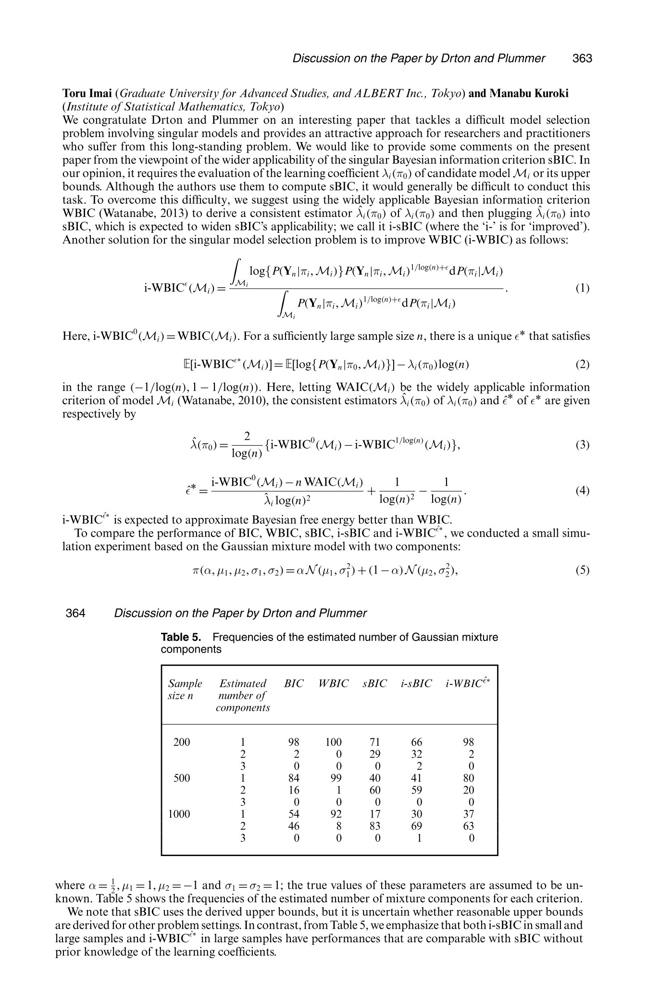

In [1]:
using Base64
open("drton2017_01.jpg") do f
    base64 = base64encode(f)
    display("text/html", """<img src="data:image/jpg;base64,$base64">""")
end

筆者なりに計算した結果は以下の通り. 以下ではAICやBICの伝統的なスケールをWAICやWBICでも採用する. WBICは次の論文の2倍がこのノートでの定義になる(WAICは $2n$ 倍). 

WBICの元論文は

[WBIC] http://www.jmlr.org/papers/volume14/watanabe13a/watanabe13a.pdf

である. このノートのWBICの定義はこの論文の定義の2倍である.

WAICについては

[渡辺] 渡辺澄夫『ベイズ統計の理論と方法』

の解説が詳しい. このノートのWAICの定義はこの本の定義の $2n$ 倍である.

[WBIC]のpp.876--877を次のセルに引用しておく.


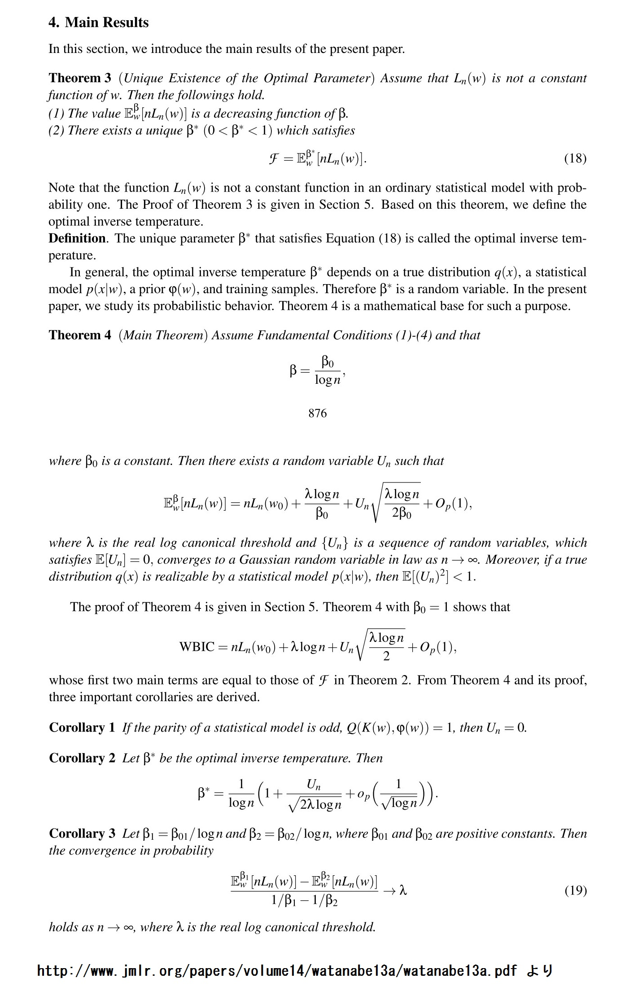

In [2]:
open("WBIC_paper_01.jpg") do f
    base64 = base64encode(f)
    display("text/html", """<img src="data:image/jpg;base64,$base64">""")
end

[WBIC] Thorem 4 より

$$
\mathrm{WBIC} := 
2E^{\beta/\log n}_n[nL_n(w)] \approx 
2nL_n(w_0) + \frac{2\lambda\log n}{\beta} + U_n\sqrt{\frac{2\lambda\log n}{\beta}}.
$$

最後の項が WBIC の誤差を大きくしていると考えられる.
このノートでは逆温度 $\beta$ が1でない場合もこのようにWBICの定義を拡張しておく.

同論文の Corollary 2 と同様にして, 

$$
\beta^* :=
\frac{\beta}{\log n}\left(1 + U_n\sqrt{\frac{\beta}{2\lambda\log n}}\right)
$$

とおくと

$$
2E^{\beta^*}_w[nL_n(w)] \approx 2nL_n(w_0) + \frac{2\lambda\log n}{\beta}
$$

となることがわかる. これの左辺はWBICそのものよりもベイズ自由エネルギーのよい推定値になっていると予想される.

$\beta/\log n$ と $\beta^*$ の違いを表わす因子を推定したい.

WAICは次を満たしている(WAICの定義が文献[渡辺]の定義の $2n$ 倍になっていることに注意せよ):

$$
E[\mathrm{WAIC} + (1-\beta)\mathrm{V}] \approx 2nL_n(w_0) + \frac{2\lambda}{\beta}.
$$

ここで $V$ は汎函数分散の2倍であり, $E[\;]$ はサンプルの取り方に関する平均を表わす.

上の WBIC に関する近似公式より, 

$$
\frac{\beta\;(\mathrm{WBIC} - E[\mathrm{WAIC} + (1-\beta)V])}{2\lambda \log n} + \frac{1}{\log n} \approx
1 + U_n\sqrt{\frac{\beta}{2\lambda\log n}}.
$$

これより

$$
\beta^* \approx \frac{\beta}{\log n}
\left(\frac{\beta\;(\mathrm{WBIC} - E[\mathrm{WAIC} + (1-\beta)V)]}{2\lambda \log n} + \frac{1}{\log n}\right).
$$

ゆえにこの $\beta^*$ の推定値として

$$
\hat\beta = \frac{\beta}{\log n}
\left(\frac{\beta\;(\mathrm{WBIC} - \mathrm{WAIC} - (1-\beta)V)}{2\lambda \log n} + \frac{1}{\log n}\right)
$$

を採用することが考えられる.

論文を参照できないので, 本当のところはわからないが, improved WBIC は以上のようにして導出されたのだと思われる. おそらく improved WBIC の定義は上の $\hat\beta$ に対する $2E^{\hat\beta}_w[nL_n(w)]$ である.

## パッケージの読み込み

In [3]:
using Distributed
using Printf
using SpecialFunctions
linspace(a, b, L::Integer) = range(a, stop=b, length=L)

import PyPlot; plt = PyPlot
using Distributions
using QuadGK
#using Mamba

using KernelDensity
function makefunc_pdfkde(X)
    ik = InterpKDE(kde(X))
    pdfkde(x) = pdf(ik, x)
    return pdfkde
end
function makefunc_pdfkde(X,Y)
    ik = InterpKDE(kde((X,Y)))
    pdfkde(x, y) = pdf(ik, x, y)
    return pdfkde
end

macro sum(f_k, k, itr)
    quote
        begin
            s = zero(($(esc(k))->$(esc(f_k)))($(esc(itr))[1]))
            for $(esc(k)) in $(esc(itr))
                s += $(esc(f_k))
            end
            s
        end
    end
end

macro prod(f_k, k, itr)
    quote
        begin
            p = one(($(esc(k))->$(esc(f_k)))($(esc(itr))[1]))
            for $(esc(k)) in $(esc(itr))
                p *= $(esc(f_k))
            end
            p
        end
    end
end

@prod (macro with 1 method)

## 逆温度βの擬似確率分布の定義

In [4]:
##### Thermal*(d, β) = the distribution d at the inverse temperature β

@everywhere begin
    using Distributions
    import Distributions: logpdf, maximum, minimum
    import Distributions: _logpdf, length, insupport
    import Distributions: pdf, rand, _rand!
    
    mutable struct ThermalCU{T<:Real, D<:ContinuousUnivariateDistribution} <: ContinuousUnivariateDistribution
        d::D
        β::T
    end
    logpdf(d::ThermalCU, x::Real) = d.β*logpdf(d.d, x)
    maximum(d::ThermalCU) = maximum(d.d)
    minimum(d::ThermalCU) = minimum(d.d)

    mutable struct ThermalDU{T<:Real, D<:DiscreteUnivariateDistribution} <: DiscreteUnivariateDistribution
        d::D
        β::T
    end
    logpdf(d::ThermalDU, x::Int) = d.β*logpdf(d.d, x)
    maximum(d::ThermalDU) = maximum(d.d)
    minimum(d::ThermalDU) = minimum(d.d)

    mutable struct ThermalCM{T<:Real, D<:ContinuousMultivariateDistribution} <: ContinuousMultivariateDistribution
        d::D
        β::T
    end
    _logpdf(d::ThermalCM, x::AbstractArray{T,1}) where T = d.β*_logpdf(d.d, x)
    length(d::ThermalCM) = length(d.d)
    insupport(d::ThermalCM, x::AbstractArray{T,1}) where T = insupport(d.d, x)

    mutable struct ThermalDM{T<:Real, D<:DiscreteMultivariateDistribution} <: DiscreteMultivariateDistribution
        d::D
        β::T
    end
    _logpdf(d::ThermalDM, x::AbstractArray{T,1}) where T = d.β*_logpdf(d.d, x)
    length(d::ThermalDM) = length(d.d)
    insupport(d::ThermalDM, x::AbstractArray{T,1}) where T = insupport(d.d, x)
end

#################### Examples

beta = 0.2

println("-"^70)
@show methods(ThermalCU)
println()
@show dc = ThermalCU(Normal(), beta)
@show logpdf(dc.d, 1.0), logpdf(dc, 1.0)/beta

println("-"^70)
@show methods(ThermalDU)
println()
@show dd = ThermalDU(Poisson(), beta)
@show logpdf(dd.d, 5), logpdf(dd, 5)/beta

println("-"^70)
@show methods(ThermalCM)
println()
@show dcm = ThermalCM(MvNormal([0.0, 0.0], [1.0, 1.0]), beta)
@show _logpdf(dcm.d, [1.0, 2.0]), _logpdf(dcm, [1.0, 2.0])/beta

println("-"^70)
@show methods(ThermalDM)
println()
@show ddm = ThermalDM(Multinomial(10, [0.1, 0.3, 0.6]), beta)
@show _logpdf(ddm.d, [1,3,6]), _logpdf(ddm, [1,3,6])/beta
;

----------------------------------------------------------------------
methods(ThermalCU) = # 1 method for generic function "(::Type)":
[1] (::Type{ThermalCU})(d::D, β::T) where {T<:Real, D<:Distribution{Univariate,Continuous}} in Main at In[4]:10

dc = ThermalCU(Normal(), beta) = ThermalCU{Float64,Normal{Float64}}(
d: Normal{Float64}(μ=0.0, σ=1.0)
β: 0.2
)

(logpdf(dc.d, 1.0), logpdf(dc, 1.0) / beta) = (-1.4189385332046727, -1.4189385332046727)
----------------------------------------------------------------------
methods(ThermalDU) = # 1 method for generic function "(::Type)":
[1] (::Type{ThermalDU})(d::D, β::T) where {T<:Real, D<:Distribution{Univariate,Discrete}} in Main at In[4]:18

dd = ThermalDU(Poisson(), beta) = ThermalDU{Float64,Poisson{Float64}}(
d: Poisson{Float64}(λ=1.0)
β: 0.2
)

(logpdf(dd.d, 5), logpdf(dd, 5) / beta) = (-5.787491742782046, -5.787491742782046)
----------------------------------------------------------------------
methods(ThermalCM) = # 1 method for gener

## 正規ガンマ分布

--------- Test of the normal-Gamma conjugate priors of normal distributions

d = NormalGamma(μ₀, λ₀, α, θ) = NormalGamma{Float64}(μ₀=5.0, λ₀=0.25, α=1.0, θ=1.0)
pdf(d, [0.0, 1.0]) = 0.003224150695129555
(logpdf(d, [0.0, 1.0]), log(pdf(d, [0.0, 1.0]))) = (-5.737085713764618, -5.7370857137646185)
(logZ(d), log(Z(d))) = (1.612085713764618, 1.6120857137646178)
length(d) = 2
insupport(d, [0.0, -1.0]) = false
rand(d, 5) = [3.55407 3.94374 1.57514 8.37373 5.81044; 1.01028 0.589215 0.0524456 0.882727 4.76962]
pd = PredNormal(d) = LocationScale{Float64,TDist{Float64}}(
μ: 5.0
σ: 2.23606797749979
ρ: TDist{Float64}(ν=2.0)
)

logpdf(pd, 1.0) = -3.2777068945981225

--------- Comparison between the Monte Carlo and the exact estimates of the predictive distribution


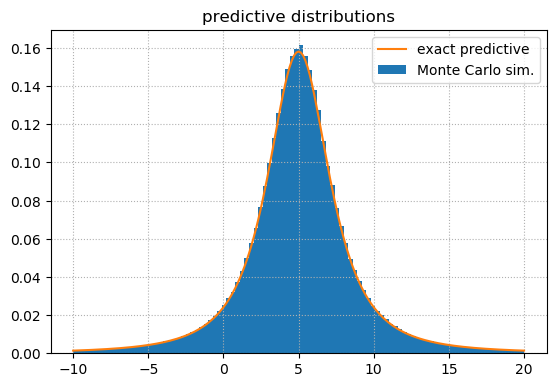

In [5]:
##### NormalGamma prior

@everywhere struct NormalGamma{S<:Real} <: ContinuousMultivariateDistribution
    μ₀::S
    λ₀::S
    α::S
    θ::S
end

@everywhere begin
    import Distributions: logpdf, maximum, minimum
    import Distributions: _logpdf, length, insupport
    import Distributions: pdf, rand, _rand!
    
    function pdf(d::NormalGamma{S}, x::AbstractArray{S,1}) where S<:Real
        μ₀ = d.μ₀
        λ₀ = d.λ₀
        α = d.α
        θ = d.θ
        μ = x[1]
        λ = x[2]
        sqrt(λ₀/(2π)) / (gamma(α) * θ^α) * 
        λ^(α-1/2) * exp( -(1/2)*λ*(λ₀*(μ - μ₀)^2 + 2/θ) )
    end
    
    function _logpdf(d::NormalGamma{S}, x::AbstractArray{S,1}) where S<:Real
        μ₀ = d.μ₀
        λ₀ = d.λ₀
        α = d.α
        θ = d.θ
        μ = x[1]
        λ = x[2]
        (1/2)*(log(λ₀) - log(2π)) - (lgamma(α) + α*log(θ)) + 
        (α-1/2)log(λ) - (1/2)*λ*(λ₀*(μ-μ₀)^2 + 2/θ) 
    end

    length(d::NormalGamma) = 2
    
    insupport(d::NormalGamma{S}, x::AbstractArray{S,1}) where S<:Real = (x[2] > zero(S))
    
    function _rand!(d::NormalGamma{S}, x::AbstractArray{S,1}) where S<:Real
        x[2] = rand(Gamma(d.α, d.θ))
        x[1] = rand(Normal(d.μ₀, 1/sqrt(x[2]*d.λ₀)))
        return x
    end
    
    function _rand!(d::NormalGamma{S}, x::AbstractArray{S,2}) where S<:Real
        for i in 1:size(x,2)
            x[:,i] = rand(d)
        end
        return x
    end
end

##### predictive distribution for NormalGamma prior d

@everywhere begin
    ##### LocationScaled t-distribution
    GTDist(μ::S, ρ::S, ν::S) where S<:Real = LocationScale(μ, ρ, TDist(ν))
    GTDist(μ, ρ, ν) = GTDist(Float64(μ), Float64(ρ), Float64(ν))

    function PredNormal(μ₀, λ₀, α, θ)
        ρ = sqrt((λ₀+1)/(α*θ*λ₀))
        GTDist(μ₀, ρ, 2α)
    end
    
    ##### predictive distribution for NormalGamma prior d
    PredNormal(d::NormalGamma) = PredNormal(d.μ₀, d.λ₀, d.α, d.θ)
end

##### Partition and log-partition functions

function Z(d::NormalGamma{S}) where S<:Real
    μ₀ = d.μ₀
    λ₀ = d.λ₀
    α = d.α
    θ = d.θ
    1/( sqrt(λ₀/(2π)) / (gamma(α) * θ^α) )
end

function logZ(d::NormalGamma{S}) where S<:Real
    μ₀ = d.μ₀
    λ₀ = d.λ₀
    α = d.α
    θ = d.θ
    -( (1/2)*(log(λ₀) - log(2π)) - (lgamma(α) + α*log(θ)) )
end
    
################## Tests

println("--------- Test of the normal-Gamma conjugate priors of normal distributions\n")

μ₀ = 5.0
σ₀ = 2.0
μ_λ = 1.0
σ_λ = 1.0

λ₀ = 1/σ₀^2
αθ  = μ_λ
αθ² = σ_λ^2
α  = (αθ)^2/αθ²
θ  = αθ/α

@show d = NormalGamma(μ₀, λ₀, α, θ) # prior
@show pdf(d, [0.0, 1.0])
@show logpdf(d, [0.0, 1.0]), log(pdf(d, [0.0,1.0]))
@show logZ(d), log(Z(d))
@show length(d)
@show insupport(d, [0.0, -1.0])
@show rand(d,5)
@show pd = PredNormal(d) # predictive of the prior d
@show logpdf(pd, 1.0)

println("\n--------- Comparison between the Monte Carlo and the exact estimates of the predictive distribution")
sleep(0.1)
L = 10^6
w = rand(d, L)
X = rand.(Normal.(w[1,:], 1 ./sqrt.(w[2,:])))
xmin, xmax = -10, 20
x = linspace(xmin, xmax, 201)
plt.figure(figsize=(6.4, 4.2))
plt.plt[:hist](X, normed=true, bins=100, range=(xmin,xmax), label="Monte Carlo sim.") # Monte Carlo estimate
plt.plot(x, pdf.(pd, x), label="exact predictive") # exact estimate
plt.grid(ls=":")
plt.legend()
plt.title("predictive distributions");

## ベイズ更新

In [6]:
########## Baysian update of NormalGamma prior d w.r.t sample X and inverse temperature β

function BayesianUpdate(d::NormalGamma{S}, X::AbstractArray{S,1}, β::S) where S<:Real
    μ₀ = d.μ₀
    λ₀ = d.λ₀
    α = d.α
    θ = d.θ
    n = length(X)
    βn = β*n
    meanX = mean(X)
    varX = var(X, corrected=false)
    μ₀_updated = (λ₀*μ₀ + βn*meanX)/(λ₀ + βn)
    λ₀_updated = λ₀ + βn
    α_updated  = α + βn/2
    θ_updated  = θ/(1 + (θ/2)*((βn*λ₀)/(λ₀+βn)*(meanX - μ₀)^2 + βn*varX))
    return NormalGamma(μ₀_updated, λ₀_updated, α_updated, θ_updated)
end

BayesianUpdate(d, X) = BayesianUpdate(d, X, one(eltype(d)))

#################### Test

println("----------- associativity and commutativity of Bayesian update\n")

@show dist_true = Normal(-5.0, 2.0)
X1 = rand(dist_true, 100)
X2 = rand(dist_true, 200)
X = vcat(X1,X2)
β = 3.0
prior = NormalGamma(0.0, 1/100^2, 1.0, 1.0)
posterior1 = BayesianUpdate(prior, X1, β)
posterior2 = BayesianUpdate(prior, X2, β)
posterior12 = BayesianUpdate(posterior1, X2, β)
posterior21 = BayesianUpdate(posterior2, X1, β)
posterior = BayesianUpdate(prior, X, β);
predictive = PredNormal(posterior)

@show size(X1,1), mean(X1), std(X1)
@show size(X2,1), mean(X2), std(X2)
@show size(X,1), mean(X), std(X)
@show β
@show prior
@show posterior1
@show posterior2
@show posterior12
@show posterior21
@show posterior
@show predictive;

----------- associativity and commutativity of Bayesian update

dist_true = Normal(-5.0, 2.0) = Normal{Float64}(μ=-5.0, σ=2.0)
(size(X1, 1), mean(X1), std(X1)) = (100, -5.294934196465278, 2.1191085424936476)
(size(X2, 1), mean(X2), std(X2)) = (200, -4.897859360989917, 2.0312964795988195)
(size(X, 1), mean(X), std(X)) = (300, -5.030217639481703, 2.0659604818209845)
β = 3.0
prior = NormalGamma{Float64}(μ₀=0.0, λ₀=0.0001, α=1.0, θ=1.0)
posterior1 = NormalGamma{Float64}(μ₀=-5.294932431487802, λ₀=300.0001, α=151.0, θ=0.0014973228858237314)
posterior2 = NormalGamma{Float64}(μ₀=-4.897858544680159, λ₀=600.0001, α=301.0, θ=0.0008112526796810992)
posterior12 = NormalGamma{Float64}(μ₀=-5.030217080568695, λ₀=900.0001, α=451.0, θ=0.0005221153176939089)
posterior21 = NormalGamma{Float64}(μ₀=-5.030217080568694, λ₀=900.0001, α=451.0, θ=0.0005221153176939089)
posterior = NormalGamma{Float64}(μ₀=-5.030217080568694, λ₀=900.0001, α=451.0, θ=0.0005221153176939088)
predictive = LocationScale{Float64,TDist{F

## WBICとWAIC

公式の計算の正しさに絶対的な自信がないので, モンテカルロシミュレーションで計算した結果と数値的に比較することにする.

In [7]:
########## WBIC and partition and log-partition functions for posteriors

# Exact calculation of partition function
#
function Z(prior::NormalGamma{S}, X::AbstractArray{S,1}, β::S) where S<:Real
    βn = β*size(X,1)
    posterior = BayesianUpdate(prior, X, β)
    Z(posterior)/((2π)^(βn/2) * Z(prior))
end

Z(prior::NormalGamma{S}, X::AbstractArray{S,1}) where S<:Real = Z(prior, X, one(S))

# Monte Carlo simulation w.r.t. prior distribution (β=∞)
#
function Z_mc(prior, X, β; L = 10^5)
    w = rand(prior, L)
    f(w) = prod(pdf.(Normal(w[1],1/sqrt(w[2])), X))^β
    return mean(f(w[:,l]) for l in 1:L)
end

# Exact calculation of log-partition function
#
function logZ(prior::NormalGamma{S}, X::AbstractArray{S,1}, β::S) where S<:Real
    βn = β*size(X,1)
    posterior = BayesianUpdate(prior, X, β)
    return logZ(posterior) - (βn/2)*log(2π) - logZ(prior)
end

function logZ(prior::NormalGamma{S}, X::AbstractArray{S,1}) where S<:Real
    return logZ(prior, X, one(S))
end

function BayesianFreeEnergy(prior::NormalGamma{S}, X::AbstractArray{S,1}, β::S) where S<:Real
    return -2/β*logZ(prior, X, β)
end

function BayesianFreeEnergy(prior::NormalGamma{S}, X::AbstractArray{S,1}) where S<:Real
    return BayesianFreeEnergy(prior, X, one(S))
end

# Monte Carlo simulation w.r.t. prior distribution (β=∞)
#
function logZ_mc(prior, X, β; L = 10^5)
    w = rand(prior, L)
    logf(w) = β*sum(logpdf.(Normal(w[1],1/sqrt(w[2])), X))
    loglik = [logf(@view w[:,l]) for l in 1:L]
    maxloglik = maximum(loglik)
    return maxloglik .+ log(mean(exp.(loglik .- maxloglik)))
end

logZ_mc(prior::NormalGamma{S}, X::AbstractArray{S,1}; L=10^5) where S<:Real = logZ_mc(prior, X, one(S), L=L)

# Exact formula of the posterior mean of logpdf
#
function ElogpdfNormal(d::NormalGamma, x)
    μ₀ = d.μ₀
    λ₀ = d.λ₀
    α = d.α
    θ = d.θ
    θ ≤ zero(θ) && return typemax(θ)
    return -(1/2)*(
        log(2π) + α*θ*(x - μ₀)^2 + 1/λ₀ - (digamma(α) + log(θ))
    )
end

# Exact formula of the posterior mean of logpdf^2
#
function ElogpdfNormal2(d::NormalGamma, x)
    μ₀ = d.μ₀
    λ₀ = d.λ₀
    α = d.α
    θ = d.θ
    θ ≤ zero(θ) && return typemax(θ)
    return (1/4)*(
          log(2π)^2
        + (α+1)*α*θ^2*(x - μ₀)^4 + 6α*θ/λ₀*(x - μ₀)^2 + 3/λ₀^2
        + trigamma(α) + (digamma(α) + log(θ))^2
        + 2*log(2π)*( α*θ*(x - μ₀)^2 + 1/λ₀ )
        - 2*log(2π)*( digamma(α) + log(θ) )
        - 2*( (x - μ₀)^2*(θ + α*θ*(digamma(α) + log(θ))) + 1/λ₀*(digamma(α) + log(θ)) )
    )
end

# Exact formula of the β-posterior mean of nL_n(w)
#
function EnLn(prior, X, β)
    posterior = BayesianUpdate(prior, X, β)
    return -sum(ElogpdfNormal(posterior, x) for x in X)
end

# Exact formula of WBIC
#
WBIC(prior, X, β) = 2*EnLn(prior, X, β/log(length(X)))
WBIC(prior, X) = WBIC(prior, X, 1.0)

# Estimate of real log canonical threshold by WBIC
#
function RealLogCanonicalThreshold_WBIC(prior, X; n = length(X), β₁ = 1/log(n), β₂ = 2/log(n))
    return (EnLn(prior, X, β₁) - EnLn(prior, X, β₂))/(1/β₁ - 1/β₂)
end

# improved WBIC
#
# See pages 363--364 of
# http://onlinelibrary.wiley.com/doi/10.1111/rssb.12187/full
#
function improved_WBIC(prior, X, β; n = length(X), β₁ = 1/log(n), β₂ = 2/log(n))
    posterior = BayesianUpdate(prior, X, β)
    λ_star = RealLogCanonicalThreshold_WBIC(prior, X, β₁=β₁, β₂=β₂)
    WBIC₀ = WBIC(prior,X,β)
    WAIC₀ = WAIC(prior,X,β)
    V = 2*FunctionalVariance(posterior, X)
    β_star = (β/log(n))*(β*(WBIC₀ - WAIC₀ - (1-β)*V)/(2*λ_star*log(n)) - 1/log(n))
    β_star = max(0.0, β_star)
    return 2*EnLn(prior, X, β_star)
end

function improved_WBIC(prior, X; n = length(X), β₁ = 1/log(n), β₂ = 2/log(n))
    return improved_WBIC(prior, X, 1.0, β₁=β₁, β₂=β₂)
end

########### Estimation by Monte Carlo method

# Monte Carlo simulation
#
function ElogpdfNormal_mc(d::NormalGamma, x; L = 10^5)
    w = rand(d, L)
    return mean(logpdf(Normal(w[1,l], 1/sqrt(w[2,l])), x) for l in 1:L)
end

# Monte Carlo simulation
#
function ElogpdfNormal2_mc(d::NormalGamma, x; L = 10^5)
    w = rand(d, L)
    return mean(logpdf(Normal(w[1,l], 1/sqrt(w[2,l])), x)^2 for l in 1:L)
end

# Monte Carlo simulation at the inverse tenperature β
#
function EnLn_mc(prior, X, β; L = 10^5)
    posterior = BayesianUpdate(prior, X, β)
    predictive = PredNormal(posterior)
    w = rand(posterior, L)
    f(w) = sum(logpdf.(Normal(w[1], 1/sqrt(w[2])), X))
    return -mean(f(@view w[:,l]) for l in 1:L)
end

# Monte Carlo simulation at the inverse tenperature β
#
WBIC_mc(prior, X, β; L = 10^5) = 2*EnLn_mc(prior, X, β/log(length(X)), L=L)
WBIC_mc(prior, X; L = 10^5) = 2*EnLn_mc(prior, X, 1.0/log(length(X)), L=L)

########## WAIC, LOOCV, and generalization loss

TrainingLoss(dist_pred, X) = -sum(logpdf.(dist_pred, X))

function GeneralizationLoss(dist_true, dist_pred; xmin = -100.0, xmax = 100.0)
    f(x) = -pdf(dist_true, x) * logpdf(dist_pred, x)
    return quadgk(f, xmin, xmax)[1]
end

function ShannonInformation(dist_true; xmin = -100.0, xmax = 100.0)
    return GeneralizationLoss(dist_true, dist_true, xmin = xmin, xmax = xmax)
end

function KullbackLeibler(dist_true, dist_pred; xmin = -100.0, xmax = 100.0)
    return (
        GeneralizationLoss(dist_true, dist_pred, xmin = xmin, xmax = xmax)
        - ShannonInformation(dist_true, xmin = xmin, xmax = xmax)
    )
end

# Exact formula
#
function FunctionalVariance(posterior::NormalGamma, X)
    return sum(ElogpdfNormal2(posterior, x) - ElogpdfNormal(posterior, x)^2 for x in X)
end

# Exact formula of WAIC
#
function WAIC(prior, X, β)
    posterior = BayesianUpdate(prior, X, β)
    predictive = PredNormal(posterior)
    return 2*(
          TrainingLoss(predictive, X) 
        + β*FunctionalVariance(posterior, X)
    )
end

WAIC(prior, X) = WAIC(prior, X, 1.0)

# Exact formula of LOOCV
#
function LOOCV(prior, X, β)
    posterior = BayesianUpdate(prior, X, β)
    return -2*sum(
        logZ(posterior, [x], 1-β) - logZ(posterior, [x], -β)
    for x in X)
end

LOOCV(prior, X) = LOOCV(prior, X, 1.0)

# Monte Carlo simulation w.r.t. posterior
#
function FunctionalVariance_mc(posterior::NormalGamma, X; L = 10^5)
    w = rand(posterior, L)
    return sum(var(logpdf(Normal(w[1,l], 1/sqrt(w[2,l])), x) for l in 1:L) for x in X)
end

######### Estimation by Monte Carlo method

# Monte Carlo simulation w.r.t. posterior
#
function WAIC_mc(prior, X, β; L = 10^5)
    posterior = BayesianUpdate(prior, X, β)
    predictive = PredNormal(posterior)
    return 2*( TrainingLoss(predictive, X) + β*FunctionalVariance_mc(posterior, X))
end

# Monte Carlo simulation w.r.t. posterior
#
function VlogpdfNormal_mc(d::NormalGamma, x; L = 10^5)
    w = rand(d,L)
    return (
          mean(logpdf(Normal(w[1,l], 1/sqrt(w[2,l])), x)^2 for l in 1:L)
        - mean(logpdf(Normal(w[1,l], 1/sqrt(w[2,l])), x) for l in 1:L)^2
    )
end

#################### Tests

println("----------- sample and estimates\n")

dist_true = Normal(-5.0, 2.0)
n = 2^10
X = rand(dist_true, n)
β = 1.0
prior = NormalGamma(0.0, 1/100^2, 1.0, 1.0)
posterior = BayesianUpdate(prior, X, β)
predictive = PredNormal(posterior)
T_true = 2*TrainingLoss(dist_true, X)
T_pred = 2*TrainingLoss(predictive, X)

@show dist_true
@show n
@show mean(X), std(X)
@show β
@show prior
@show posterior
@show predictive

println("----------- Bayesian free energy and WBIC\n")

BFE_Zexact = -2/β*log(Z(prior, X, β)) 
@time BFE_Zmcsim = -2/β*log(Z_mc(prior, X, β))
BFE_Lexact = BayesianFreeEnergy(prior, X, β)
@time BFE_Lmcsim = -2/β*logZ_mc(prior, X, β)
WBIC_exact = WBIC(prior, X, β)
@time WBIC_mcsim = WBIC_mc(prior, X, β)
iWBIC = improved_WBIC(prior, X, β)

@show T_true
@show T_pred
@show BFE_Zexact
@show BFE_Zmcsim
@show BFE_Lexact
@show BFE_Lmcsim
@show WBIC_exact
@show WBIC_mcsim
@show iWBIC

println("\n----------- Generalization Loss and WAIC\n")

T_true = 2*TrainingLoss(dist_true, X)
@time GL = 2n*GeneralizationLoss(dist_true, predictive)
@time KL = 2n*KullbackLeibler(dist_true, predictive)

T_pred = 2*TrainingLoss(predictive, X)
V_exact = 2β*FunctionalVariance(posterior, X)
@time V_mcsim  = 2β*FunctionalVariance_mc(posterior, X, L=10^5)
#@time V_mcsim2 = 2β*sum(VlogpdfNormal_mc(posterior, x, L=10^5) for x in X)
WAIC_exact = WAIC(prior, X, β)
@time WAIC_mcsim = WAIC_mc(prior, X, β, L=10^5)
WAT = WAIC_exact - T_true
LOOCV_exact = LOOCV(prior, X, β)
LCT = LOOCV_exact - T_true
RLCT_WBIC = RealLogCanonicalThreshold_WBIC(prior, X)

println()

@show dist_true
@show n
@show mean(X), std(X)
@show β
@show prior
@show posterior
@show predictive

@show T_true
@show T_pred
@show V_exact
@show V_mcsim
#@show V_mcsim2

println()

@show GL
@show WAIC_exact
@show WAIC_mcsim
@show LOOCV_exact

println()

@show KL
@show WAT
@show LCT

println()

@show λ = 2/2
@show ν = 2/2
@show β^(-1)*4λ + (1-β^(-1))*4ν
@show KL + WAT
@show KL + LCT
@show RLCT_WBIC
;

----------- sample and estimates

dist_true = Normal{Float64}(μ=-5.0, σ=2.0)
n = 1024
(mean(X), std(X)) = (-4.998901943353326, 1.9414558582113957)
β = 1.0
prior = NormalGamma{Float64}(μ₀=0.0, λ₀=0.0001, α=1.0, θ=1.0)
posterior = NormalGamma{Float64}(μ₀=-4.9989014551793565, λ₀=1024.0001, α=513.0, θ=0.000518410558084628)
predictive = LocationScale{Float64,TDist{Float64}}(
μ: -4.9989014551793565
σ: 1.9400653218838189
ρ: TDist{Float64}(ν=1026.0)
)

----------- Bayesian free energy and WBIC

  2.177522 seconds (1.15 M allocations: 854.849 MiB, 6.32% gc time)
  1.656718 seconds (910.58 k allocations: 841.267 MiB, 6.92% gc time)
  1.513047 seconds (800.49 k allocations: 833.155 MiB, 7.60% gc time)
T_true = 4265.537755186198
T_pred = 4263.785750559946
BFE_Zexact = NaN
BFE_Zmcsim = Inf
BFE_Lexact = 4287.433350691626
BFE_Lmcsim = 4296.241340454925
WBIC_exact = 4277.542383428432
WBIC_mcsim = 4277.528588284662
iWBIC = 4287.8468923983355

----------- Generalization Loss and WAIC

  1.103724 seconds

## AICとBIC

In [8]:
function AIC_Normal(X)
    predictive = fit(Normal, X)
    return -2*sum(logpdf.(predictive, X)) + 4
end

function BIC_Normal(X)
    predictive = fit(Normal, X)
    return -2*sum(logpdf.(predictive, X)) + 2*log(length(X))
end

function AIC_Normal_mean(X; σ = 1.0)
    μ = mean(X)
    predictive = Normal(μ, σ)
    return -2*sum(logpdf.(predictive, X)) + 2
end

function BIC_Normal_mean(X; σ = 1.0)
    μ = mean(X)
    predictive = Normal(μ, σ)
    return -2*sum(logpdf.(predictive, X)) + log(length(X))
end

function AIC_Normal_sigma(X; μ = 0.0)
    σ = std(X, corrected=false, mean=μ)
    predictive = Normal(μ, σ)
    return -2*sum(logpdf.(predictive, X)) + 2
end

function BIC_Normal_sigma(X; μ = 0.0)
    σ = std(X, corrected=false, mean=μ)
    predictive = Normal(μ, σ)
    return -2*sum(logpdf.(predictive, X)) + log(length(X))
end

#################### Test

@show dist_true = Normal(1.0,2.0)
@show n = 2^10
X = rand(dist_true, n)
@show mean(X), std(X)

println()

@show prior = NormalGamma(0.0, 1.0, 1.0, 1.0/1.0)
@show WAIC(prior, X)
@show WBIC(prior, X)
@show AIC_Normal(X)
@show BIC_Normal(X)

println()

@show prior_Normal_mean = NormalGamma(0.0, 1.0, 1e10, 1.0/1e10)
@show WAIC(prior_Normal_mean, X)
@show WBIC(prior_Normal_mean, X)
@show AIC_Normal_mean(X, σ=1.0)
@show BIC_Normal_mean(X, σ=1.0)

println()

@show prior_Normal_sigma = NormalGamma(0.0, 1e10, 1.0, 1.0/1.0)
@show WAIC(prior_Normal_sigma, X)
@show WBIC(prior_Normal_sigma, X)
@show AIC_Normal_sigma(X, μ=0.0)
@show BIC_Normal_sigma(X, μ=0.0)
;

dist_true = Normal(1.0, 2.0) = Normal{Float64}(μ=1.0, σ=2.0)
n = 2 ^ 10 = 1024
(mean(X), std(X)) = (1.036419697383084, 1.9862593137009414)

prior = NormalGamma(0.0, 1.0, 1.0, 1.0 / 1.0) = NormalGamma{Float64}(μ₀=0.0, λ₀=1.0, α=1.0, θ=1.0)
WAIC(prior, X) = 4314.475531728022
WBIC(prior, X) = 4324.2182010759925
AIC_Normal(X) = 4314.432033436681
BIC_Normal(X) = 4324.29497704788

prior_Normal_mean = NormalGamma(0.0, 1.0, 1.0e10, 1.0 / 1.0e10) = NormalGamma{Float64}(μ₀=0.0, λ₀=1.0, α=1.0e10, θ=1.0e-10)
WAIC(prior_Normal_mean, X) = 5922.893849231179
WBIC(prior_Normal_mean, X) = 5924.886902756906
AIC_Normal_mean(X, σ=1.0) = 5919.95237667597
BIC_Normal_mean(X, σ=1.0) = 5924.88384848157

prior_Normal_sigma = NormalGamma(0.0, 1.0e10, 1.0, 1.0 / 1.0) = NormalGamma{Float64}(μ₀=0.0, λ₀=1.0e10, α=1.0, θ=1.0)
WAIC(prior_Normal_sigma, X) = 4559.290952368117
WBIC(prior_Normal_sigma, X) = 4564.141512551385
AIC_Normal_sigma(X, μ=0.0) = 4559.228009135628
BIC_Normal_sigma(X, μ=0.0) = 4564.159480941227


## 事前分布, 事後分布, WAIC, WBICのプロット

  6.137965 seconds (14.47 M allocations: 716.822 MiB, 6.43% gc time)
  0.190885 seconds (71.78 k allocations: 14.590 MiB, 3.09% gc time)


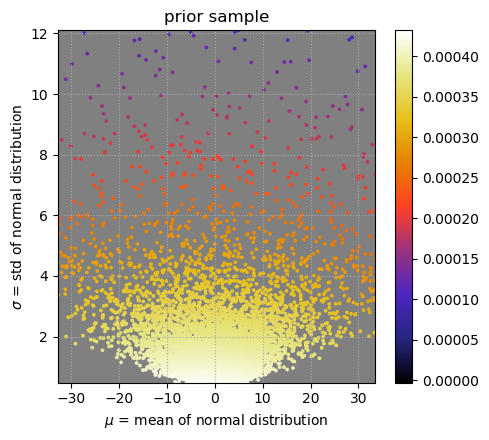

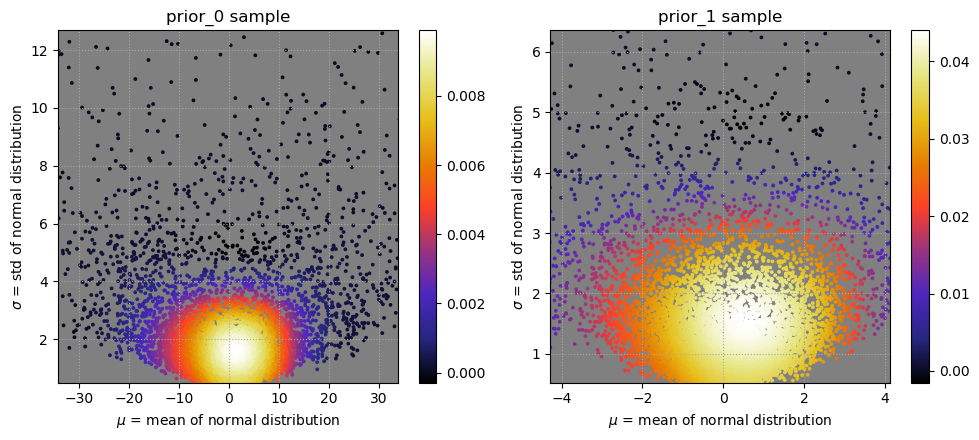

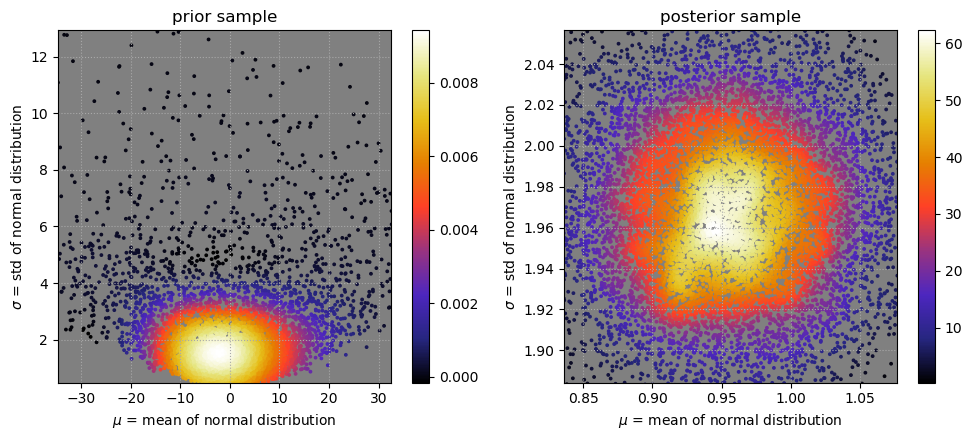

  0.203839 seconds (72.10 k allocations: 14.605 MiB, 2.79% gc time)


In [9]:
function plotPosteriorSample(d::NormalGamma; L = 10^4, epsilon = 0.025, titlestr = "Sample")
    w = rand(d, L)
    μ = (@view w[1,:])
    σ = 1 ./sqrt.(w[2,:])
    xmin = quantile(μ, epsilon)
    xmax = quantile(μ, 1-epsilon)
    ymin = quantile(σ, epsilon)
    ymax = quantile(σ, 1-epsilon)
    f = makefunc_pdfkde(μ, σ)
    c = f.(μ, σ)
    plt.scatter(μ, σ, c=c, s=3, cmap="CMRmap")
    plt.colorbar()
    plt.xlim(xmin, xmax)
    plt.ylim(ymin, ymax)
    plt.xlabel("\$\\mu\$ = mean of normal distribution")
    plt.ylabel("\$\\sigma\$ = std of normal distribution")
    plt.grid(ls=":", color="darkgray")
    #plt.legend()
    plt.title(titlestr)
end

function plotP(prior; L = 10^4, epsilon=0.025, titlestr="prior sample")
    plt.figure(figsize=(5,4.5))
    fig1 = plt.subplot(111)
    fig1[:set_facecolor]("gray")
    plotPosteriorSample(prior, L=L, titlestr=titlestr, epsilon=epsilon)
    plt.tight_layout()    
end

function plotP01(prior0, prior1; L = 10^4, epsilon=0.025, titlestr0="prior_0 sample", titlestr1="prior_1 sample")
    plt.figure(figsize=(10,4.5))
    fig1 = plt.subplot(121)
    fig1[:set_facecolor]("gray")
    plotPosteriorSample(prior0, L=L, titlestr=titlestr0, epsilon=epsilon)
    fig2 = plt.subplot(122)
    fig2[:set_facecolor]("gray")
    plotPosteriorSample(prior1, L=L, titlestr=titlestr1, epsilon=epsilon)
    plt.tight_layout()    
end

function plotPP(prior, X, β; L = 10^4, epsilon=0.025)
    posterior = BayesianUpdate(prior, X, β)
    plt.figure(figsize=(10,4.5))
    fig1 = plt.subplot(121)
    fig1[:set_facecolor]("gray")
    plotPosteriorSample(prior, L=L, titlestr="prior sample", epsilon=epsilon)
    fig2 = plt.subplot(122)
    fig2[:set_facecolor]("gray")
    plotPosteriorSample(posterior, L=L, titlestr="posterior sample", epsilon=epsilon)
    plt.tight_layout()    
end

dist_true = Normal(1.0, 2.0)
n = 2^10
prior = NormalGamma(0.0, 1/5^2, 0.7, 1.0/0.7)
prior0 = prior
μ₀, αθ = 0.0, 1.0
λ₀, α = 1.0, 1.0
prior1 = NormalGamma(μ₀, λ₀, α, αθ/α)
β = 1.0
X = rand(dist_true, n)
@time plotP(prior)
@time plotP01(prior0, prior1)
@time plotPP(prior, X, β)

  0.108084 seconds (10.86 k allocations: 5.958 MiB, 5.31% gc time)
dist_true = Normal{Float64}(μ=1.0, σ=2.0)
n = 1024
prior = NormalGamma{Float64}(μ₀=0.0, λ₀=1.0, α=1.0, θ=1.0)
β = 1.0
Nsims = 1000
cor(KLs, WAICs - Ttrues) = -0.9977025919576317
cor(KLs, AICs - Ttrues) = -0.9984453784285122
(mean((WAICs - Ttrues) + KLs), std((WAICs - Ttrues) + KLs)) = (3.9964969725611654, 0.13354986190122695)
(mean((LOOCVs - Ttrues) + KLs), std((LOOCVs - Ttrues) + KLs)) = (3.9965673265917174, 0.13355947830695242)
(mean((AICs - Ttrues) + KLs), std((AICs - Ttrues) + KLs)) = (3.9961525178927366, 0.10955962120787158)
(mean((WAICs - Ttrues) - KLs), std((WAICs - Ttrues) - KLs)) = (0.005032485752385582, 3.931798919898944)
(mean((LOOCVs - Ttrues) - KLs), std((LOOCVs - Ttrues) - KLs)) = (0.005102839782937735, 3.9317997579862207)
(mean((AICs - Ttrues) - KLs), std((WAICs - Ttrues) - KLs)) = (0.004688031083956957, 3.931798919898944)
(mean(LOOCVs - WAICs), std(LOOCVs - WAICs)) = (7.035403055215283e-5, 2.033665145603

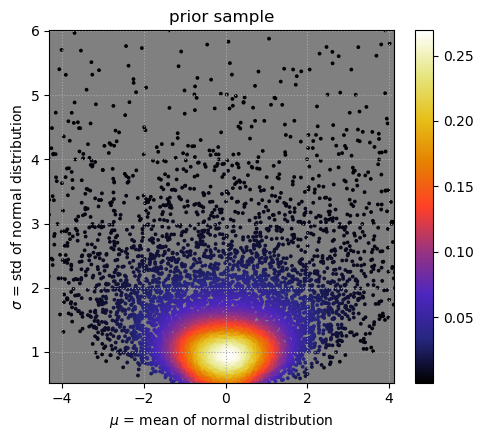

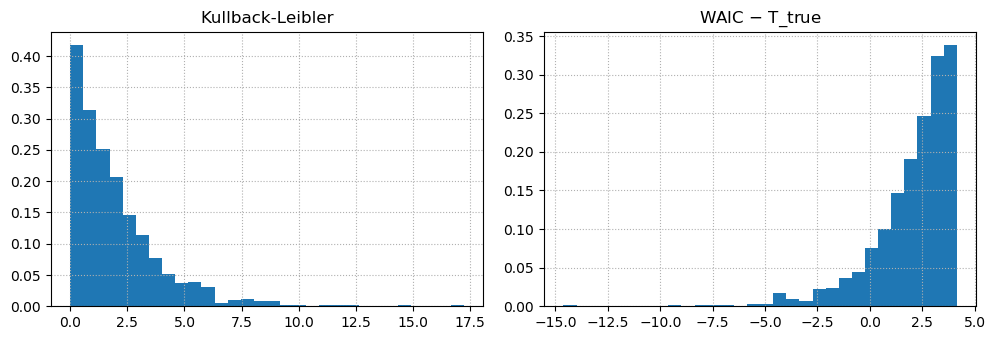

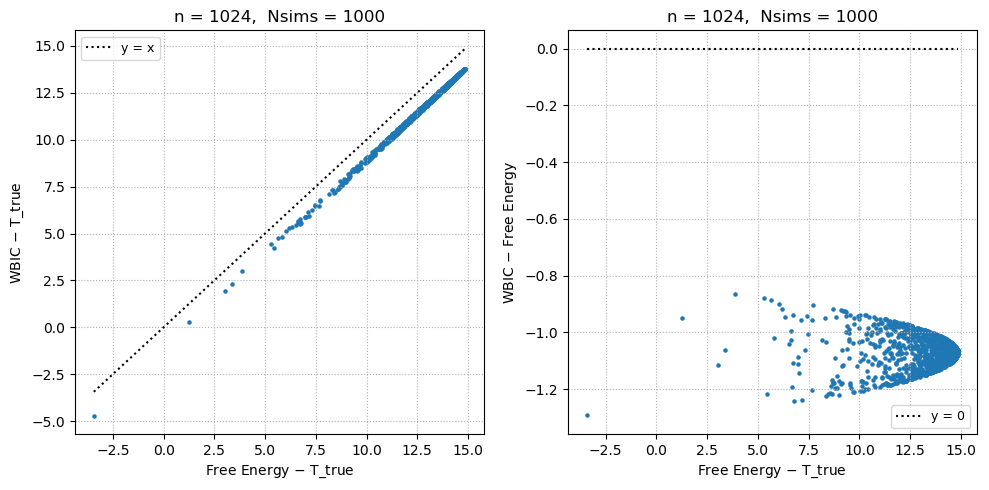

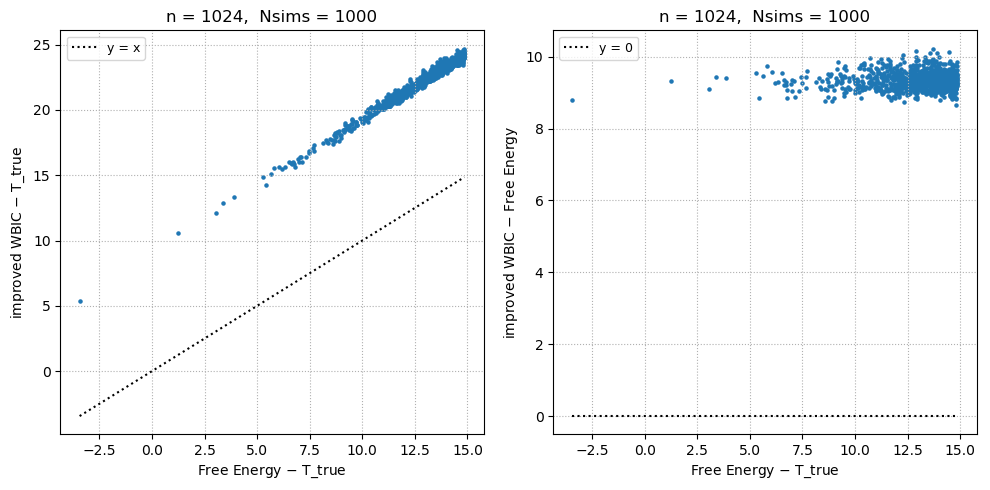

  3.890864 seconds (7.37 M allocations: 496.293 MiB, 2.92% gc time)


In [10]:
function runsim(dist_true, n, prior, β; Nsims=10^4)
    X = Array{Float64, 1}(undef, n)
    Samples = Array{Array{Float64, 1}, 1}(undef, Nsims)
    Ttrues  = Array{Float64, 1}(undef, Nsims)
    GLs     = Array{Float64, 1}(undef, Nsims)
    KLs     = Array{Float64, 1}(undef, Nsims)
    WAICs   = Array{Float64, 1}(undef, Nsims)
    LOOCVs  = Array{Float64, 1}(undef, Nsims)
    WATs    = Array{Float64, 1}(undef, Nsims)
    BFEs    = Array{Float64, 1}(undef, Nsims)
    WBICs   = Array{Float64, 1}(undef, Nsims)
    iWBICs  = Array{Float64, 1}(undef, Nsims)
    AICs    = Array{Float64, 1}(undef, Nsims)
    BICs    = Array{Float64, 1}(undef, Nsims)
    for k in 1:Nsims
        X = rand(dist_true, n)
        posterior  = BayesianUpdate(prior, X, β)
        predictive = PredNormal(posterior)
        Samples[k] = X
        Ttrues[k]  = 2*TrainingLoss(dist_true, X)
        GLs[k]     = 2*GeneralizationLoss(dist_true, predictive)
        KLs[k]     = 2n*KullbackLeibler(dist_true, predictive)
        WAICs[k]   = WAIC(prior, X, β)
        LOOCVs[k]  = LOOCV(prior, X, β)
        WATs[k]    = WAICs[k] - Ttrues[k]
        BFEs[k]    = -2*logZ(prior, X, β)
        WBICs[k]   = WBIC(prior, X, β)
        iWBICs[k]  = improved_WBIC(prior, X, β)
        AICs[k]    = AIC_Normal(X)
        BICs[k]    = BIC_Normal(X)
    end
    return Samples, Ttrues, 
    GLs, KLs, WAICs, WATs, LOOCVs,
    BFEs, WBICs, iWBICs,
    AICs, BICs
end

function plotsim(dist_true, n, prior, β; Nsims=10^3)
    global Samples, Ttrues, 
    GLs, KLs, WAICs, WATs, LOOCVs, 
    BFEs, WBICs, iWBICs,
    AICs, BICs

    Samples, Ttrues, 
    GLs, KLs, WAICs, WATs, LOOCVs, 
    BFEs, WBICs, iWBICs,
    AICs, BICs = runsim(dist_true, n, prior, β, Nsims=Nsims)

    @show dist_true
    @show n
    @show prior
    @show β
    @show Nsims
    @show cor(KLs, WAICs - Ttrues)
    @show cor(KLs, AICs - Ttrues)
    @show mean(WAICs-Ttrues+KLs), std(WAICs-Ttrues+KLs)
    @show mean(LOOCVs-Ttrues+KLs), std(LOOCVs-Ttrues+KLs)
    @show mean(AICs-Ttrues+KLs), std(AICs-Ttrues+KLs)
    @show mean(WAICs-Ttrues-KLs), std(WAICs-Ttrues-KLs)
    @show mean(LOOCVs-Ttrues-KLs), std(LOOCVs-Ttrues-KLs)
    @show mean(AICs-Ttrues-KLs), std(WAICs-Ttrues-KLs)
    @show mean(LOOCVs-WAICs), std(LOOCVs-WAICs)
    @show mean(AICs-WAICs), std(LOOCVs-WAICs)
    @show mean(WAICs-Ttrues), std(WAICs-Ttrues)
    @show mean(LOOCVs-Ttrues), std(LOOCVs-Ttrues)
    @show mean(AICs-Ttrues), std(WAICs-Ttrues)
    @show mean(WBICs - BFEs), std(WBICs - BFEs)
    @show mean(iWBICs - BFEs), std(iWBICs - BFEs)
    @show mean(BICs - BFEs), std(BICs - BFEs)
    @show mean(BICs - WBICs), std(BICs - WBICs)
    @show mean(iWBICs - WBICs), std(iWBICs - WBICs)
    
    sleep(0.1)

    plt.figure(figsize=(10,3.5))
    plt.subplot(121)
    plt.plt[:hist](KLs, normed=true, bins=30)
    plt.grid(ls=":")
    plt.title("Kullback-Leibler")
    plt.subplot(122)
    plt.plt[:hist](WATs, normed=true, bins=30)
    plt.grid(ls=":")
    plt.title("WAIC \$-\$ T_true")
    plt.tight_layout()
    
    plt.figure(figsize=(10,5))
    plt.subplot(121)
    plt.scatter(BFEs - Ttrues, WBICs - Ttrues, s=5)
    x = [minimum(BFEs - Ttrues), maximum(BFEs - Ttrues)]
    plt.plot(x, x, color="k", ls=":", label="y = x")
    plt.grid(ls=":")
    plt.xlabel("Free Energy \$-\$ T_true")
    plt.ylabel("WBIC \$-\$ T_true")
    plt.legend(fontsize=9)
    plt.title("n = $n,  Nsims = $Nsims")
    plt.subplot(122)
    plt.scatter(BFEs - Ttrues, WBICs - BFEs, s=5)
    x = [minimum(BFEs - Ttrues), maximum(BFEs - Ttrues)]
    plt.plot(x, zero(x), color="k", ls=":", label="y = 0")
    plt.grid(ls=":")
    plt.xlabel("Free Energy \$-\$ T_true")
    plt.ylabel("WBIC \$-\$ Free Energy")
    plt.legend(fontsize=9)
    plt.title("n = $n,  Nsims = $Nsims")
    plt.tight_layout()

    plt.figure(figsize=(10,5))
    plt.subplot(121)
    plt.scatter(BFEs - Ttrues, iWBICs - Ttrues, s=5)
    x = [minimum(BFEs - Ttrues), maximum(BFEs - Ttrues)]
    plt.plot(x, x, color="k", ls=":", label="y = x")
    plt.grid(ls=":")
    plt.xlabel("Free Energy \$-\$ T_true")
    plt.ylabel("improved WBIC \$-\$ T_true")
    plt.legend(fontsize=9)
    plt.title("n = $n,  Nsims = $Nsims")
    plt.subplot(122)
    plt.scatter(BFEs - Ttrues, iWBICs - BFEs, s=5)
    x = [minimum(BFEs - Ttrues), maximum(BFEs - Ttrues)]
    plt.plot(x, zero(x), color="k", ls=":", label="y = 0")
    plt.grid(ls=":")
    plt.xlabel("Free Energy \$-\$ T_true")
    plt.ylabel("improved WBIC \$-\$ Free Energy")
    plt.legend(fontsize=9)
    plt.title("n = $n,  Nsims = $Nsims")
    plt.tight_layout()
end

##################### Test

dist_true = Normal(1.0, 2.0)
n = 2^10
μ₀, αθ = 0.0, 1.0
λ₀, α = 1.0, 1.0
prior = NormalGamma(μ₀, λ₀, α, αθ/α)
β = 1.0
X = rand(dist_true, n)

@time plotP(prior)
@time plotsim(dist_true, n, prior, β, Nsims=10^3)

(BFE_quadgk, error) = quadgk(f, 0, 1) = (3043.2290596628595, 1.3554960522910164e-6)

BFE_exact = 3043.229059662859
BFE_quadgk = 3043.2290596628595
BFE_mcsim = 4063.368764174213
WBIC_exact = 3061.1103644872514
WBIC_mcsim = 3061.308691567042
iWBIC = 3183.831887655828
  3.305525 seconds (1.93 M allocations: 1.645 GiB, 5.98% gc time)
dist_true = Normal{Float64}(μ=10.0, σ=1.0)
n = 1024
prior = NormalGamma{Float64}(μ₀=0.0, λ₀=1.0, α=1.0, θ=1.0)
β = 1.0
Nsims = 1000
cor(KLs, WAICs - Ttrues) = -0.4699994423003958
cor(KLs, AICs - Ttrues) = -0.2995269416576046
(mean((WAICs - Ttrues) + KLs), std((WAICs - Ttrues) + KLs)) = (12.143281036153464, 3.435634294292832)
(mean((LOOCVs - Ttrues) + KLs), std((LOOCVs - Ttrues) + KLs)) = (12.143331835454948, 3.4356355402563197)
(mean((AICs - Ttrues) + KLs), std((AICs - Ttrues) + KLs)) = (7.976525770476255, 3.8046424107293406)
(mean((WAICs - Ttrues) - KLs), std((WAICs - Ttrues) - KLs)) = (-0.010187711767520341, 5.123036102513734)
(mean((LOOCVs - Ttrues) - KLs),

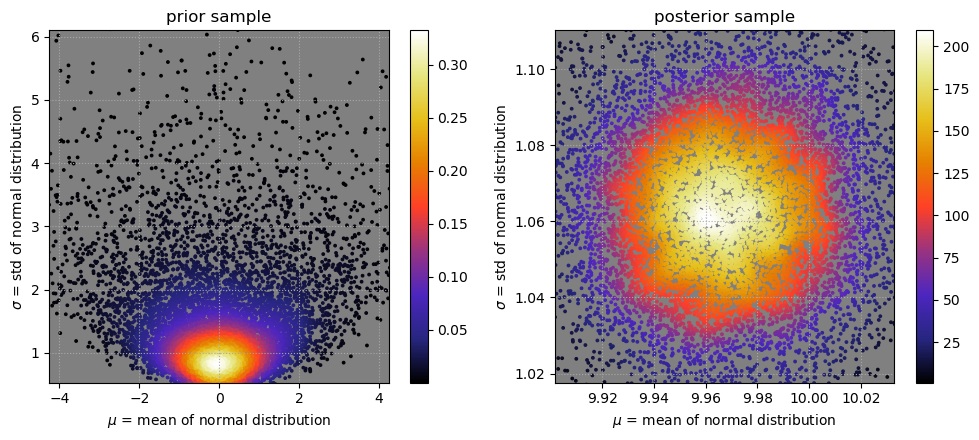

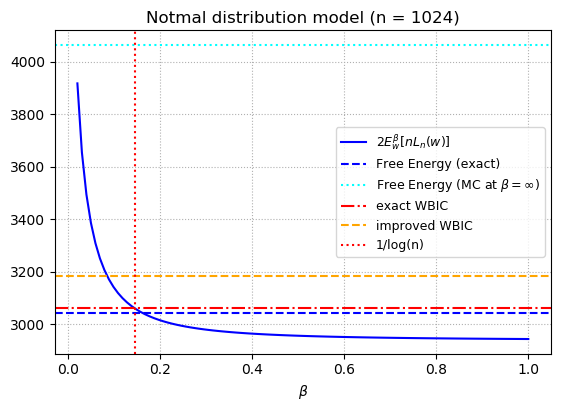

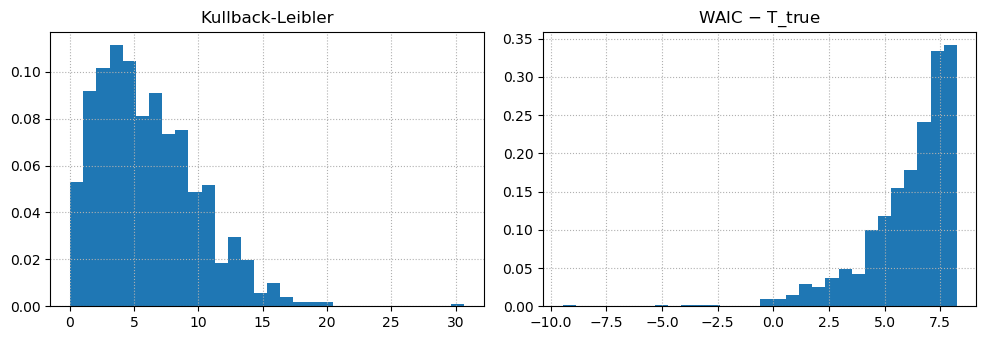

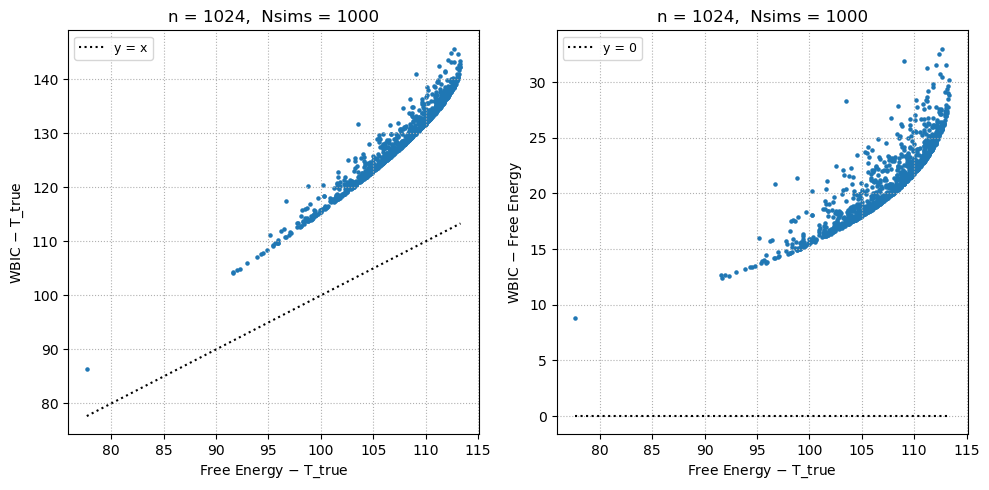

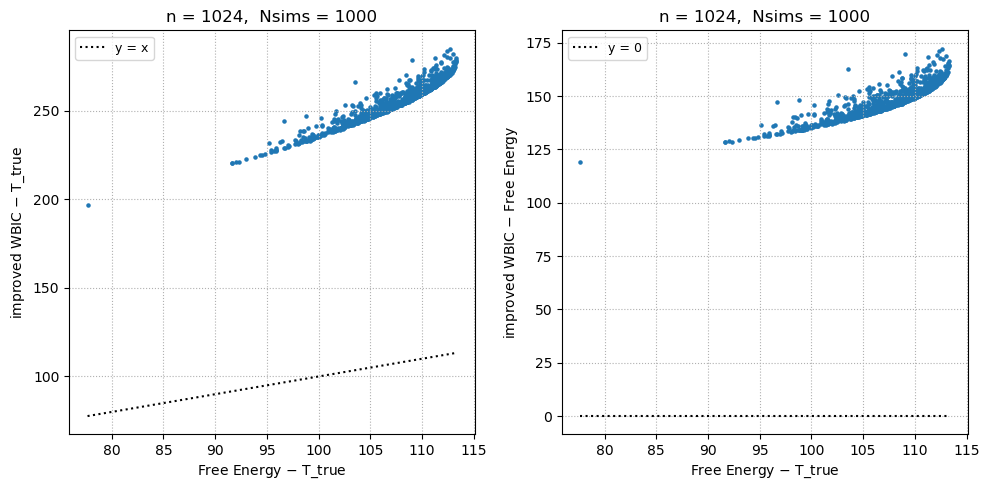

  2.439531 seconds (2.96 M allocations: 255.656 MiB, 1.54% gc time)


In [11]:
function plotWBIC(prior, X)
    n = length(X)
    BFE_exact = -2*logZ(prior, X)
    BFE_mcsim = -2*logZ_mc(prior, X)
    WBIC_exact = WBIC(prior, X)
    WBIC_mcsim = WBIC_mc(prior, X)
    iWBIC = improved_WBIC(prior, X)

    f(β) = 2*EnLn(prior, X, β)
    @show BFE_quadgk, error = quadgk(f, 0, 1)
    
    println()

    @show BFE_exact
    @show BFE_quadgk
    @show BFE_mcsim
    @show WBIC_exact
    @show WBIC_mcsim
    @show iWBIC

    sleep(0.1)
    β = linspace(0.02,1,101)
    plt.figure(figsize=(6.4, 4.2))
    plt.plot(β, f.(β), color="blue", label="\$2E^\\beta_w[nL_n(w)]\$")
    plt.axhline(BFE_exact, color="blue", ls="--", label="Free Energy (exact)")
    plt.axhline(BFE_mcsim, color="cyan", ls=":", label="Free Energy (MC at \$\\beta=\\infty\$)")
    plt.axhline(WBIC_exact, color="red", ls="-.", label="exact WBIC")
    #plt.axhline(WBIC_mcsim, color="magenta", ls="-.", label="MC WBIC")
    plt.axhline(iWBIC, color="orange", ls="--", label="improved WBIC")
    plt.axvline(1/log(n), color="red", ls=":", label="1/log(n)")
    plt.grid(ls=":")
    plt.xlabel("\$\\beta\$")
    plt.title("Notmal distribution model (n = $n)")
    plt.legend(fontsize=9)
end

#################### Test

dist_true = Normal(10.0, 1.0)
n = 2^10
μ₀, αθ = 0.0, 1.0
λ₀, α = 1.0, 1.0
prior = NormalGamma(μ₀, λ₀, α, αθ/α)
β = 1.0
X = rand(dist_true, n)
plotPP(prior, X, β)
@time plotWBIC(prior, X)
@time plotsim(dist_true, n, prior, β)

## ベイズ自由エネルギーの積分による近似計算

  0.175728 seconds (21.66 k allocations: 11.914 MiB, 3.05% gc time)
β₀ = 0.0
BFE_exact = 2976.0795525982976
BFE_mcsim0 = 4250.844252946306
BFE_mcsim = 4169.651806969536
WBIC_exact = 2999.248491988196
iWBIC = 3128.4879080928945
  6.924673 seconds (3.17 M allocations: 3.155 GiB, 6.40% gc time)
dist_true = Normal{Float64}(μ=10.0, σ=1.0)
n = 1024
prior = NormalGamma{Float64}(μ₀=0.0, λ₀=1.0, α=1.0, θ=1.0)
β = 1.0
Nsims = 1000
cor(KLs, WAICs - Ttrues) = -0.5602514045047353
cor(KLs, AICs - Ttrues) = -0.4070771332366787
(mean((WAICs - Ttrues) + KLs), std((WAICs - Ttrues) + KLs)) = (12.310999990084326, 3.2929801972114707)
(mean((LOOCVs - Ttrues) + KLs), std((LOOCVs - Ttrues) + KLs)) = (12.311051098981299, 3.2929813625070117)
(mean((AICs - Ttrues) + KLs), std((AICs - Ttrues) + KLs)) = (8.161112606541334, 3.644213986786943)
(mean((WAICs - Ttrues) - KLs), std((WAICs - Ttrues) - KLs)) = (0.1456936452099335, 5.361579272081265)
(mean((LOOCVs - Ttrues) - KLs), std((LOOCVs - Ttrues) - KLs)) = (0.145744

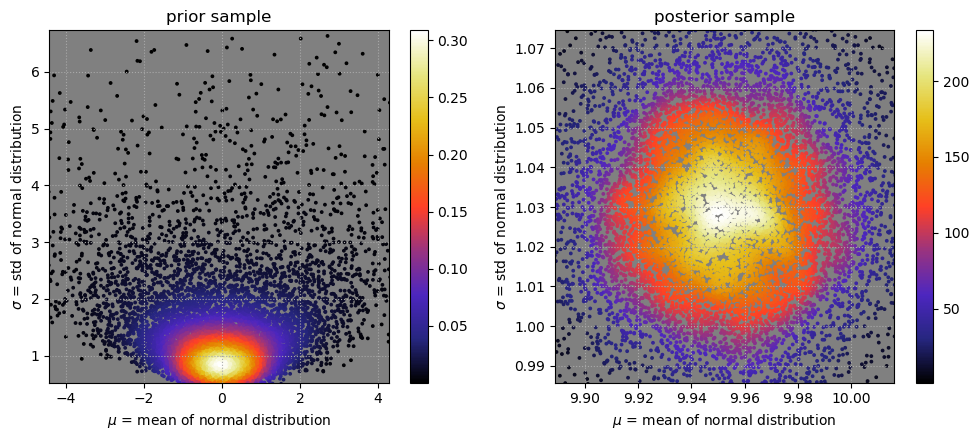

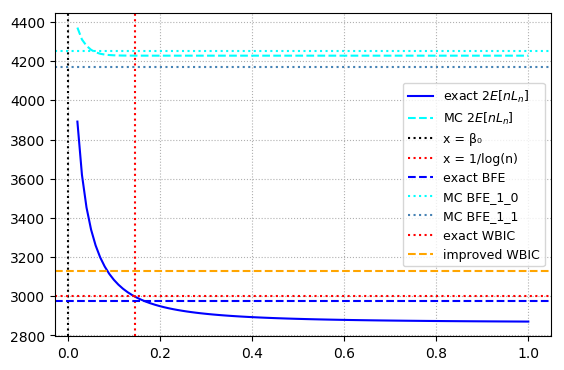

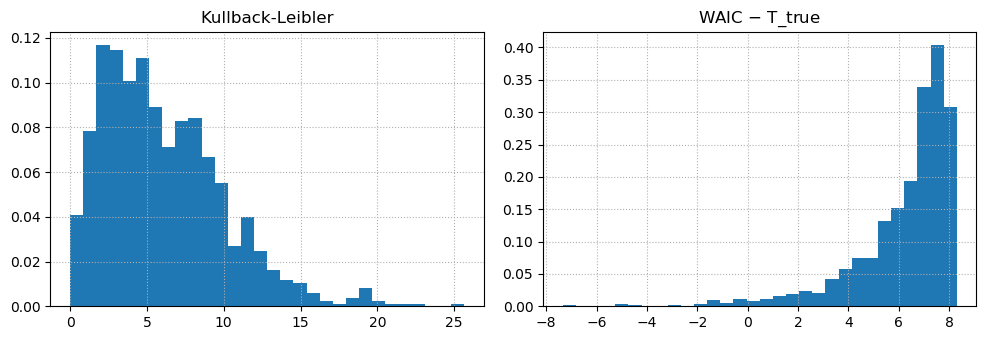

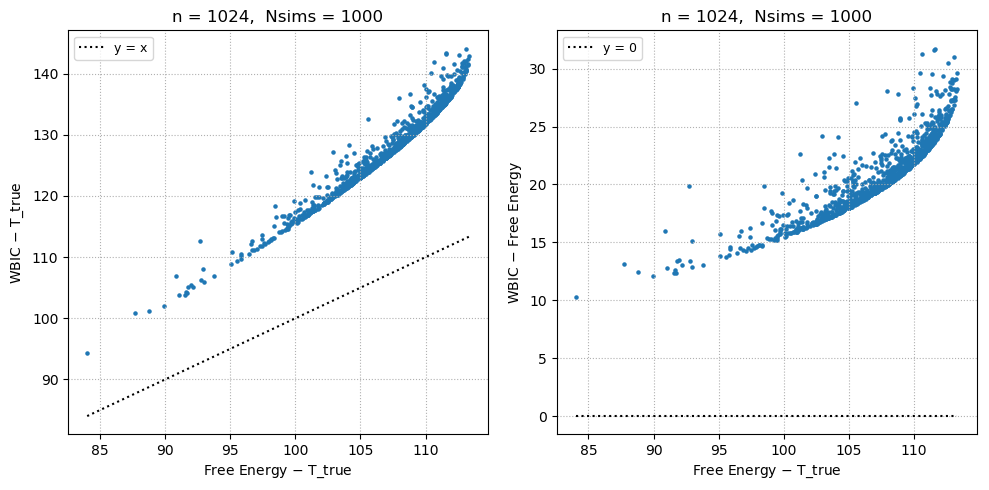

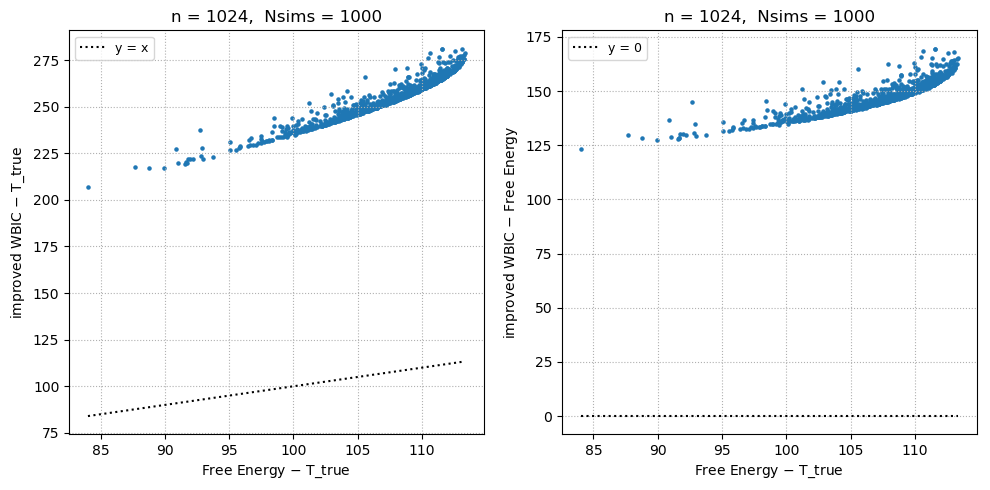

  2.044813 seconds (2.96 M allocations: 255.420 MiB, 1.36% gc time)


In [12]:
function makefunc_EnLn_mc(prior, X, β₀; L = 10^5)
    posterior = BayesianUpdate(prior, X, β₀)
    w = rand(posterior, L)
    loglik = Array{Float64,1}(undef, L)
    for l in 1:L
        loglik[l] = sum(logpdf.(Normal(w[1,l], 1/sqrt(w[2,l])), X))
    end
    normalized_loglik = loglik .- maximum(loglik)
    function E(β)
        numerator   = -mean(loglik .* exp.((β-β₀).*normalized_loglik))
        denominator = mean(exp.((β-β₀).*normalized_loglik))
        return numerator/denominator
    end
    return E
end

function BaysianFreeEnergy_mc(prior, X, β; β₀ = 1/log(length(X)), L = 10^5)
    E = makefunc_EnLn_mc(prior, X, β₀, L = L)
    return 2/β*quadgk(E, 0.0, β)[1]
end

function BaysianFreeEnergy_mc_localint(prior, X, β; β₀ = 1/log(length(X)), L = 10^5, a = 0.5)
    E = makefunc_EnLn_mc(prior, X, β₀, L = L)
    return 2/(β₀/a-β₀*a)*quadgk(E, β₀*a, min(β₀/a, β))[1]
end

function plotBFE(X, β, β₀, prior; a = 0.5)
    n = length(X)
    BFE_exact = BayesianFreeEnergy(prior, X, β)
    WBIC_exact = WBIC(prior, X)
    iWBIC = improved_WBIC(prior, X)
    
    E = makefunc_EnLn_mc(prior, X, β₀)
    intE, error = quadgk(E, 0.0, 1.0)
    BFE_mcsim0 = 2/β*intE
    BFE_mcsim = BaysianFreeEnergy_mc(prior, X, β, β₀=β₀)
    
    #E_invlogn = makefunc_EnLn_mc(prior, X, 1/log(n))
    #localintE, error_localint = quadgk(E_invlogn, a/log(n), 1/a/log(n))
    #BFE_mcsim_localint0 = 2/(1/a/log(n) - a/log(n))*localintE
    #BFE_mcsim_localint = BaysianFreeEnergy_mc_localint(prior, X, β, a=a)

    @show β₀
    @show BFE_exact
    @show BFE_mcsim0
    @show BFE_mcsim
    #@show BFE_mcsim_localint0
    #@show BFE_mcsim_localint
    @show WBIC_exact
    #@show 2*E(1/log(n))
    @show iWBIC

    sleep(0.1)
    x = linspace(0.02, 1, 100)
    f(x) = 2*EnLn(prior, X, x)
    g(x) = 2*E(x)
    plt.figure(figsize=(6.4, 4.2))
    plt.plot(x, f.(x), label="exact \$2E[nL_n]\$", color="blue")
    plt.plot(x, g.(x), label="MC \$2E[nL_n]\$", color="cyan", ls="--")
    plt.axvline(β₀, label="x = β₀", color="black", ls=":")
    plt.axvline(1/log(n), label="x = 1/log(n)", color="red", ls=":")
    plt.axhline(BFE_exact, color="blue", ls="--", label="exact BFE")
    plt.axhline(BFE_mcsim0, color="cyan", ls=":", label="MC BFE_1_0")
    plt.axhline(BFE_mcsim, color="steelblue", ls=":", label="MC BFE_1_1")
    #plt.axhline(BFE_mcsim_localint0, color="orange", ls=":", label="MC BFE_2_0")
    #plt.axhline(BFE_mcsim_localint, color="gold", ls=":", label="MC BFE_2_1")
    plt.axhline(WBIC_exact, color="red", ls=":", label="exact WBIC")
    plt.axhline(iWBIC, color="orange", ls="--", label="improved WBIC")
    plt.grid(ls=":")
    plt.legend(fontsize=9)
end

#################### Test

#dist_true = Normal(5.0, 1.0)
dist_true = Normal(10.0, 1.0)
n = 2^10
X = rand(dist_true, n)

β = 1.0

μ₀, αθ = 0.0, 1.0
λ₀, α = 1.0, 1.0
prior = NormalGamma(μ₀, λ₀, α, αθ/α)

β₀ = 0.0

@time plotPP(prior, X, β)
@time plotBFE(X, β, β₀, prior)
@time plotsim(dist_true, n, prior, β)

  0.178470 seconds (21.66 k allocations: 11.914 MiB)
β₀ = 0.0
BFE_exact = 2900.39746270895
BFE_mcsim0 = 2900.147500841833
BFE_mcsim = 2900.553470909237
WBIC_exact = 2900.8001690507717
iWBIC = 2910.927323082959
  4.433772 seconds (404.43 k allocations: 2.483 GiB, 4.36% gc time)
dist_true = Normal{Float64}(μ=0.0, σ=1.0)
n = 1024
prior = NormalGamma{Float64}(μ₀=0.0, λ₀=1.0, α=1.0, θ=1.0)
β = 1.0
Nsims = 1000
cor(KLs, WAICs - Ttrues) = -0.9982117589378339
cor(KLs, AICs - Ttrues) = -0.9990232941157723
(mean((WAICs - Ttrues) + KLs), std((WAICs - Ttrues) + KLs)) = (3.9934818576607753, 0.11312770122589358)
(mean((LOOCVs - Ttrues) + KLs), std((LOOCVs - Ttrues) + KLs)) = (3.993553234180344, 0.11314050605768394)
(mean((AICs - Ttrues) + KLs), std((AICs - Ttrues) + KLs)) = (3.993909248155009, 0.08349254171079251)
(mean((WAICs - Ttrues) - KLs), std((WAICs - Ttrues) - KLs)) = (0.2898178221003532, 3.743116637924819)
(mean((LOOCVs - Ttrues) - KLs), std((LOOCVs - Ttrues) - KLs)) = (0.2898891986199219, 3

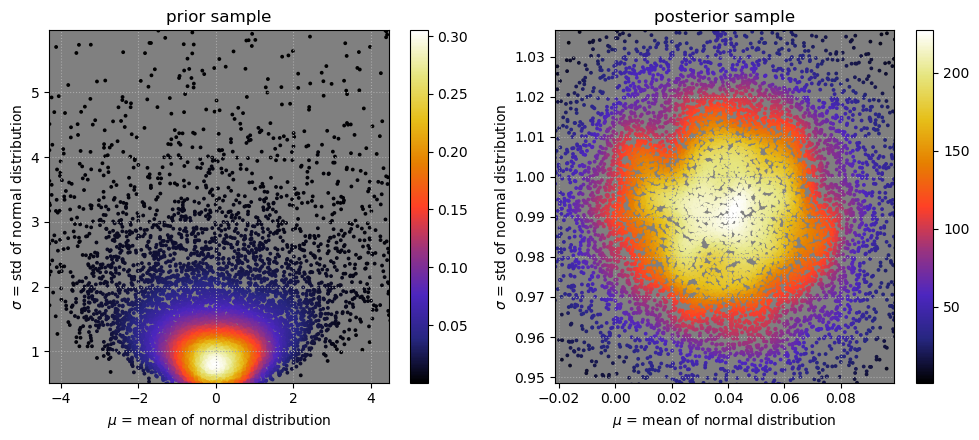

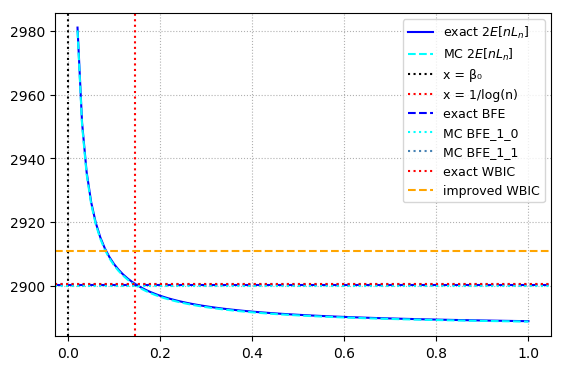

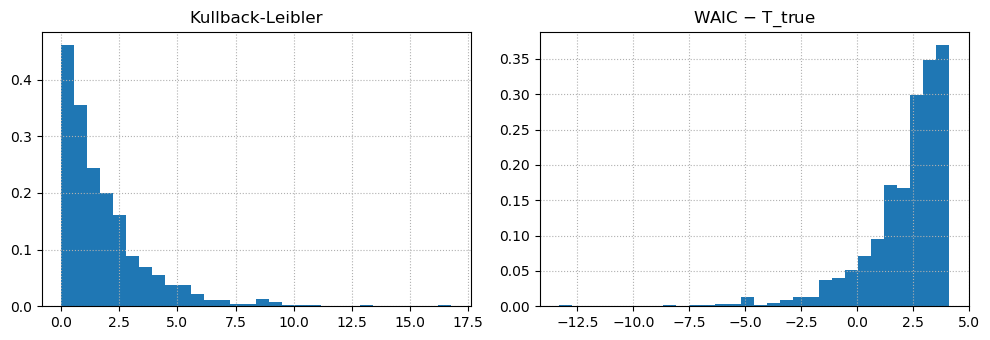

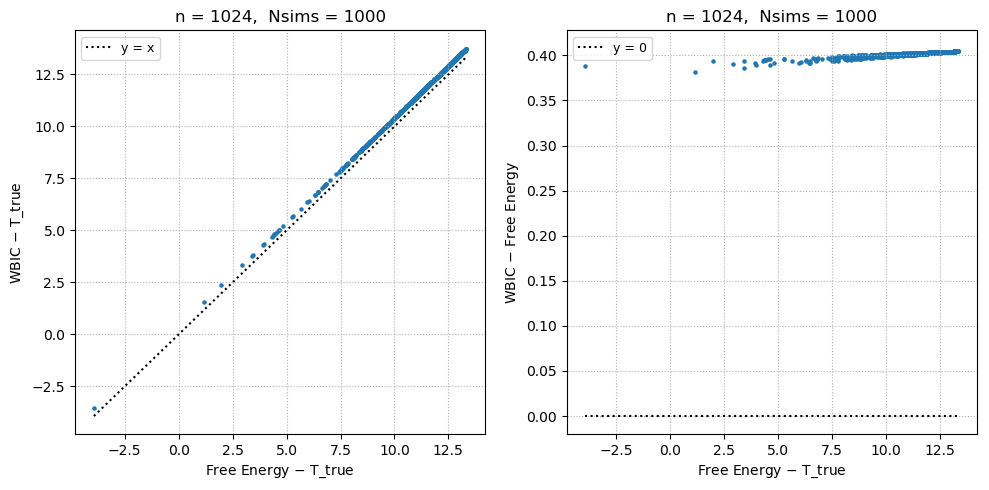

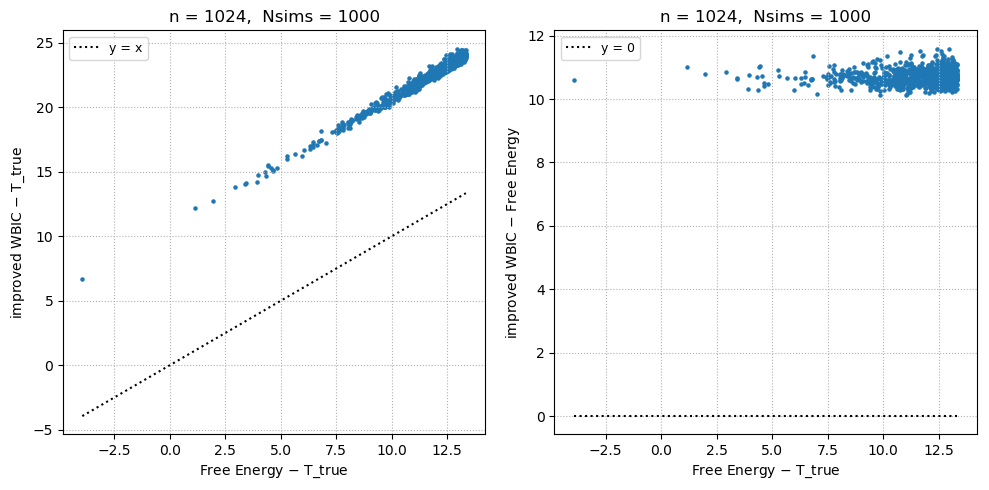

  2.020080 seconds (3.10 M allocations: 258.346 MiB, 1.35% gc time)


In [13]:
dist_true = Normal(0.0, 1.0)
n = 2^10
X = rand(dist_true, n)
β = 1.0

μ₀, αθ = 0.0, 1.0
λ₀, α = 1.0, 1.0
prior = NormalGamma(μ₀, λ₀, α, αθ/α)

β₀ = 0.0

@time plotPP(prior, X, β)
@time plotBFE(X, β, β₀, prior)
@time plotsim(dist_true, n, prior, β)

  0.185081 seconds (21.66 k allocations: 11.914 MiB)
β₀ = 0.0
BFE_exact = 7647.820379070768
BFE_mcsim0 = 7648.064119657185
BFE_mcsim = 7647.8234253420405
WBIC_exact = 7641.0749319820225
iWBIC = 7651.401724078271
  5.101636 seconds (406.02 k allocations: 2.974 GiB, 5.25% gc time)
dist_true = Normal{Float64}(μ=0.0, σ=10.0)
n = 1024
prior = NormalGamma{Float64}(μ₀=0.0, λ₀=1.0, α=1.0, θ=1.0)
β = 1.0
Nsims = 1000
cor(KLs, WAICs - Ttrues) = -0.9975121151969061
cor(KLs, AICs - Ttrues) = -0.998201746504837
(mean((WAICs - Ttrues) + KLs), std((WAICs - Ttrues) + KLs)) = (4.003734666063489, 0.14142467025372968)
(mean((LOOCVs - Ttrues) + KLs), std((LOOCVs - Ttrues) + KLs)) = (4.003806001331388, 0.1414340845951002)
(mean((AICs - Ttrues) + KLs), std((AICs - Ttrues) + KLs)) = (3.9973910682936693, 0.1202994183506269)
(mean((WAICs - Ttrues) - KLs), std((WAICs - Ttrues) - KLs)) = (0.02839118930213499, 4.004899719268787)
(mean((LOOCVs - Ttrues) - KLs), std((LOOCVs - Ttrues) - KLs)) = (0.028462524570033565

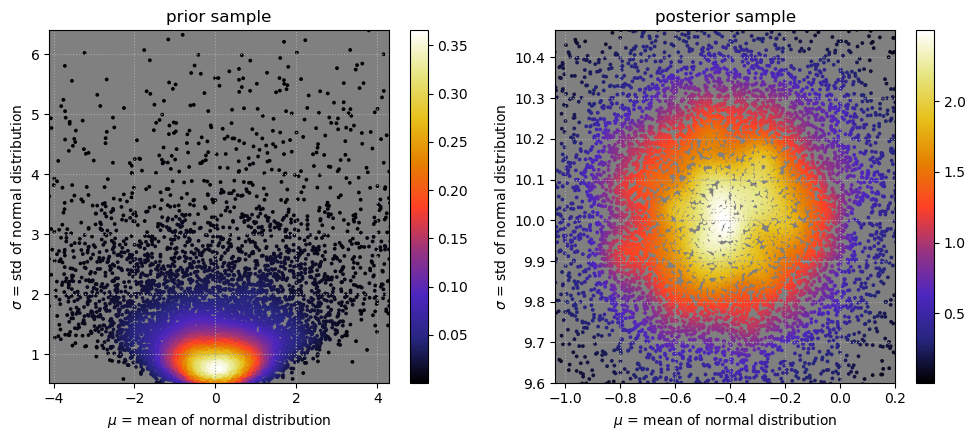

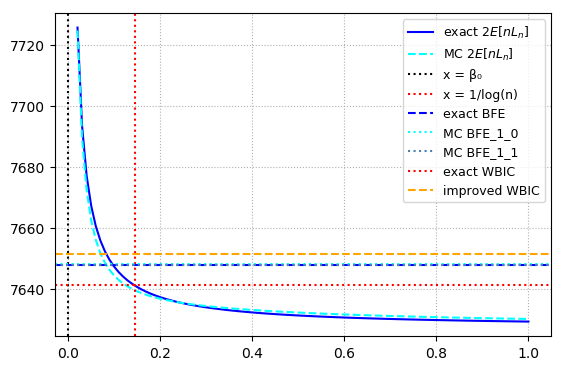

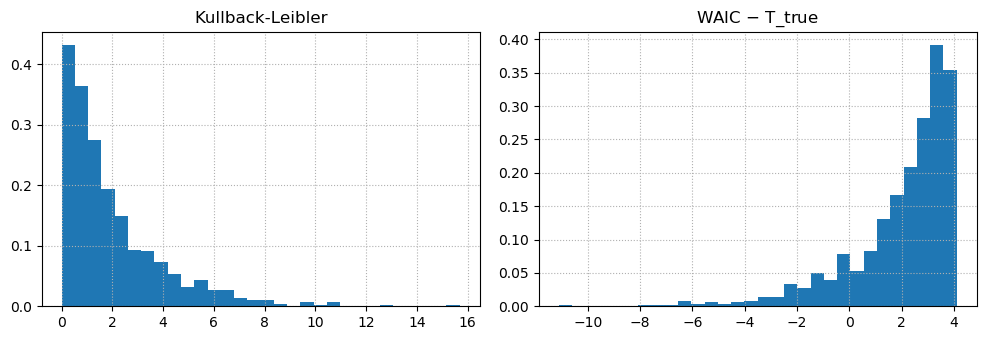

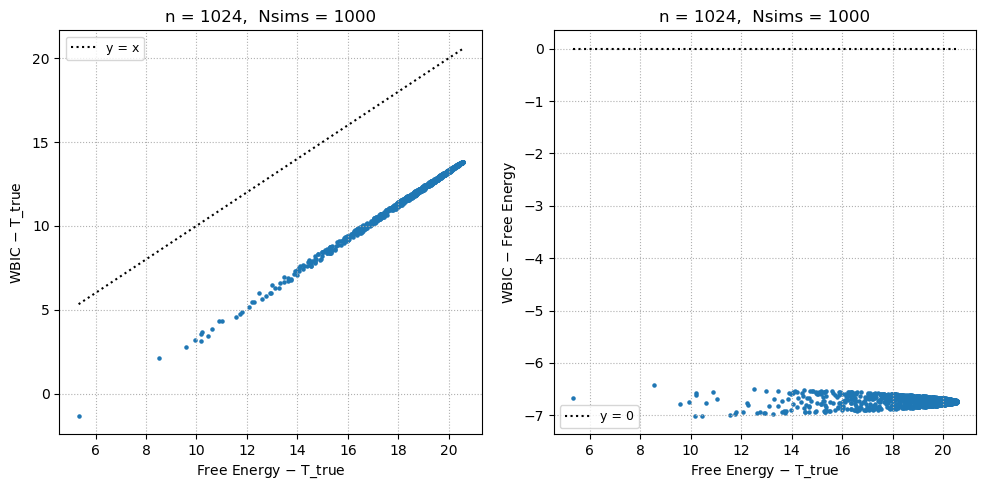

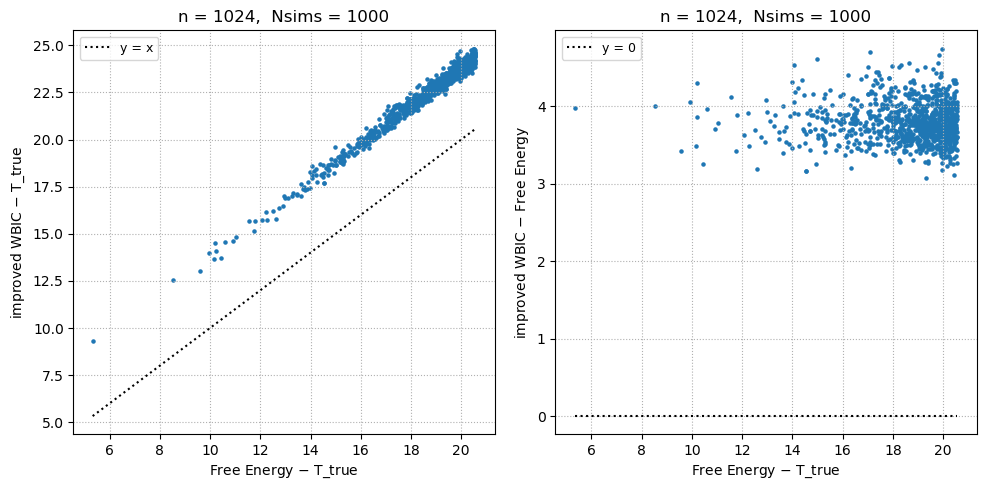

  1.972719 seconds (2.52 M allocations: 246.219 MiB, 1.16% gc time)


In [14]:
dist_true = Normal(0.0, 10.0)
n = 2^10
X = rand(dist_true, n)
β = 1.0

μ₀, αθ = 0.0, 1.0
λ₀, α = 1.0, 1.0
prior = NormalGamma(μ₀, λ₀, α, αθ/α)

β₀ = 0.0

@time plotPP(prior, X, β)
@time plotBFE(X, β, β₀, prior)
@time plotsim(dist_true, n, prior, β)

  0.192018 seconds (21.68 k allocations: 11.914 MiB, 1.37% gc time)
β₀ = 0.0
BFE_exact = 2986.2038794834098
BFE_mcsim0 = 4084.14492971008
BFE_mcsim = 4118.93934559355
WBIC_exact = 3008.655957951461
iWBIC = 3136.7612630838603
  5.604487 seconds (406.13 k allocations: 3.019 GiB, 4.54% gc time)
dist_true = Normal{Float64}(μ=10.0, σ=1.0)
n = 1024
prior = NormalGamma{Float64}(μ₀=0.0, λ₀=1.0, α=1.0, θ=1.0)
β = 1.0
Nsims = 1000
cor(KLs, WAICs - Ttrues) = -0.4954139077837324
cor(KLs, AICs - Ttrues) = -0.32526548722353593
(mean((WAICs - Ttrues) + KLs), std((WAICs - Ttrues) + KLs)) = (12.128825283609515, 3.430574131120747)
(mean((LOOCVs - Ttrues) + KLs), std((LOOCVs - Ttrues) + KLs)) = (12.128875449711876, 3.4305749964758196)
(mean((AICs - Ttrues) + KLs), std((AICs - Ttrues) + KLs)) = (7.963743756371206, 3.798610142634389)
(mean((WAICs - Ttrues) - KLs), std((WAICs - Ttrues) - KLs)) = (0.08670111983045353, 5.2068668252754735)
(mean((LOOCVs - Ttrues) - KLs), std((LOOCVs - Ttrues) - KLs)) = (0.0867

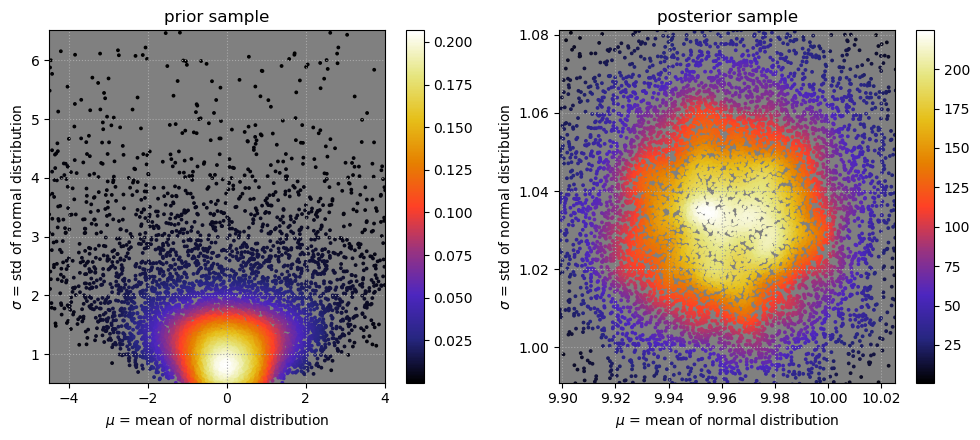

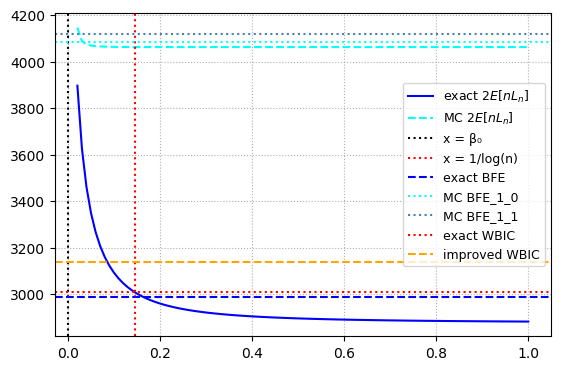

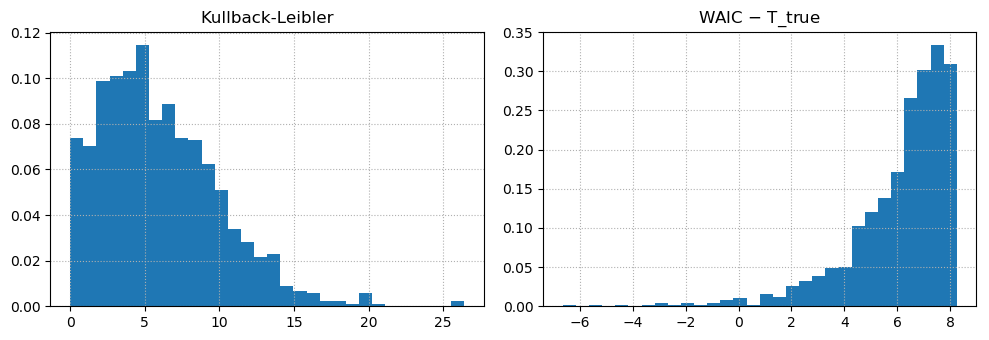

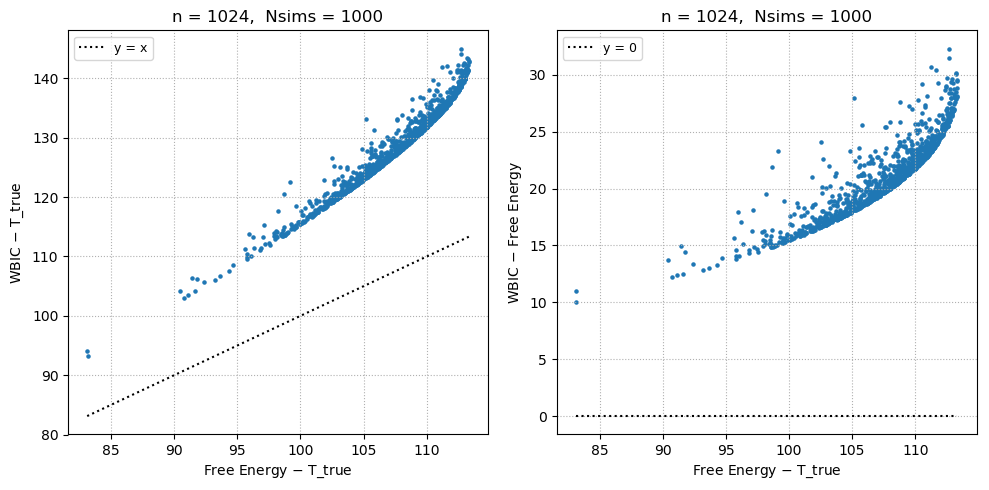

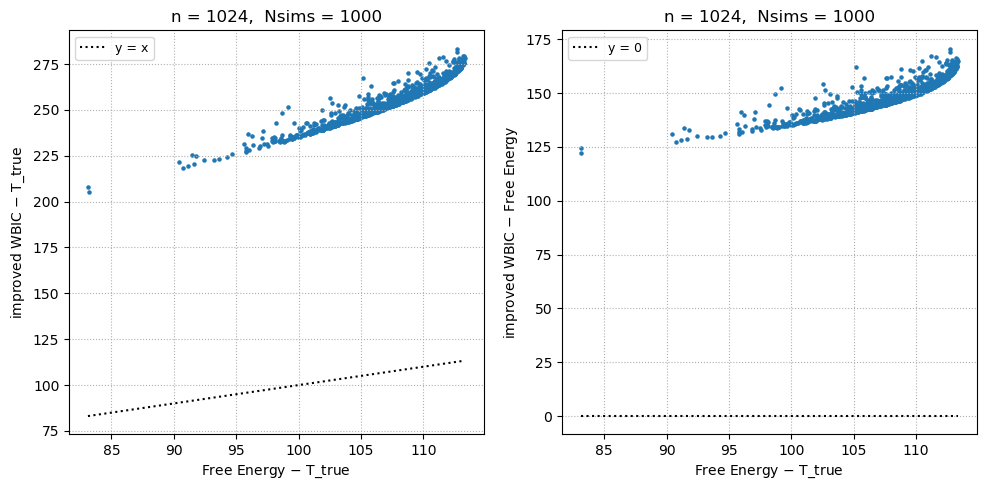

  2.374615 seconds (2.96 M allocations: 255.420 MiB, 6.05% gc time)


In [15]:
dist_true = Normal(10.0, 1.0)
n = 2^10
X = rand(dist_true, n)
β = 1.0

μ₀, αθ = 0.0, 1.0
λ₀, α = 1.0, 1.0
prior = NormalGamma(μ₀, λ₀, α, αθ/α)

β₀ = 0.0

@time plotPP(prior, X, β)
@time plotBFE(X, β, β₀, prior)
@time plotsim(dist_true, n, prior, β)

  0.179129 seconds (21.68 k allocations: 11.914 MiB, 1.61% gc time)
β₀ = 0.14426950408889633
BFE_exact = 3012.195061636303
BFE_mcsim0 = 2970.0936620652583
BFE_mcsim = 2967.0483506432424
WBIC_exact = 3032.7825084612987
iWBIC = 3159.4852439159004
  4.034826 seconds (403.32 k allocations: 2.125 GiB, 3.54% gc time)
dist_true = Normal{Float64}(μ=10.0, σ=1.0)
n = 1024
prior = NormalGamma{Float64}(μ₀=0.0, λ₀=1.0, α=1.0, θ=1.0)
β = 1.0
Nsims = 1000
cor(KLs, WAICs - Ttrues) = -0.5627034222758946
cor(KLs, AICs - Ttrues) = -0.4020392132920071
(mean((WAICs - Ttrues) + KLs), std((WAICs - Ttrues) + KLs)) = (12.193596907774284, 3.3367174434910236)
(mean((LOOCVs - Ttrues) + KLs), std((LOOCVs - Ttrues) + KLs)) = (12.19364684564018, 3.3367181080847503)
(mean((AICs - Ttrues) + KLs), std((AICs - Ttrues) + KLs)) = (8.039433839781655, 3.6962264156051248)
(mean((WAICs - Ttrues) - KLs), std((WAICs - Ttrues) - KLs)) = (-0.1001861325529112, 5.378863649158575)
(mean((LOOCVs - Ttrues) - KLs), std((LOOCVs - Ttrues

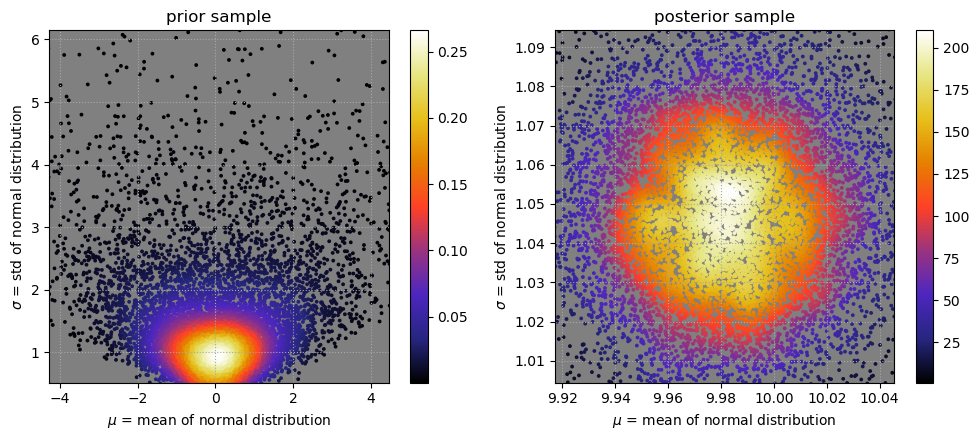

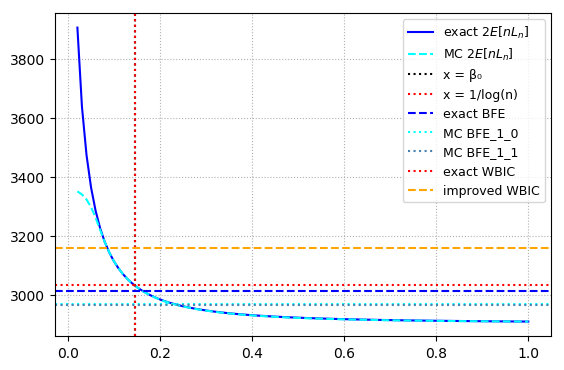

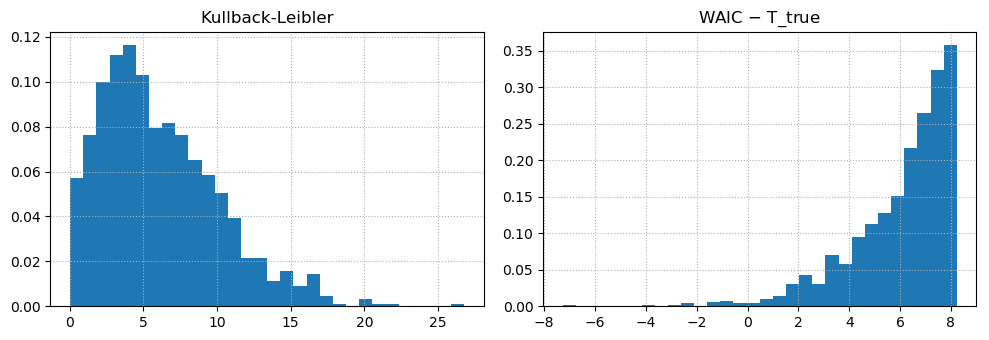

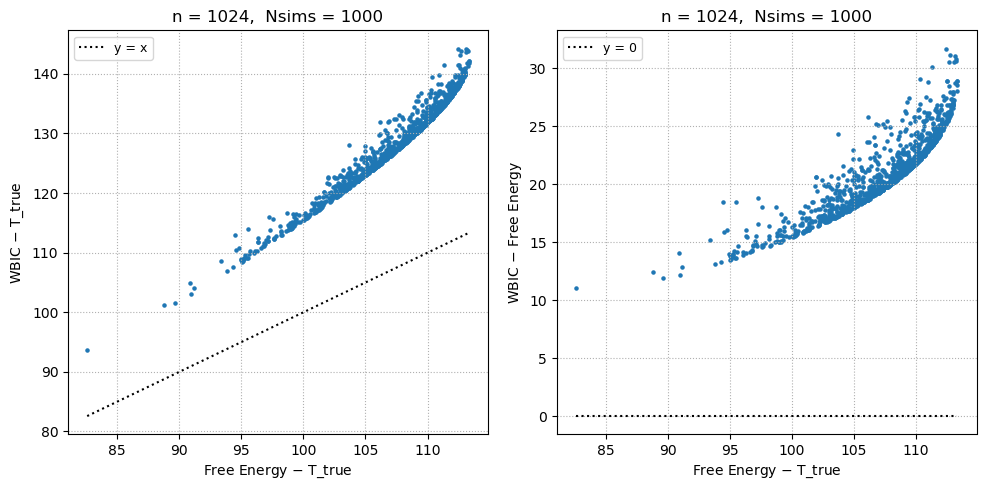

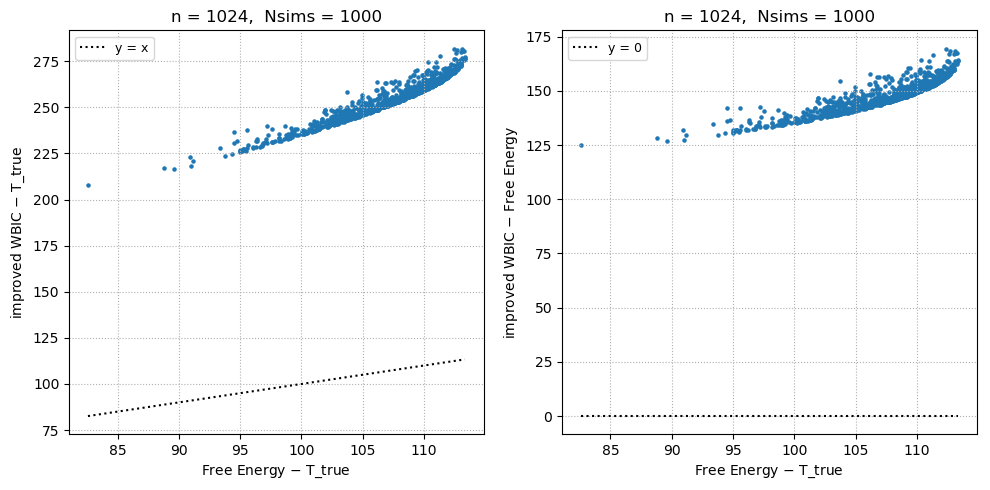

  2.126155 seconds (2.96 M allocations: 255.420 MiB, 1.43% gc time)


In [16]:
dist_true = Normal(10.0, 1.0)
n = 2^10
X = rand(dist_true, n)
β = 1.0

μ₀, αθ = 0.0, 1.0
λ₀, α = 1.0, 1.0
prior = NormalGamma(μ₀, λ₀, α, αθ/α)

β₀ = 1/log(n)

@time plotPP(prior, X, β)
@time plotBFE(X, β, β₀, prior)
@time plotsim(dist_true, n, prior, β)

(mean(X), std(X)) = (9.95725380782323, 0.9954933465945192)
  0.316851 seconds (55.98 k allocations: 13.851 MiB)
β₀ = 0.0
BFE_exact = 2922.173092509403
BFE_mcsim0 = 2923.7329776751785
BFE_mcsim = 2930.4023349983963
WBIC_exact = 2911.7350704656938
iWBIC = 2927.0210507759343
  5.862652 seconds (406.45 k allocations: 3.109 GiB, 4.31% gc time)
dist_true = Normal{Float64}(μ=10.0, σ=1.0)
n = 1024
prior = NormalGamma{Float64}(μ₀=0.0, λ₀=0.1, α=0.5, θ=2.0)
β = 1.0
Nsims = 1000
cor(KLs, WAICs - Ttrues) = -0.9722359578369641
cor(KLs, AICs - Ttrues) = -0.9725793485961806
(mean((WAICs - Ttrues) + KLs), std((WAICs - Ttrues) + KLs)) = (4.02083019916141, 0.46210914304357475)
(mean((LOOCVs - Ttrues) + KLs), std((LOOCVs - Ttrues) + KLs)) = (4.020899013232014, 0.46211203612408336)
(mean((AICs - Ttrues) + KLs), std((AICs - Ttrues) + KLs)) = (3.9963870193487683, 0.4589870878514836)
(mean((WAICs - Ttrues) - KLs), std((WAICs - Ttrues) - KLs)) = (-0.009626769376283392, 3.8821593126034126)
(mean((LOOCVs - Ttru

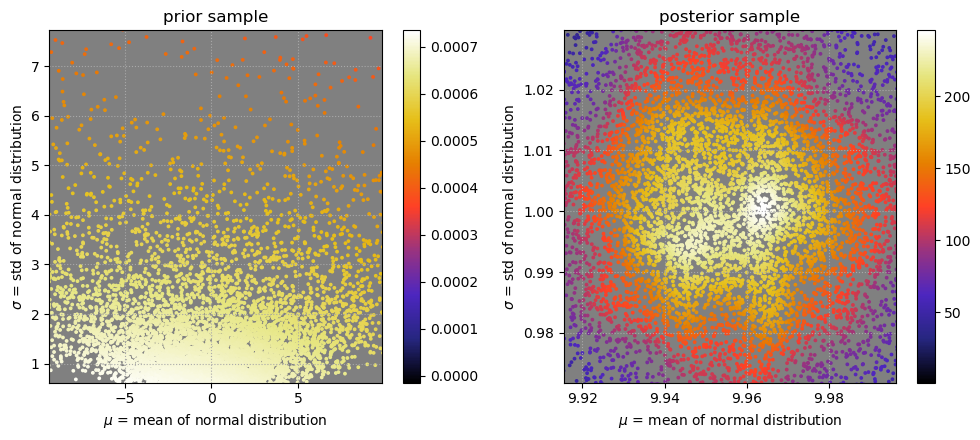

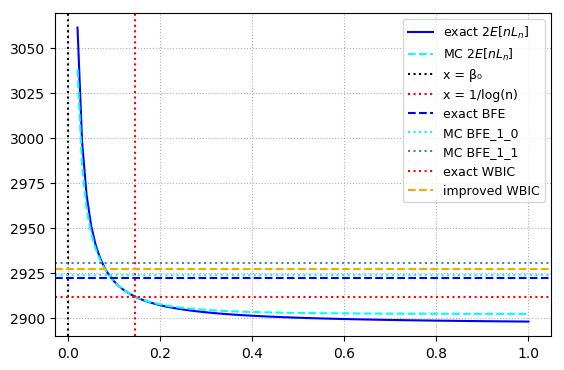

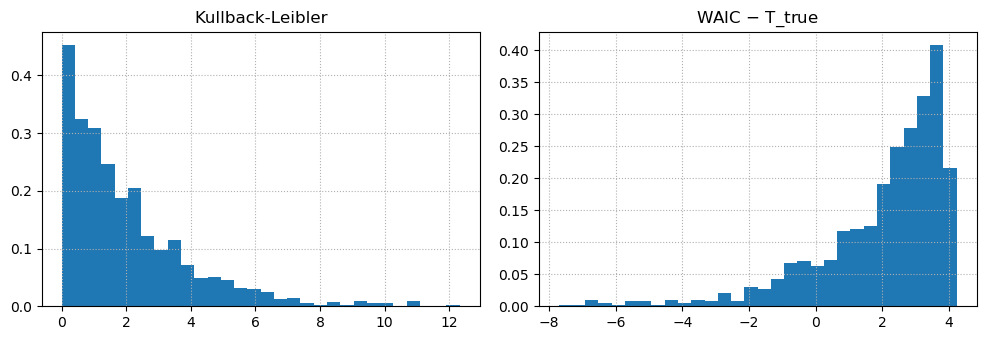

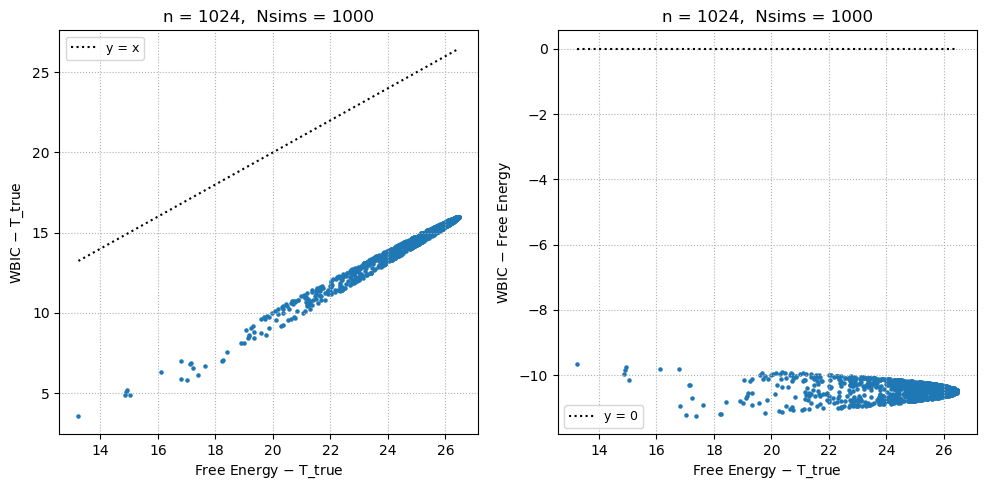

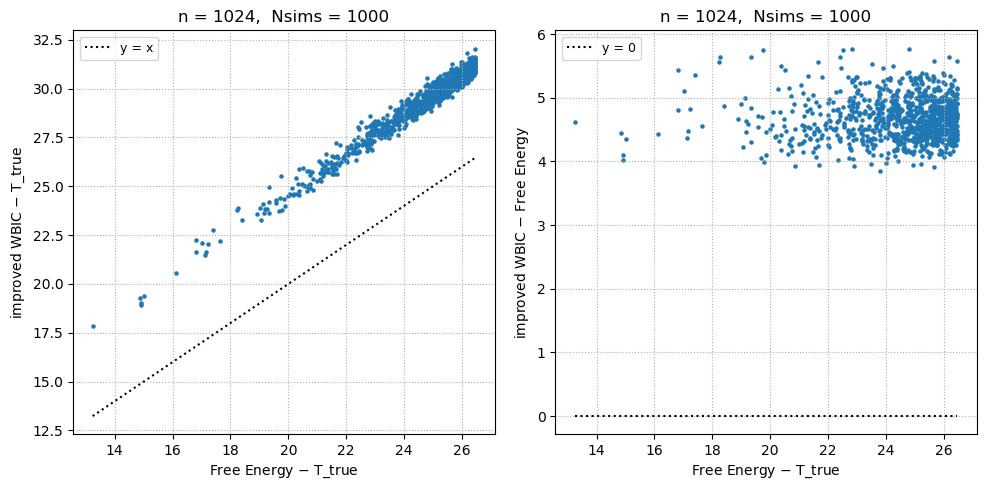

  2.118550 seconds (2.96 M allocations: 255.421 MiB, 1.39% gc time)


In [17]:
dist_true = Normal(10.0, 1.0)
n = 2^10
X = rand(dist_true, n)
β = 1.0
@show mean(X), std(X)

μ₀, αθ = 0.0, 1.0
λ₀, α = 0.1, 0.5
prior = NormalGamma(μ₀, λ₀, α, αθ/α)

#β₀ = 1/log(n)/10
β₀ = 0.0

@time plotPP(prior, X, β, epsilon=0.1)
@time plotBFE(X, β, β₀, prior)
@time plotsim(dist_true, n, prior, β)

β₀ = 0.0
BFE_exact = 2922.173092509403
BFE_mcsim0 = 2921.2669591362596
BFE_mcsim = 2923.039277241255
WBIC_exact = 2911.7350704656938
iWBIC = 2927.0210507759343
  6.296335 seconds (406.30 k allocations: 3.109 GiB, 4.65% gc time)
dist_true = Normal{Float64}(μ=10.0, σ=1.0)
n = 1024
prior = NormalGamma{Float64}(μ₀=0.0, λ₀=0.1, α=0.5, θ=2.0)
β = 1.0
Nsims = 1000
cor(KLs, WAICs - Ttrues) = -0.9699280800977559
cor(KLs, AICs - Ttrues) = -0.9705547087727595
(mean((WAICs - Ttrues) + KLs), std((WAICs - Ttrues) + KLs)) = (4.052798720854917, 0.4513397832955633)
(mean((LOOCVs - Ttrues) + KLs), std((LOOCVs - Ttrues) + KLs)) = (4.052867725607073, 0.451343893829468)
(mean((AICs - Ttrues) + KLs), std((AICs - Ttrues) + KLs)) = (4.030045190607057, 0.44604622974518565)
(mean((WAICs - Ttrues) - KLs), std((WAICs - Ttrues) - KLs)) = (0.2057369501286771, 3.6467815375208916)
(mean((LOOCVs - Ttrues) - KLs), std((LOOCVs - Ttrues) - KLs)) = (0.20580595488083328, 3.6467817587188676)
(mean((AICs - Ttrues) - KLs), st

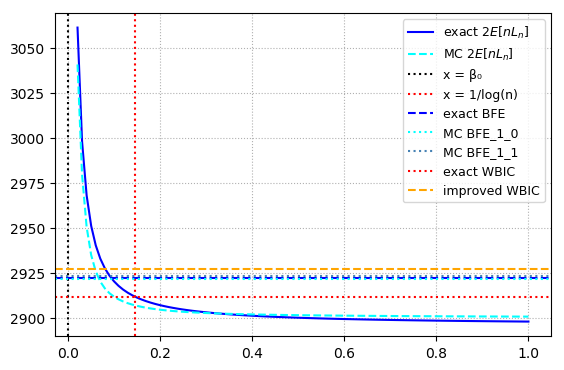

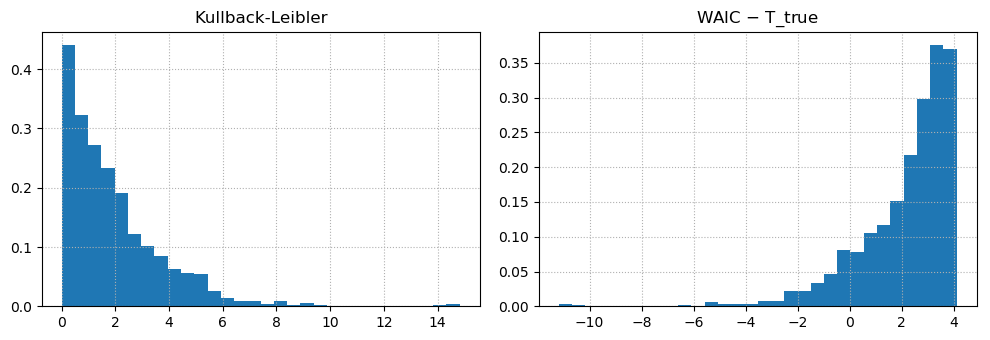

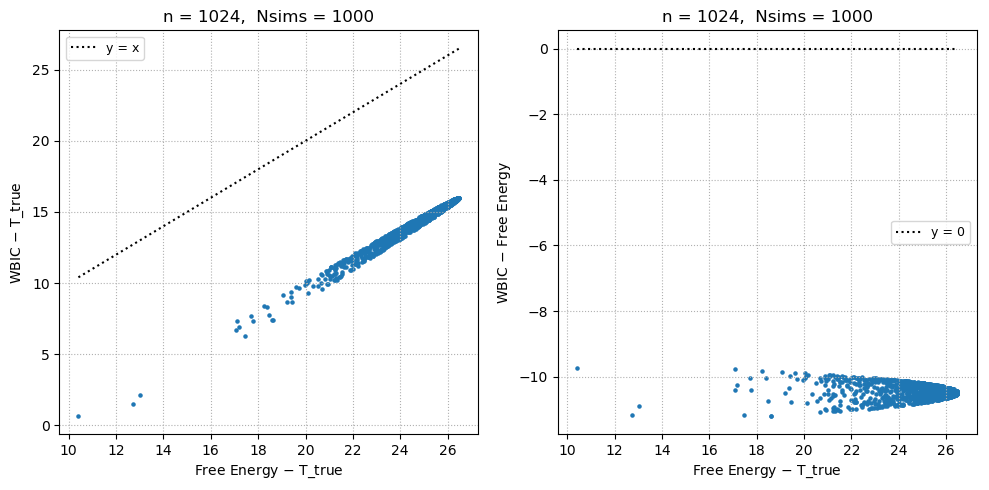

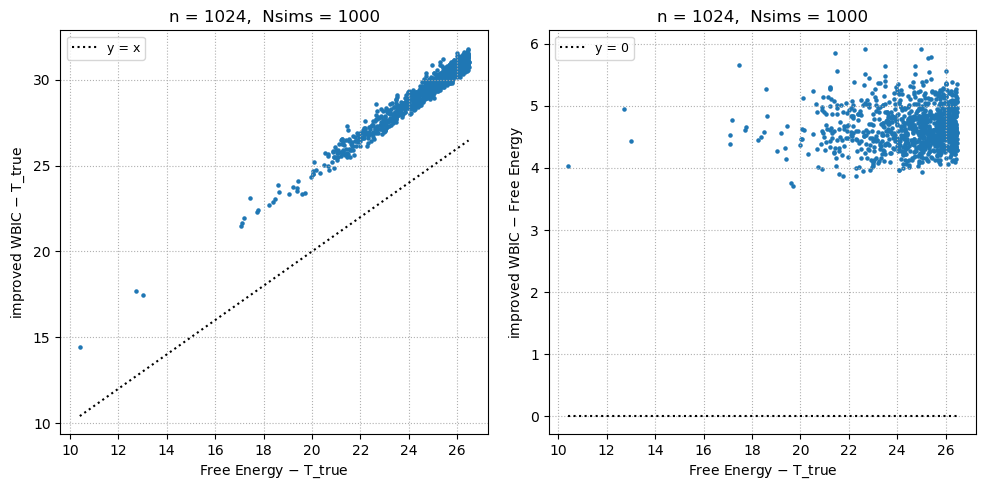

  2.622169 seconds (2.96 M allocations: 255.421 MiB, 5.40% gc time)


In [18]:
@time plotBFE(X, β, β₀, prior)
@time plotsim(dist_true, n, prior, β)

  0.221249 seconds (21.68 k allocations: 11.914 MiB, 2.11% gc time)
β₀ = 0.0
BFE_exact = 7561.922659756315
BFE_mcsim0 = 7562.28242960682
BFE_mcsim = 7565.9278672783
WBIC_exact = 7554.210309411495
iWBIC = 7564.991957256912
  6.038283 seconds (406.16 k allocations: 3.019 GiB, 4.12% gc time)
dist_true = Normal{Float64}(μ=10.0, σ=10.0)
n = 1024
prior = NormalGamma{Float64}(μ₀=0.0, λ₀=1.0, α=1.0, θ=1.0)
β = 1.0
Nsims = 1000
cor(KLs, WAICs - Ttrues) = -0.9972101320666686
cor(KLs, AICs - Ttrues) = -0.9978890679713515
(mean((WAICs - Ttrues) + KLs), std((WAICs - Ttrues) + KLs)) = (4.000952374746708, 0.15810088406086947)
(mean((LOOCVs - Ttrues) + KLs), std((LOOCVs - Ttrues) + KLs)) = (4.001022867659561, 0.15810928104771382)
(mean((AICs - Ttrues) + KLs), std((AICs - Ttrues) + KLs)) = (4.000175894924973, 0.13749773963910117)
(mean((WAICs - Ttrues) - KLs), std((WAICs - Ttrues) - KLs)) = (-0.18986404483250954, 4.229908928751785)
(mean((LOOCVs - Ttrues) - KLs), std((LOOCVs - Ttrues) - KLs)) = (-0.189

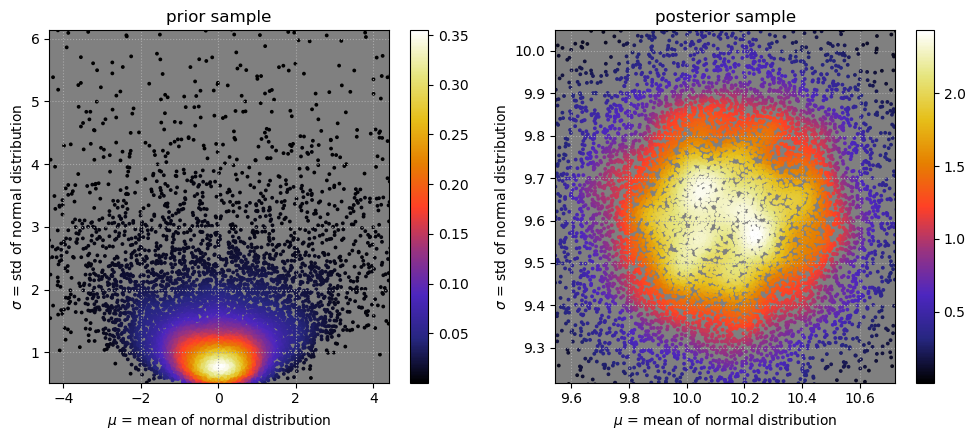

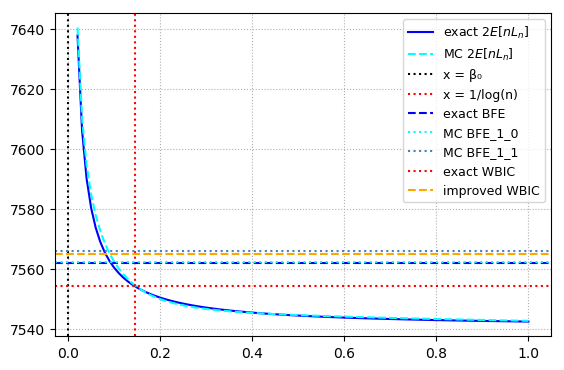

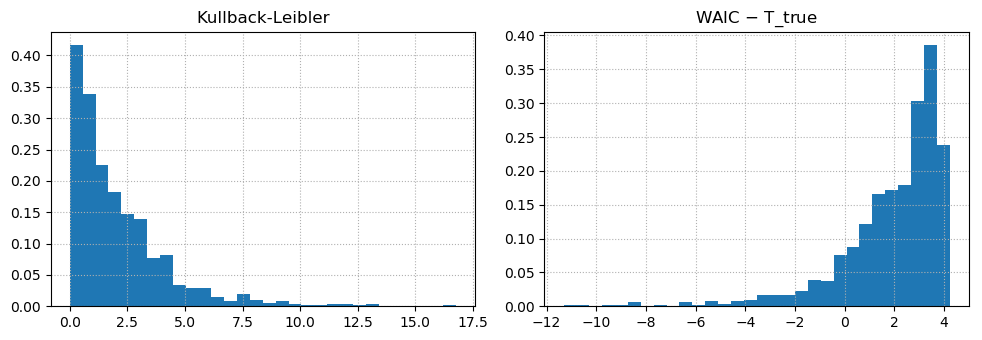

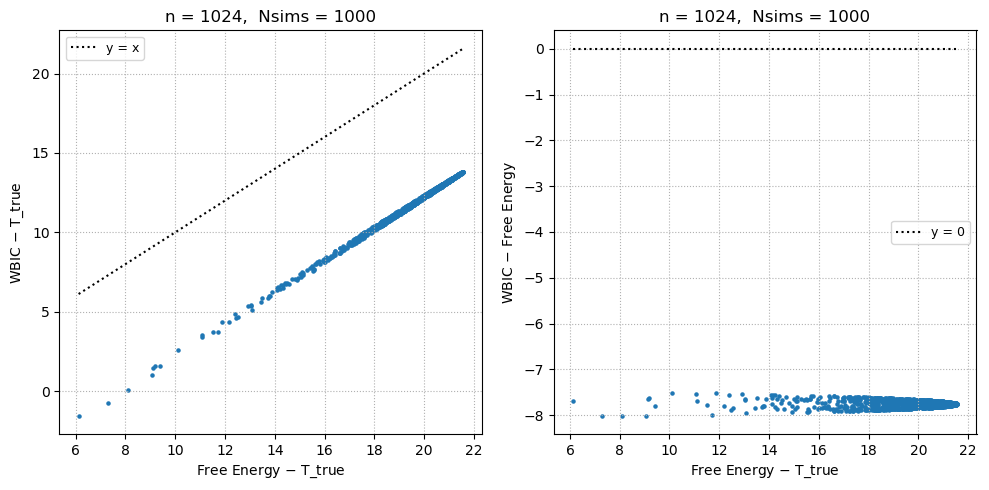

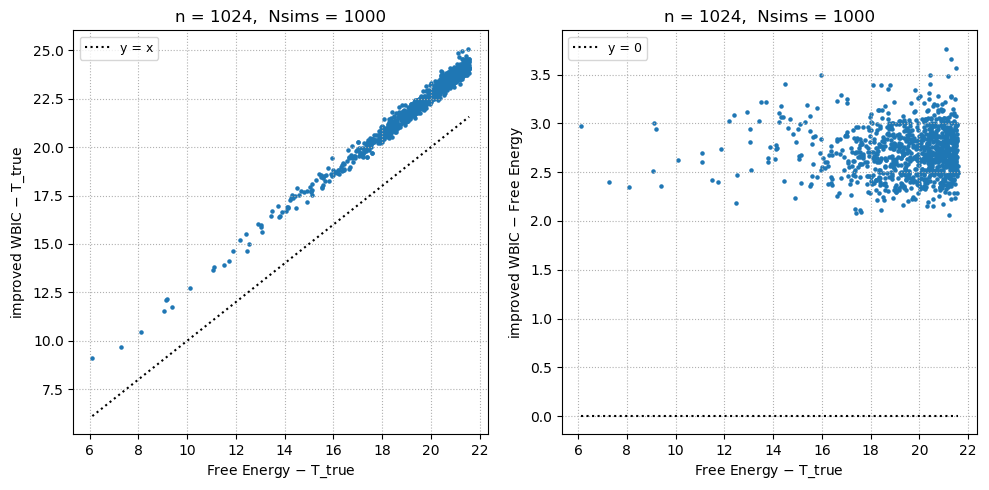

  2.173905 seconds (2.52 M allocations: 246.219 MiB, 1.19% gc time)


In [19]:
dist_true = Normal(10.0, 10.0)
n = 2^10
X = rand(dist_true, n)
β = 1.0

μ₀, αθ = 0.0, 1.0
λ₀, α = 1.0, 1.0
prior = NormalGamma(μ₀, λ₀, α, αθ/α)

#β₀ = 1/log(n)/10
β₀ = 0.0

@time plotPP(prior, X, β)
@time plotBFE(X, β, β₀, prior)
@time plotsim(dist_true, n, prior, β)

  0.185607 seconds (21.68 k allocations: 11.914 MiB, 1.56% gc time)
β₀ = 0.0
BFE_exact = 7647.9156377590125
BFE_mcsim0 = 7651.937418173104
BFE_mcsim = 7650.280746784121
WBIC_exact = 7636.611696499679
iWBIC = 7647.003033744852
  4.960540 seconds (406.43 k allocations: 3.109 GiB, 4.63% gc time)
dist_true = Normal{Float64}(μ=10.0, σ=10.0)
n = 1024
prior = NormalGamma{Float64}(μ₀=0.0, λ₀=0.01, α=1.0, θ=1.0)
β = 1.0
Nsims = 1000
cor(KLs, WAICs - Ttrues) = -0.997084175925989
cor(KLs, AICs - Ttrues) = -0.9977246741541395
(mean((WAICs - Ttrues) + KLs), std((WAICs - Ttrues) + KLs)) = (4.013593501865555, 0.158971656349624)
(mean((LOOCVs - Ttrues) + KLs), std((LOOCVs - Ttrues) + KLs)) = (4.013665457737763, 0.15897998741104824)
(mean((AICs - Ttrues) + KLs), std((AICs - Ttrues) + KLs)) = (4.008208927830511, 0.14166276844656756)
(mean((WAICs - Ttrues) - KLs), std((WAICs - Ttrues) - KLs)) = (0.007825581238255837, 4.066821065380221)
(mean((LOOCVs - Ttrues) - KLs), std((LOOCVs - Ttrues) - KLs)) = (0.00

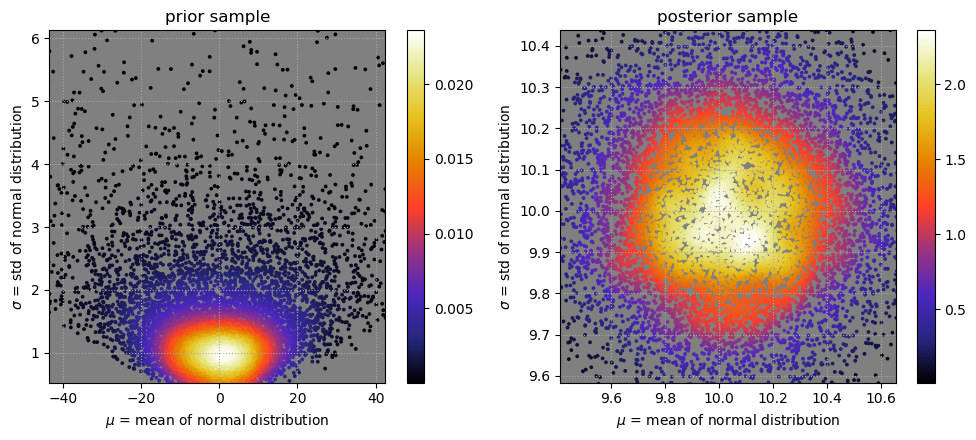

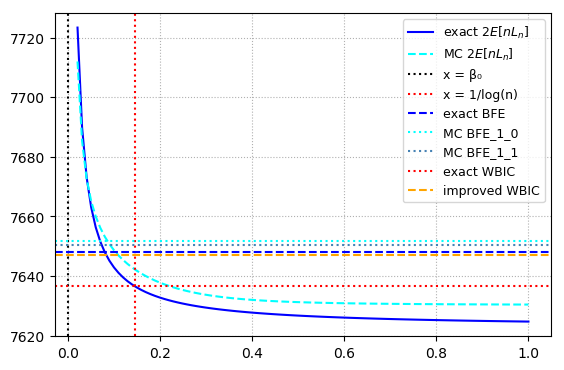

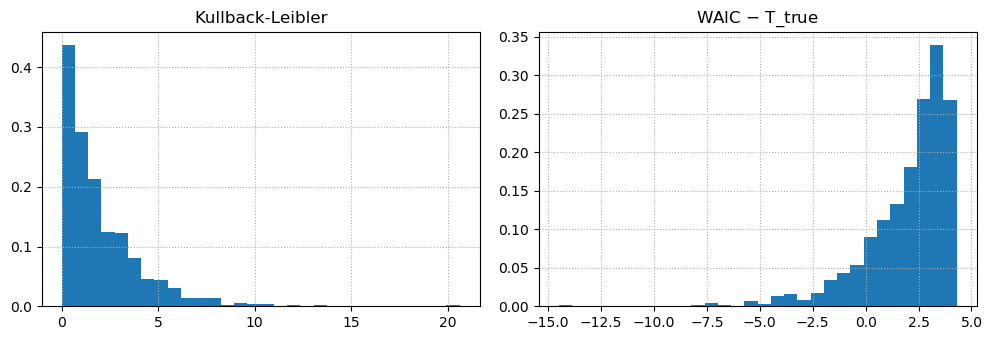

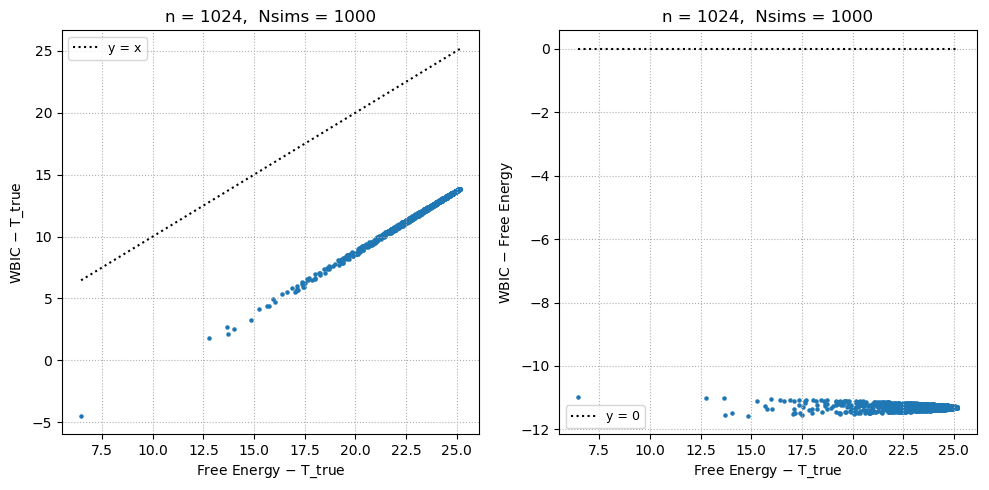

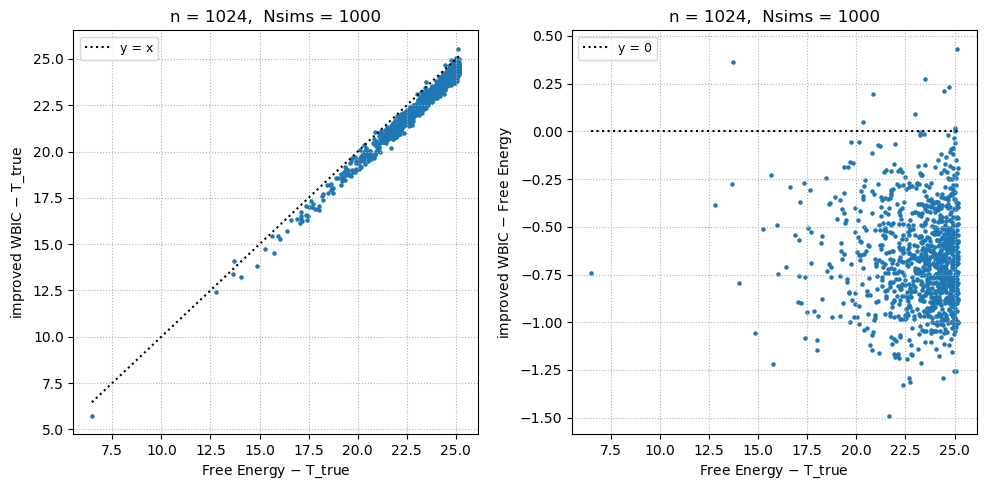

  1.991827 seconds (2.52 M allocations: 246.220 MiB, 1.24% gc time)


In [20]:
dist_true = Normal(10.0, 10.0)
n = 2^10
X = rand(dist_true, n)
β = 1.0

μ₀, αθ = 0.0, 1.0
λ₀, α = 1.0/100, 1.0
prior = NormalGamma(μ₀, λ₀, α, αθ/α)

#β₀ = 1/log(n)/10
β₀ = 0.0

@time plotPP(prior, X, β)
@time plotBFE(X, β, β₀, prior)
@time plotsim(dist_true, n, prior, β)

  0.250265 seconds (21.66 k allocations: 11.914 MiB)
β₀ = 0.0
BFE_exact = 209.91130019967412
BFE_mcsim0 = 209.85543095057992
BFE_mcsim = 209.8576725674078
WBIC_exact = 206.0109118706244
iWBIC = 229.76188004842578
  2.903422 seconds (404.74 k allocations: 1.139 GiB, 4.18% gc time)
dist_true = Normal{Float64}(μ=5.0, σ=1.0)
n = 64
prior = NormalGamma{Float64}(μ₀=0.0, λ₀=0.1, α=1.0, θ=1.0)
β = 1.0
Nsims = 1000
cor(KLs, WAICs - Ttrues) = -0.9549045466815763
cor(KLs, AICs - Ttrues) = -0.9603368103205143
(mean((WAICs - Ttrues) + KLs), std((WAICs - Ttrues) + KLs)) = (3.8177162922248473, 0.6644301755803311)
(mean((LOOCVs - Ttrues) + KLs), std((LOOCVs - Ttrues) + KLs)) = (3.831258983349116, 0.6684393737333694)
(mean((AICs - Ttrues) + KLs), std((AICs - Ttrues) + KLs)) = (3.855376922233433, 0.62325650698663)
(mean((WAICs - Ttrues) - KLs), std((WAICs - Ttrues) - KLs)) = (-0.08900611327807999, 4.117584197926088)
(mean((LOOCVs - Ttrues) - KLs), std((LOOCVs - Ttrues) - KLs)) = (-0.07546342215381197, 4

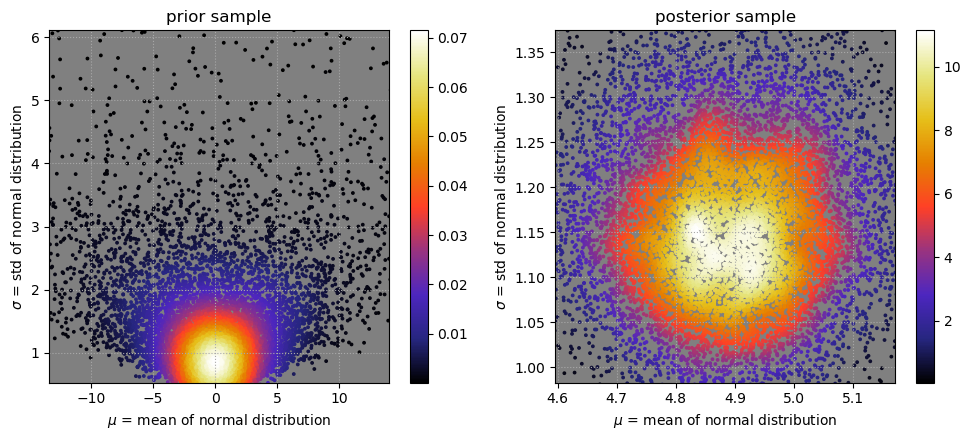

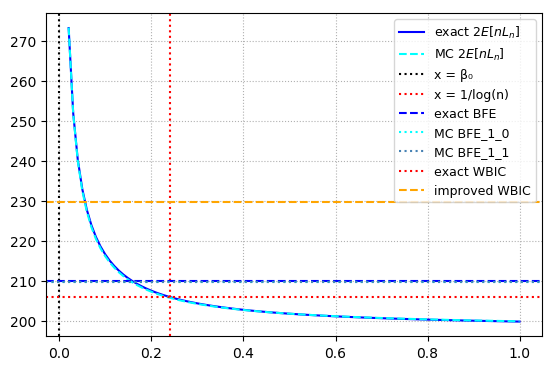

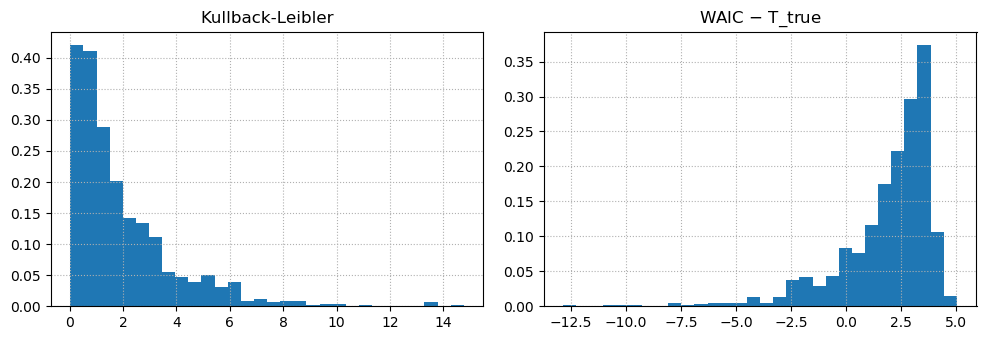

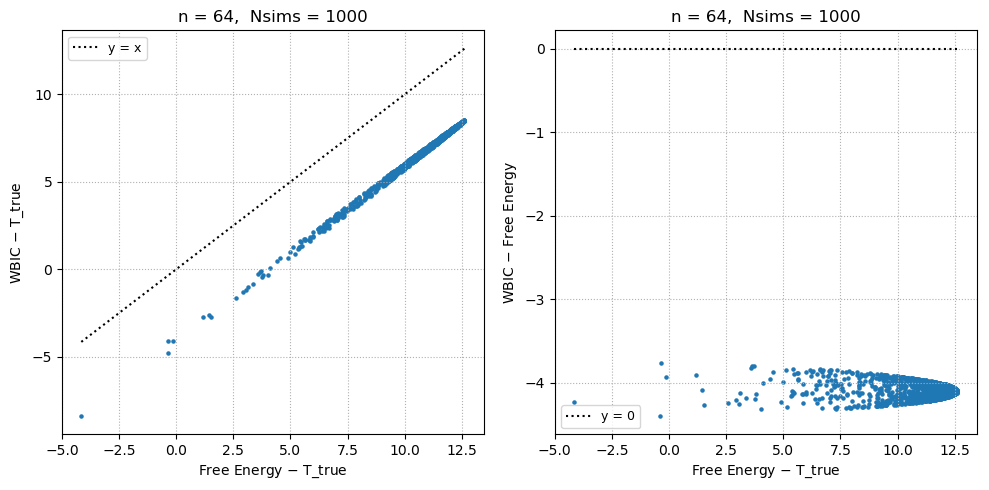

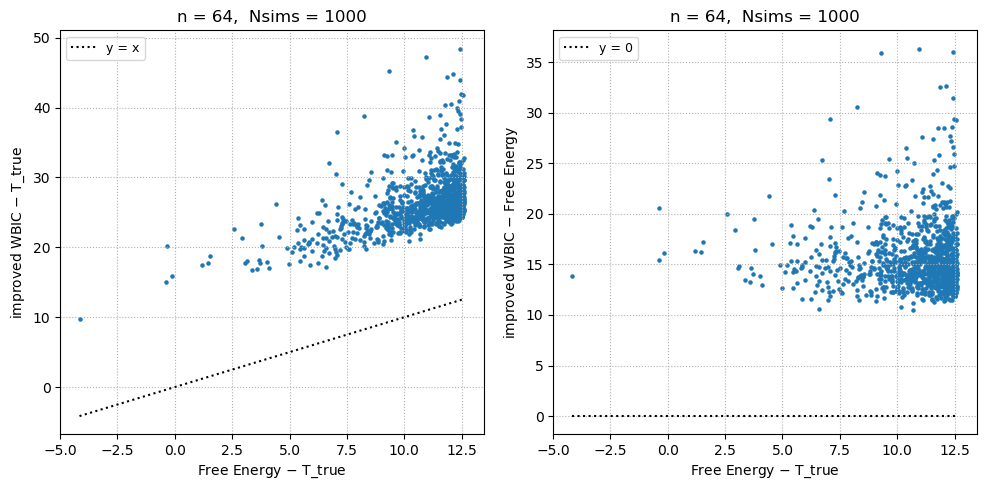

  0.697700 seconds (1.18 M allocations: 38.555 MiB, 1.00% gc time)


In [21]:
dist_true = Normal(5.0, 1.0)
n = 2^6
X = rand(dist_true, n)
β = 1.0

μ₀, αθ = 0.0, 1.0
λ₀, α = 0.1, 1.0
prior = NormalGamma(μ₀, λ₀, α, αθ/α)

#β₀ = 1/log(n)/10
β₀ = 0.0

@time plotPP(prior, X, β)
@time plotBFE(X, β, β₀, prior)
@time plotsim(dist_true, n, prior, β)

  0.316150 seconds (21.68 k allocations: 11.914 MiB, 1.22% gc time)
β₀ = 0.0
BFE_exact = 187.42020886804877
BFE_mcsim0 = 187.1998425958861
BFE_mcsim = 187.55343873897692
WBIC_exact = 182.7396775394893
iWBIC = 204.24124507419137
  3.319990 seconds (405.01 k allocations: 1.228 GiB, 7.67% gc time)
dist_true = Normal{Float64}(μ=5.0, σ=1.0)
n = 64
prior = NormalGamma{Float64}(μ₀=0.0, λ₀=0.1, α=0.5, θ=2.0)
β = 1.0
Nsims = 1000
cor(KLs, WAICs - Ttrues) = -0.950609373226736
cor(KLs, AICs - Ttrues) = -0.9570443118954489
(mean((WAICs - Ttrues) + KLs), std((WAICs - Ttrues) + KLs)) = (3.875318068903525, 0.6619942823866798)
(mean((LOOCVs - Ttrues) + KLs), std((LOOCVs - Ttrues) + KLs)) = (3.8887295345510373, 0.6663736222840814)
(mean((AICs - Ttrues) + KLs), std((AICs - Ttrues) + KLs)) = (3.9061130048442783, 0.6177368166661621)
(mean((WAICs - Ttrues) - KLs), std((WAICs - Ttrues) - KLs)) = (-0.06337354884842938, 3.9902264522882818)
(mean((LOOCVs - Ttrues) - KLs), std((LOOCVs - Ttrues) - KLs)) = (-0.04

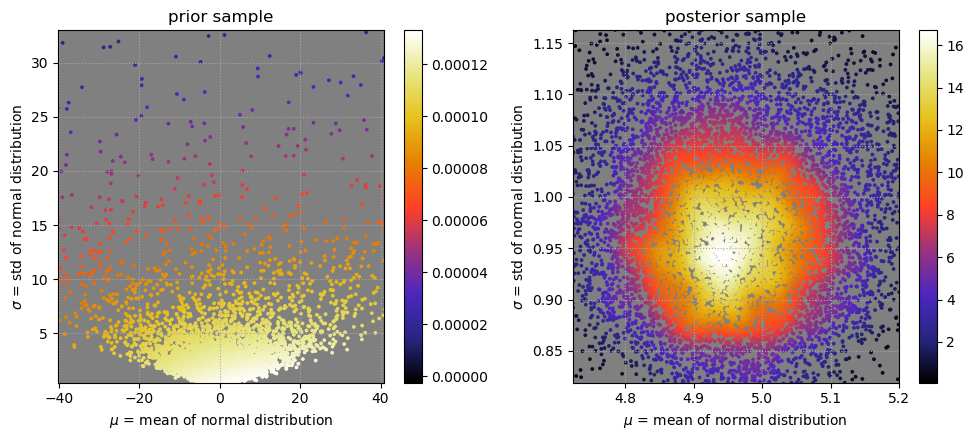

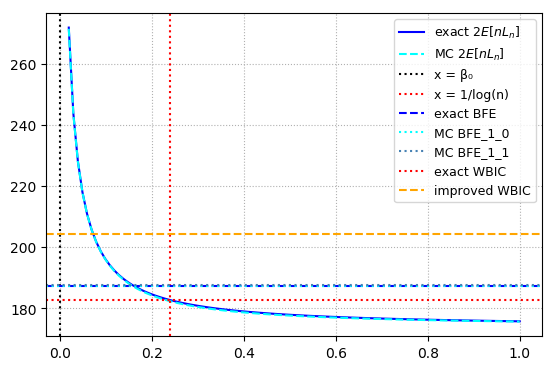

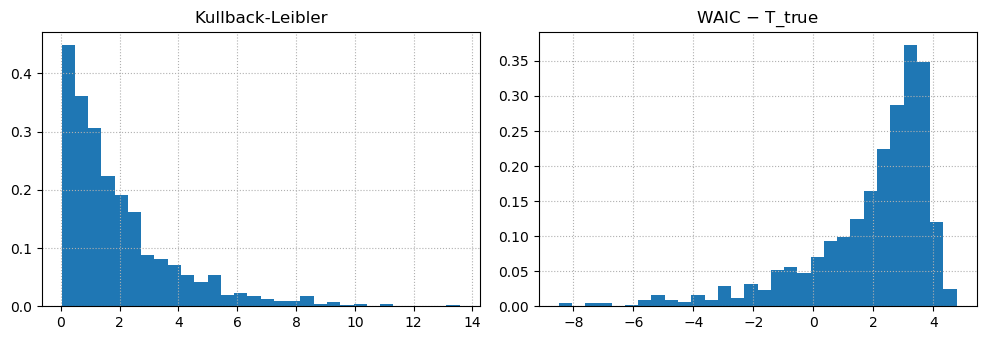

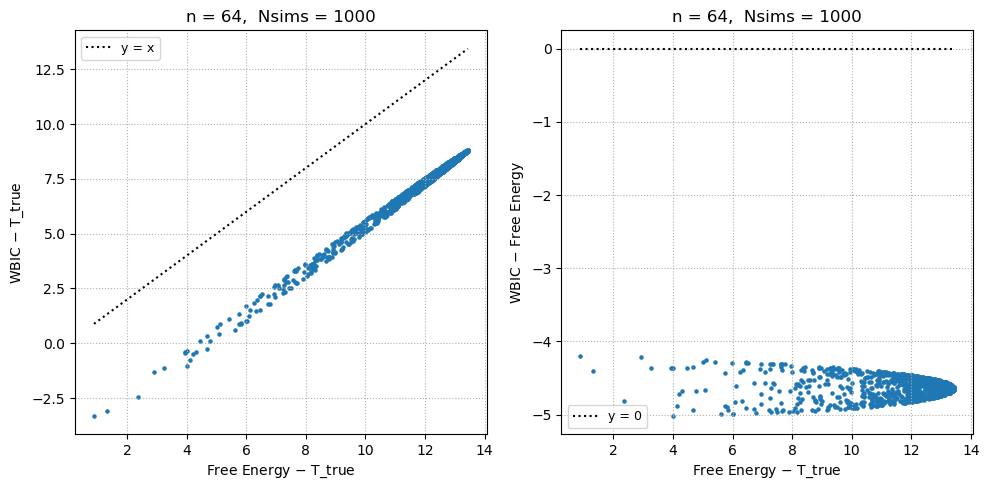

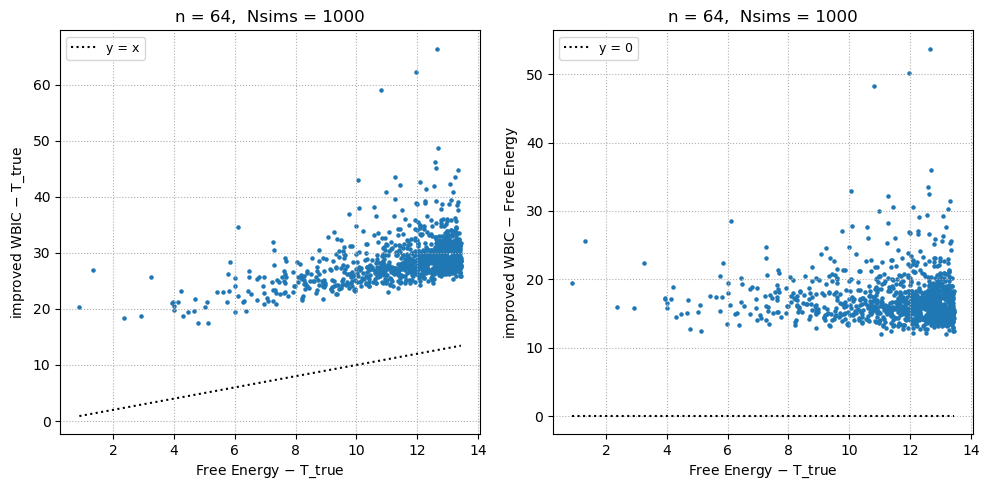

  0.805723 seconds (1.18 M allocations: 38.555 MiB, 0.75% gc time)


In [22]:
dist_true = Normal(5.0, 1.0)
n = 2^6
X = rand(dist_true, n)
β = 1.0

μ₀, αθ = 0.0, 1.0
λ₀, α = 0.1, 0.5
prior = NormalGamma(μ₀, λ₀, α, αθ/α)

#β₀ = 1/log(n)/10
β₀ = 0.0

@time plotPP(prior, X, β)
@time plotBFE(X, β, β₀, prior)
@time plotsim(dist_true, n, prior, β)

  0.182927 seconds (21.68 k allocations: 11.914 MiB, 1.88% gc time)
β₀ = 0.0
BFE_exact = 2856.8528508595964
BFE_mcsim0 = 2857.2253913370155
BFE_mcsim = 2859.143213899426
WBIC_exact = 2847.298730817545
iWBIC = 2857.5313135248593
  6.239843 seconds (408.15 k allocations: 3.645 GiB, 3.50% gc time)
dist_true = Normal{Float64}(μ=5.0, σ=1.0)
n = 1024
prior = NormalGamma{Float64}(μ₀=0.0, λ₀=0.0001, α=0.5, θ=2.0)
β = 1.0
Nsims = 1000
cor(KLs, WAICs - Ttrues) = -0.9980190694956005
cor(KLs, AICs - Ttrues) = -0.9987713358926297
(mean((WAICs - Ttrues) + KLs), std((WAICs - Ttrues) + KLs)) = (4.006964359268639, 0.12927243745107483)
(mean((LOOCVs - Ttrues) + KLs), std((LOOCVs - Ttrues) + KLs)) = (4.007036726959211, 0.12928403808992497)
(mean((AICs - Ttrues) + KLs), std((AICs - Ttrues) + KLs)) = (4.0025895502961335, 0.10233849564354856)
(mean((WAICs - Ttrues) - KLs), std((WAICs - Ttrues) - KLs)) = (-0.010293945980923126, 4.047635672210657)
(mean((LOOCVs - Ttrues) - KLs), std((LOOCVs - Ttrues) - KLs)) 

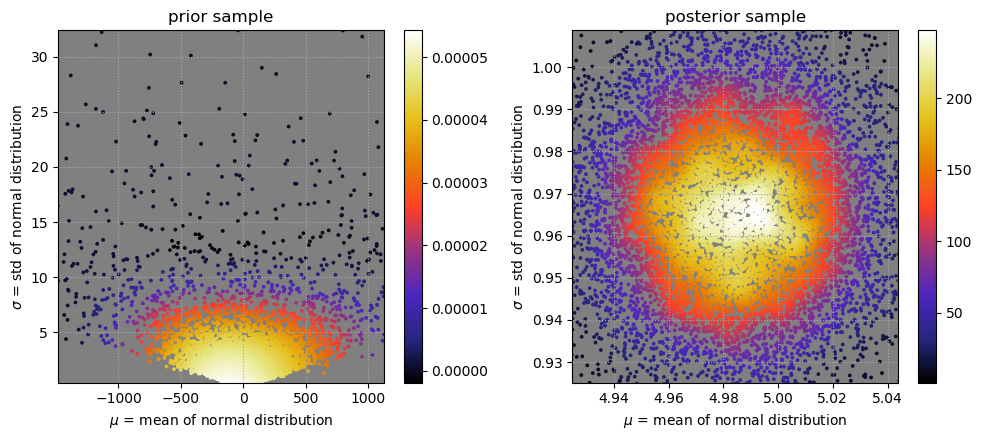

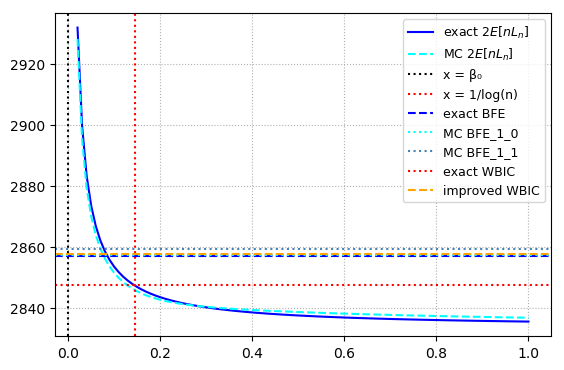

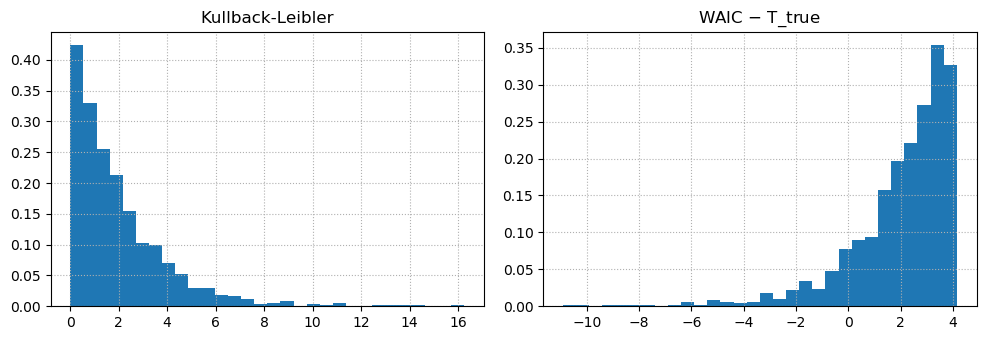

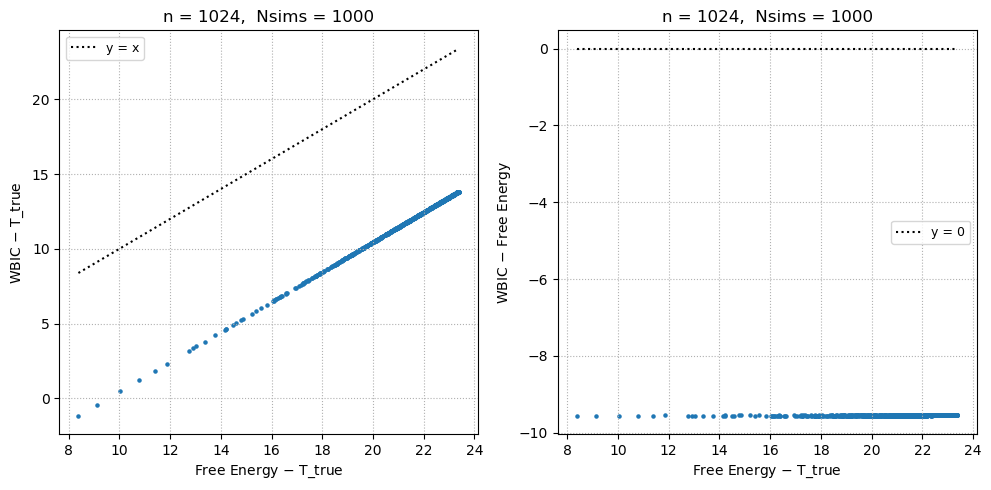

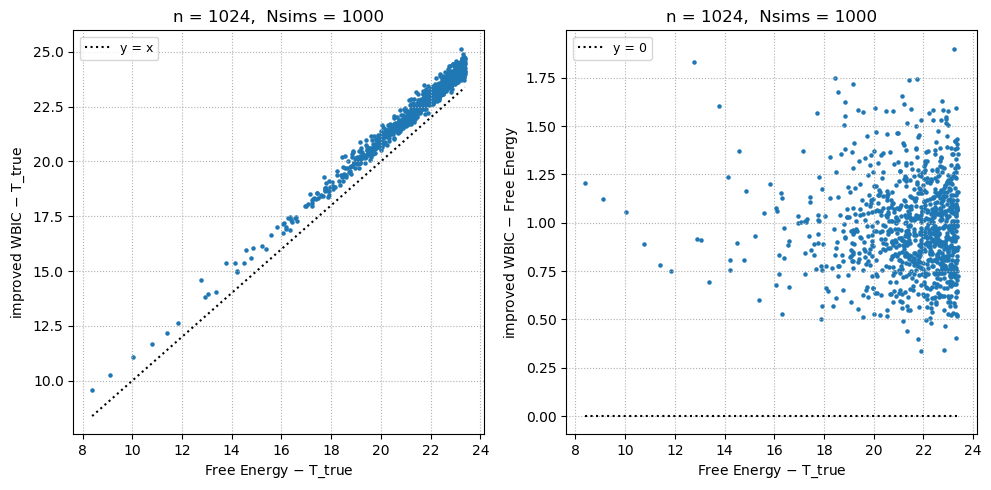

  2.200043 seconds (3.10 M allocations: 258.351 MiB, 1.28% gc time)


In [23]:
dist_true = Normal(5.0, 1.0)
n = 2^10
X = rand(dist_true, n)
β = 1.0

μ₀, αθ = 0.0, 1.0
λ₀, α = 0.0001, 0.5
prior = NormalGamma(μ₀, λ₀, α, αθ/α)

β₀ = 0.0

@time plotPP(prior, X, β)
@time plotBFE(X, β, β₀, prior)
@time plotsim(dist_true, n, prior, β)

  0.196285 seconds (21.68 k allocations: 11.914 MiB, 2.22% gc time)
β₀ = 0.0
BFE_exact = 2999.734643696783
BFE_mcsim0 = 2999.4699817572923
BFE_mcsim = 2999.9926185527274
WBIC_exact = 2990.1834172404806
iWBIC = 3000.939686847644
  6.123136 seconds (408.15 k allocations: 3.645 GiB, 4.68% gc time)
dist_true = Normal{Float64}(μ=0.0, σ=1.0)
n = 1024
prior = NormalGamma{Float64}(μ₀=0.0, λ₀=0.0001, α=0.5, θ=2.0)
β = 1.0
Nsims = 1000
cor(KLs, WAICs - Ttrues) = -0.9980525466396244
cor(KLs, AICs - Ttrues) = -0.9990763482677989
(mean((WAICs - Ttrues) + KLs), std((WAICs - Ttrues) + KLs)) = (4.005452752852222, 0.11669267327668431)
(mean((LOOCVs - Ttrues) + KLs), std((LOOCVs - Ttrues) + KLs)) = (4.005524908387168, 0.11670845346247963)
(mean((AICs - Ttrues) + KLs), std((AICs - Ttrues) + KLs)) = (4.001242240523328, 0.08046391568199895)
(mean((WAICs - Ttrues) - KLs), std((WAICs - Ttrues) - KLs)) = (0.052355205453393866, 3.7367377716365593)
(mean((LOOCVs - Ttrues) - KLs), std((LOOCVs - Ttrues) - KLs)) =

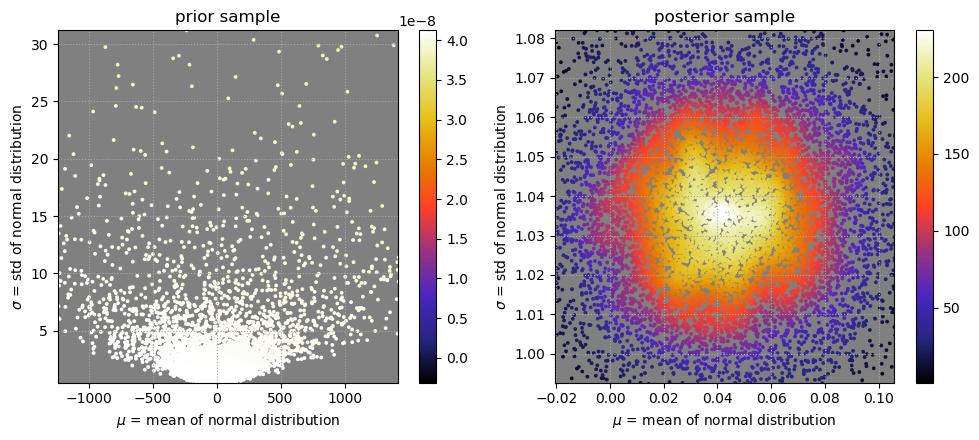

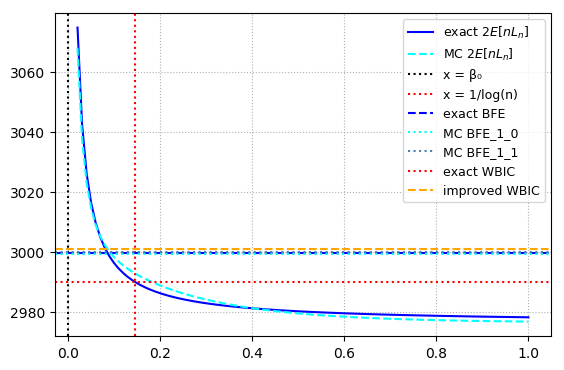

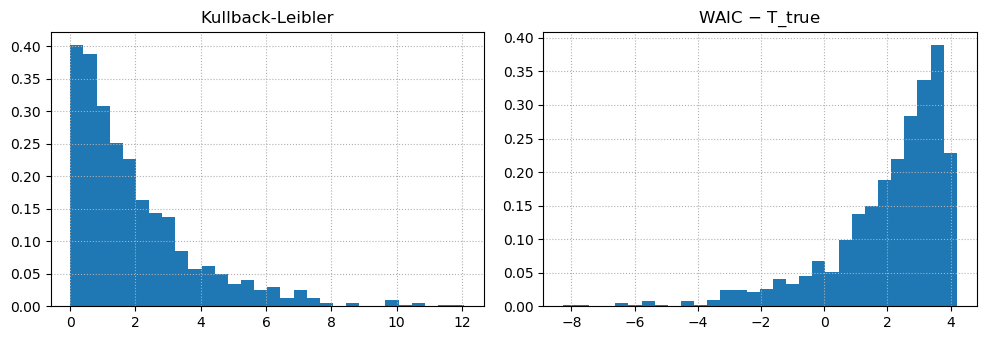

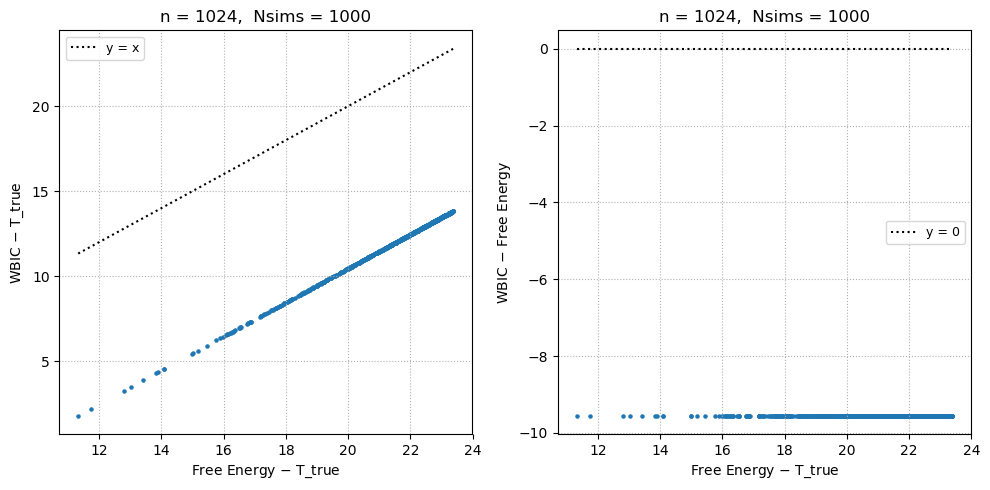

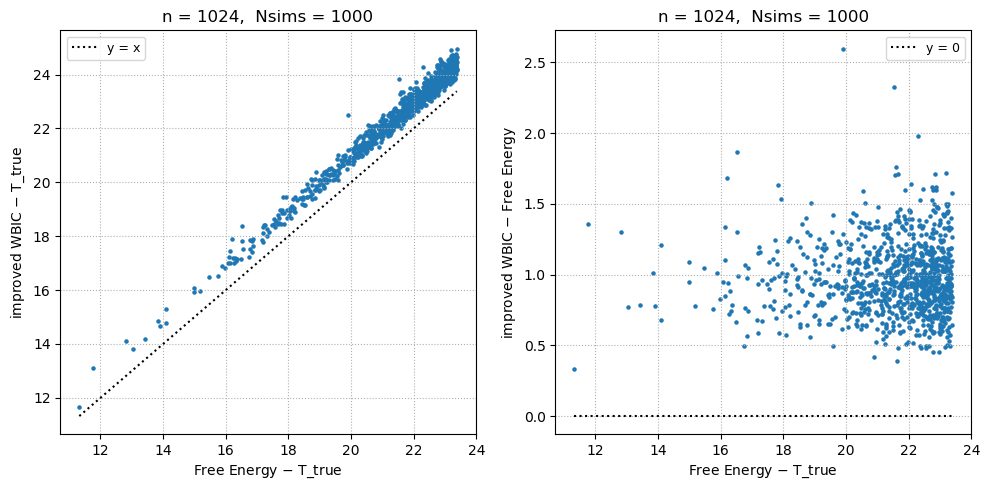

  2.044767 seconds (3.10 M allocations: 258.345 MiB, 1.34% gc time)


In [24]:
dist_true = Normal(0.0, 1.0)
n = 2^10
X = rand(dist_true, n)
β = 1.0

μ₀, αθ = 0.0, 1.0
λ₀, α = 0.0001, 0.5
prior = NormalGamma(μ₀, λ₀, α, αθ/α)

β₀ = 0.0

@time plotPP(prior, X, β)
@time plotBFE(X, β, β₀, prior)
@time plotsim(dist_true, n, prior, β)

  0.193147 seconds (21.68 k allocations: 11.914 MiB, 1.43% gc time)
β₀ = 0.0
BFE_exact = 92.44602252362168
BFE_mcsim0 = 92.69457232846645
BFE_mcsim = 92.59405620790126
WBIC_exact = 82.59807038632131
iWBIC = 320119.7613520692
  3.720514 seconds (407.01 k allocations: 1.812 GiB, 4.99% gc time)
dist_true = Normal{Float64}(μ=0.0, σ=1.0)
n = 32
prior = NormalGamma{Float64}(μ₀=0.0, λ₀=0.0001, α=0.5, θ=2.0)
β = 1.0
Nsims = 1000
cor(KLs, WAICs - Ttrues) = -0.9529611449102094
cor(KLs, AICs - Ttrues) = -0.9714987428474604
(mean((WAICs - Ttrues) + KLs), std((WAICs - Ttrues) + KLs)) = (3.9144915786101047, 0.6230334504532503)
(mean((LOOCVs - Ttrues) + KLs), std((LOOCVs - Ttrues) + KLs)) = (3.965047764003747, 0.6538114697086972)
(mean((AICs - Ttrues) + KLs), std((AICs - Ttrues) + KLs)) = (3.8943134245868065, 0.47383282287698114)
(mean((WAICs - Ttrues) - KLs), std((WAICs - Ttrues) - KLs)) = (0.1441309804203203, 3.9655084965068204)
(mean((LOOCVs - Ttrues) - KLs), std((LOOCVs - Ttrues) - KLs)) = (0.194

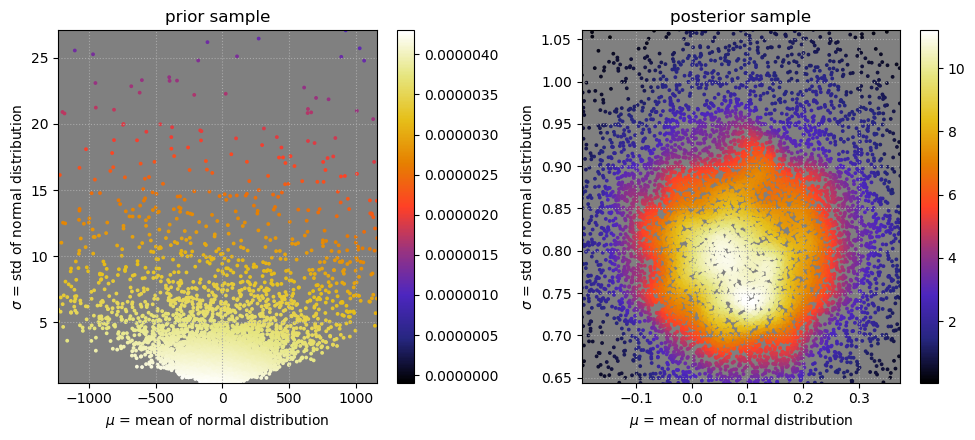

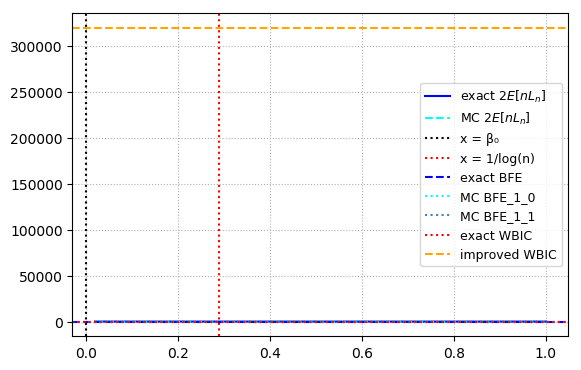

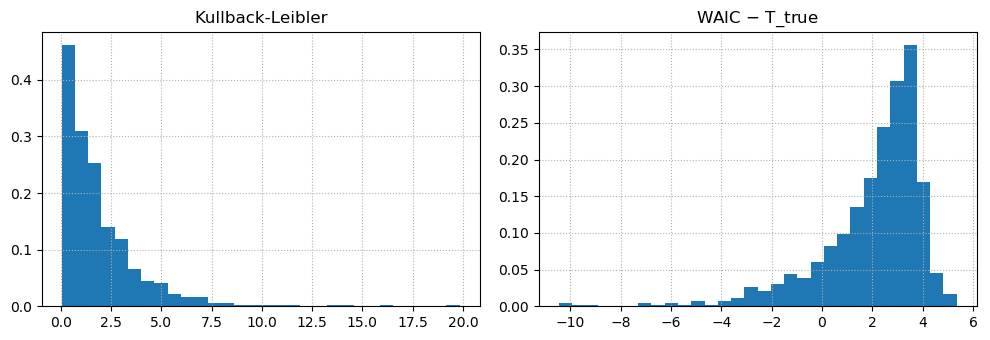

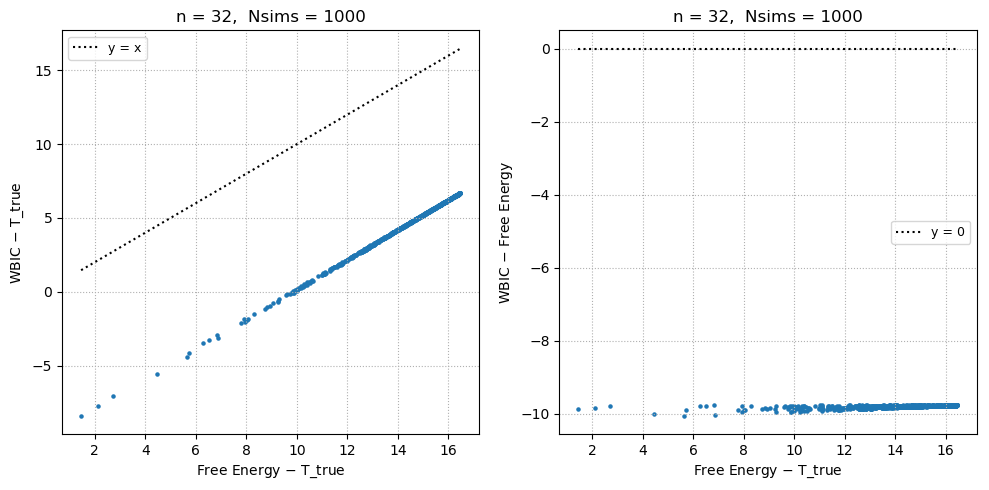

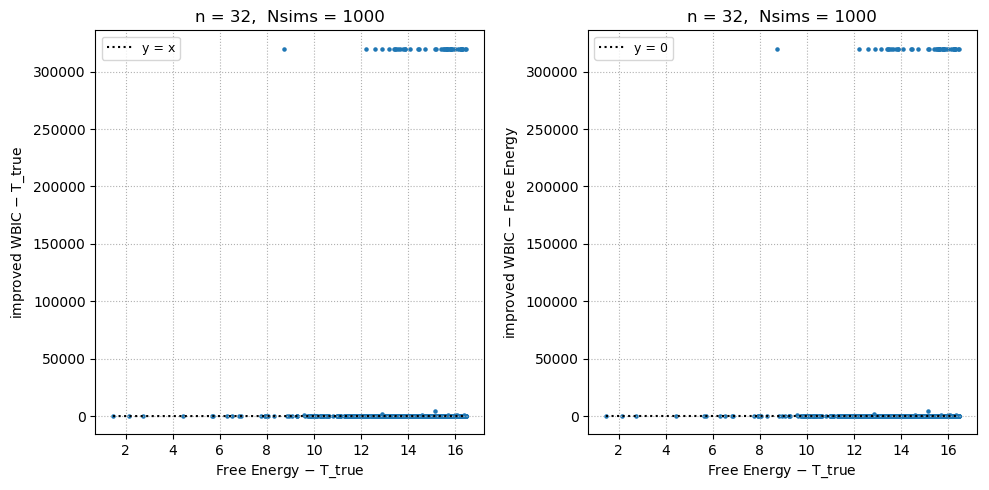

  0.925498 seconds (1.11 M allocations: 31.334 MiB, 0.40% gc time)


In [25]:
dist_true = Normal(0.0, 1.0)
n = 2^5
X = rand(dist_true, n)
β = 1.0

μ₀, αθ = 0.0, 1.0
λ₀, α = 0.0001, 0.5
prior = NormalGamma(μ₀, λ₀, α, αθ/α)

β₀ = 0.0
#β₀ = 1/log(n)

@time plotPP(prior, X, β)
@time plotBFE(X, β, β₀, prior)
@time plotsim(dist_true, n, prior, β)

## 事前分布選択

WAIC, LOOCV, BFE = Bayesian Free Energy, WBIC, iWBIC については Ttrue を引いた結果を使う. T_true は共通のモデル選択に影響しない大きな揺らぎ成分を含んでおり, その揺らぎの影響を除いてから比較したい.

赤と青は左右でモデル選択が一致している場合で、黄色とシアンは左右でモデル選択が一致していない場合。

Nsims = 1000 = 1000
(μ₀, μ_λ) = (0.5, 1.0) = (0.5, 1.0)
dist_true = Normal(μ₀, 1 / sqrt(μ_λ)) = Normal{Float64}(μ=0.5, σ=1.0)
n = 2 ^ 5 = 32
prior0 = NormalGamma(μ₀, 1.0, 1.0e8, μ_λ / 1.0e8) = NormalGamma{Float64}(μ₀=0.5, λ₀=1.0, α=1.0e8, θ=1.0e-8)
prior1 = NormalGamma(μ₀, 1.0, 1.0, μ_λ / 1.0) = NormalGamma{Float64}(μ₀=0.5, λ₀=1.0, α=1.0, θ=1.0)

count(KL0s .< KL1s) / Nsims = 0.979
count(WAIC0s .< WAIC1s) / Nsims = 0.813
count(LOOCV0s .< LOOCV1s) / Nsims = 0.816
count(AICms .< AICs) / Nsims = 0.819
count(AICss .< AICs) / Nsims = 0.078

count(BFE0s .< BFE1s) / Nsims = 0.901
count(WBIC0s .< WBIC1s) / Nsims = 0.894
count(iWBIC0s .< iWBIC1s) / Nsims = 0.889
count(BICms .< BICs) / Nsims = 0.919
count(BICss .< BICs) / Nsims = 0.17

cor(KL1s - KL0s, WAIC1s - WAIC0s) = -0.9270148170566375
cor(KL1s - KL0s, LOOCV1s - LOOCV0s) = -0.919200776357849
cor(WAIC1s - WAIC0s, LOOCV1s - LOOCV0s) = 0.999337755676818
(mean(KL1s - KL0s), std(KL1s - KL0s)) = (0.933890934156216, 1.3332498901764147)
(mean(WAIC1

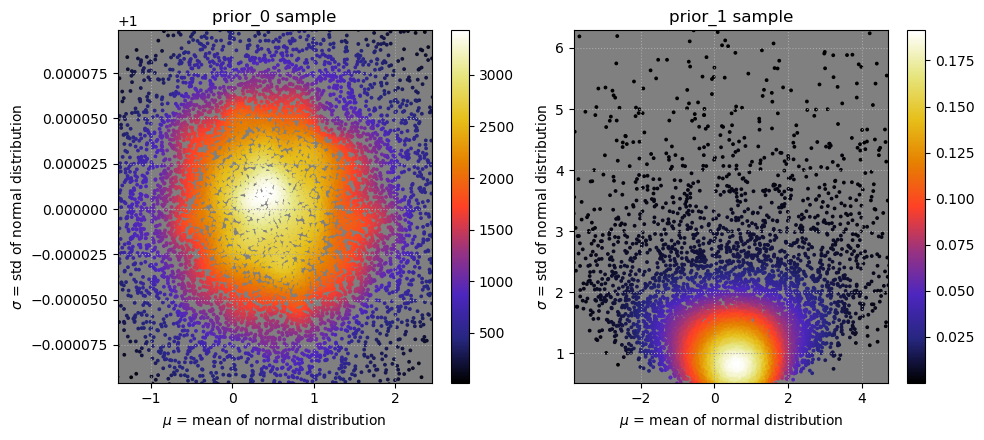

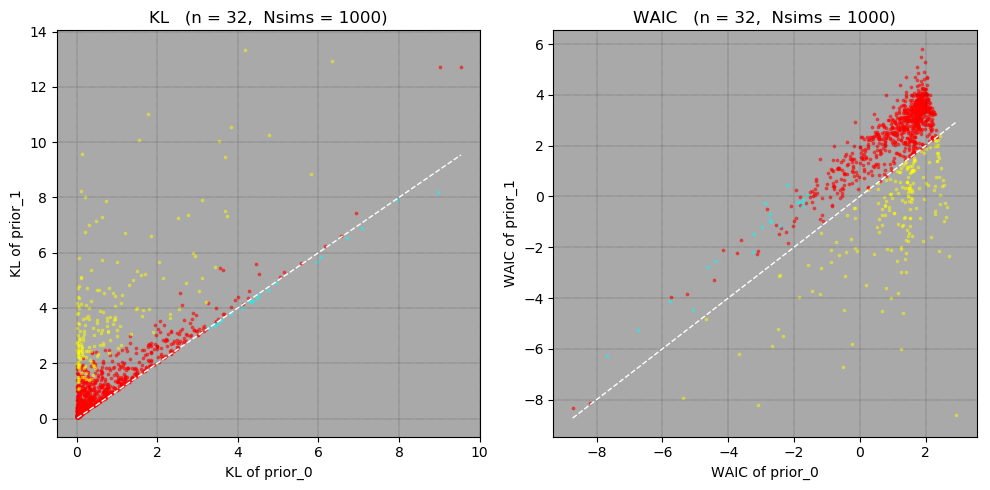

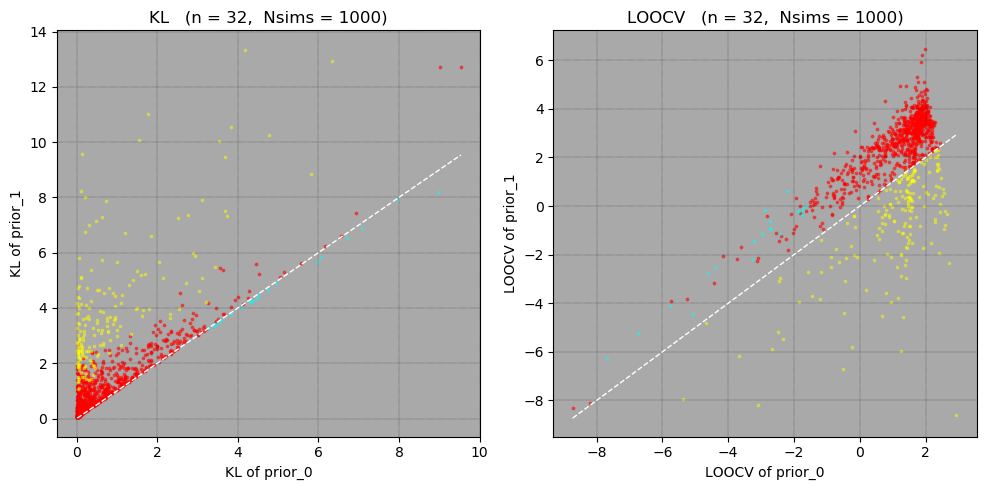

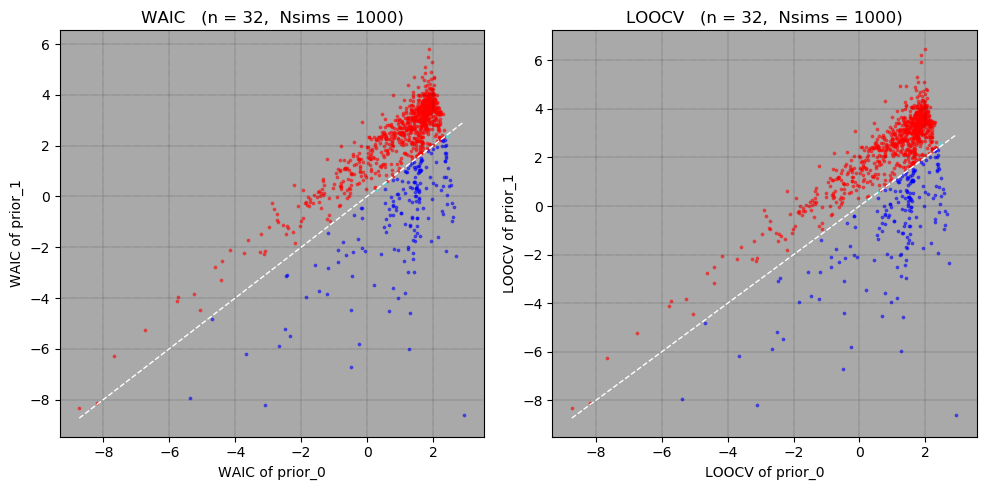

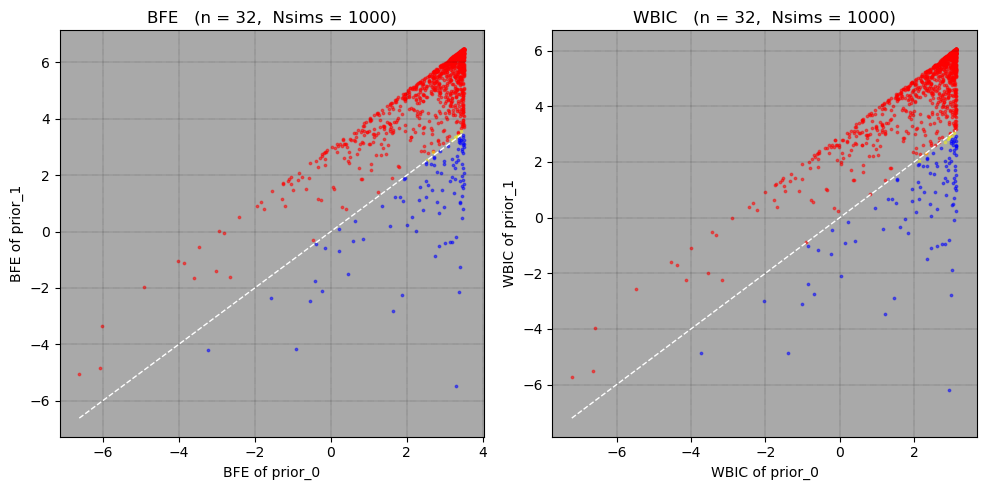

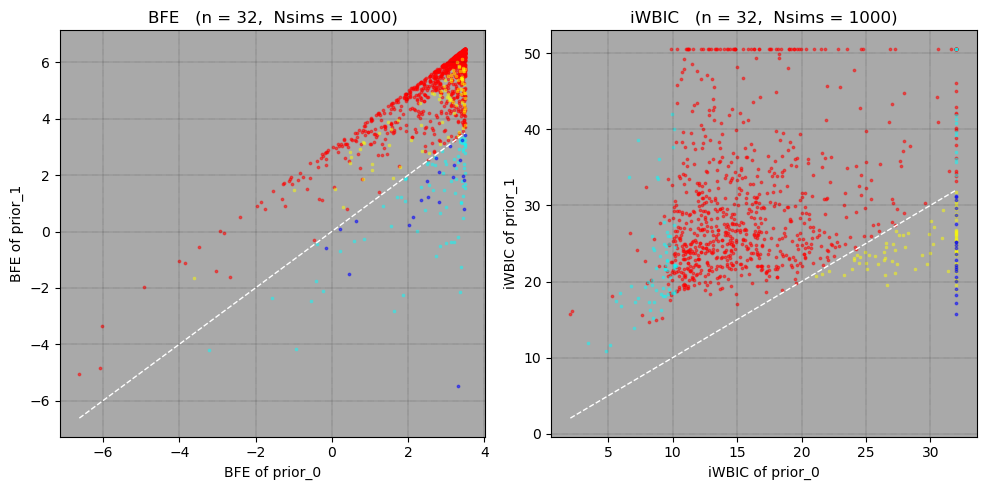

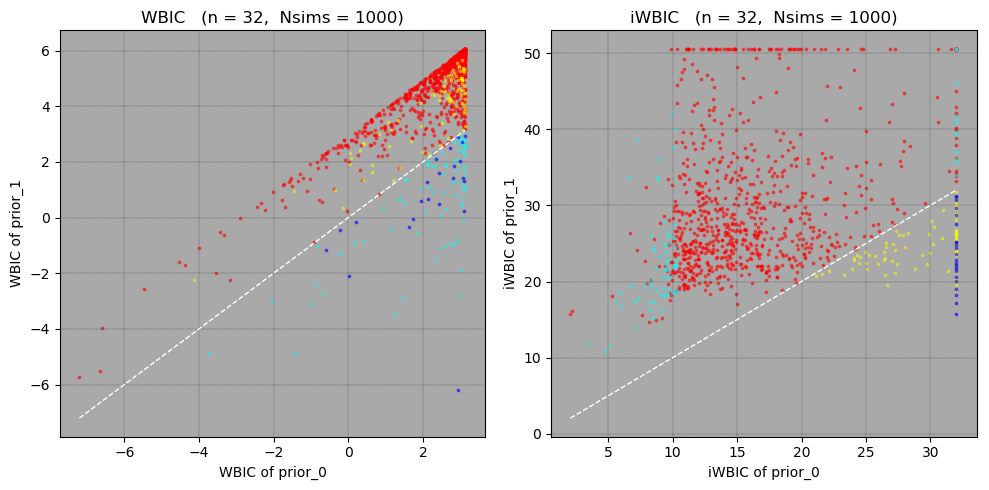

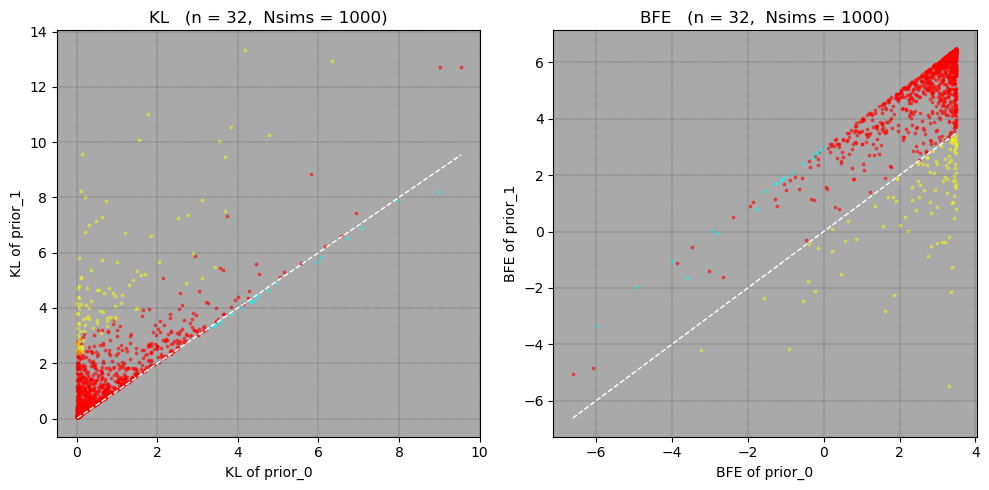

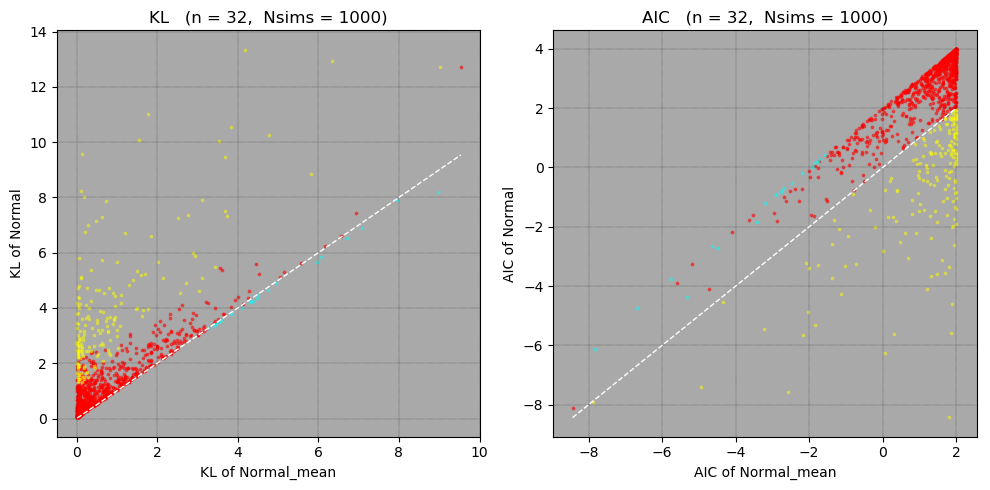

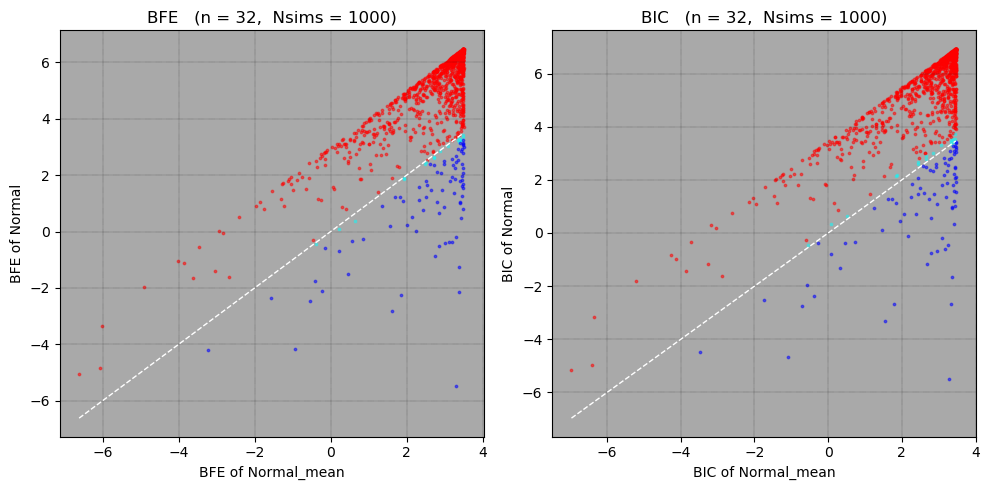

  3.508699 seconds (7.52 M allocations: 353.824 MiB, 3.17% gc time)


In [26]:
function simcomparison(dist_true, n, prior0, prior1; β₀=1.0, β₁=1.0, Nsims = 10^3)
    X = Array{Float64, 1}(undef, n)
    Samples = Array{Array{Float64, 1}, 1}(undef, Nsims)
    Ttrues  = Array{Float64, 1}(undef, Nsims)
    KL0s     = Array{Float64, 1}(undef, Nsims)
    KL1s     = Array{Float64, 1}(undef, Nsims)
    WAIC0s   = Array{Float64, 1}(undef, Nsims)
    WAIC1s   = Array{Float64, 1}(undef, Nsims)
    LOOCV0s  = Array{Float64, 1}(undef, Nsims)
    LOOCV1s  = Array{Float64, 1}(undef, Nsims)
    BFE0s    = Array{Float64, 1}(undef, Nsims)
    BFE1s    = Array{Float64, 1}(undef, Nsims)
    WBIC0s   = Array{Float64, 1}(undef, Nsims)
    WBIC1s   = Array{Float64, 1}(undef, Nsims)
    iWBIC0s  = Array{Float64, 1}(undef, Nsims)
    iWBIC1s  = Array{Float64, 1}(undef, Nsims)
    AICs     = Array{Float64, 1}(undef, Nsims)
    AICms    = Array{Float64, 1}(undef, Nsims)
    AICss    = Array{Float64, 1}(undef, Nsims)
    BICs     = Array{Float64, 1}(undef, Nsims)
    BICms    = Array{Float64, 1}(undef, Nsims)
    BICss    = Array{Float64, 1}(undef, Nsims)
    for k in 1:Nsims
        X = rand(dist_true, n)
        Samples[k] = X
        Ttrues[k]  = 2*TrainingLoss(dist_true, X)

        posterior0  = BayesianUpdate(prior0, X, β₀)
        posterior1  = BayesianUpdate(prior1, X, β₁)
        predictive0 = PredNormal(posterior0)
        predictive1 = PredNormal(posterior1)
        
        KL0s[k]     = 2n*KullbackLeibler(dist_true, predictive0)
        KL1s[k]     = 2n*KullbackLeibler(dist_true, predictive1)
        
        WAIC0s[k]   = WAIC(prior0, X, β₀) - Ttrues[k]
        WAIC1s[k]   = WAIC(prior1, X, β₁) - Ttrues[k]
        LOOCV0s[k]  = LOOCV(prior0, X, β₀) - Ttrues[k]
        LOOCV1s[k]  = LOOCV(prior1, X, β₁) - Ttrues[k]
        BFE0s[k]    = BayesianFreeEnergy(prior0, X, β₀) - Ttrues[k]
        BFE1s[k]    = BayesianFreeEnergy(prior1, X, β₁) - Ttrues[k]
        WBIC0s[k]   = WBIC(prior0, X, β₀) - Ttrues[k]
        WBIC1s[k]   = WBIC(prior1, X, β₁) - Ttrues[k]
        iWBIC0s[k]  = improved_WBIC(prior0, X, β₀) - Ttrues[k]
        iWBIC1s[k]  = improved_WBIC(prior1, X, β₁) - Ttrues[k]
        
        AICs[k]     = AIC_Normal(X) - Ttrues[k]
        AICms[k]    = AIC_Normal_mean(X) - Ttrues[k]
        AICss[k]    = AIC_Normal_sigma(X) - Ttrues[k]
        BICs[k]     = BIC_Normal(X) - Ttrues[k]
        BICms[k]    = BIC_Normal_mean(X) - Ttrues[k]
        BICss[k]    = BIC_Normal_sigma(X) - Ttrues[k]
    end
    return Samples, Ttrues, 
        KL0s, KL1s, WAIC0s, WAIC1s, LOOCV0s, LOOCV1s,
        BFE0s, BFE1s, WBIC0s, WBIC1s, iWBIC0s, iWBIC1s,
        AICs, AICms, AICss, BICs, BICms, BICss
end

function show2x2(criterionA::String, criterionB::String;
        prior0="prior_0", prior1="prior_1", a0s="0s", a1s="1s", b0s="0s", b1s="1s")
    A0 = eval(Symbol(criterionA, a0s))
    A1 = eval(Symbol(criterionA, a1s))
    B0 = eval(Symbol(criterionB, b0s))
    B1 = eval(Symbol(criterionB, b1s))
    count00 = count((A0 .< A1) .& (B0 .< B1))
    count01 = count((A0 .< A1) .& (B0 .≥ B1))
    count10 = count((A0 .> A1) .& (B0 .≤ B1))
    count11 = count((A0 .> A1) .& (B0 .> B1))

    println("="^60)
    @printf("%11s %11s|%-11s  selects   |\n", "", "", criterionB)
    @printf("%11s %11s|-----------+-----------+\n", "", "")
    @printf("%11s %11s|%11s|%11s|\n", "", "", prior0, prior1)
    println("-----------+-----------+-----------+-----------+----------")
    @printf("%-11s|%11s|   %5d   |   %5d   |   %5d\n", criterionA,    prior0, count00, count01, count00+count01)
    @printf( "%11s|%11s|   %5d   |   %5d   |   %5d\n", "   selects",  prior1, count10, count11, count10+count11)
    println("-----------+-----------+-----------+-----------+----------")
    @printf("%11s %11s|   %5d   |   %5d   |   %5d\n", "", "", count00+count10, count01+count11, length(A0))
    println("="^60)
end

function plotcomparisonby(criterionA::String, criterionB::String, fig1, fig2;
        prior0="prior_0", prior1="prior_1", a0s="0s", a1s="1s", b0s="0s", b1s="1s")
    A0 = eval(Symbol(criterionA, a0s))
    A1 = eval(Symbol(criterionA, a1s))
    B0 = eval(Symbol(criterionB, b0s))
    B1 = eval(Symbol(criterionB, b1s))

    A0_A0B0 = A0[(A0 .< A1) .& (B0 .< B1)]
    A0_A0B1 = A0[(A0 .< A1) .& (B0 .> B1)]
    A0_A1B0 = A0[(A0 .> A1) .& (B0 .< B1)]
    A0_A1B1 = A0[(A0 .> A1) .& (B0 .> B1)]
    A1_A0B0 = A1[(A0 .< A1) .& (B0 .< B1)]
    A1_A0B1 = A1[(A0 .< A1) .& (B0 .> B1)]
    A1_A1B0 = A1[(A0 .> A1) .& (B0 .< B1)]
    A1_A1B1 = A1[(A0 .> A1) .& (B0 .> B1)]

    B0_A0B0 = B0[(A0 .< A1) .& (B0 .< B1)]
    B0_A0B1 = B0[(A0 .< A1) .& (B0 .> B1)]
    B0_A1B0 = B0[(A0 .> A1) .& (B0 .< B1)]
    B0_A1B1 = B0[(A0 .> A1) .& (B0 .> B1)]
    B1_A0B0 = B1[(A0 .< A1) .& (B0 .< B1)]
    B1_A0B1 = B1[(A0 .< A1) .& (B0 .> B1)]
    B1_A1B0 = B1[(A0 .> A1) .& (B0 .< B1)]
    B1_A1B1 = B1[(A0 .> A1) .& (B0 .> B1)]

    fig1[:set_facecolor]("darkgray")
    fig1[:scatter](A0_A0B0, A1_A0B0, s=3, color="red", alpha=0.5)
    fig1[:scatter](A0_A0B1, A1_A0B1, s=3, color="yellow", alpha=0.5, marker="x")
    fig1[:scatter](A0_A1B0, A1_A1B0, s=3, color="cyan", alpha=0.5, marker="x")
    fig1[:scatter](A0_A1B1, A1_A1B1, s=3, color="blue", alpha=0.5)
    fig1[:set_xlabel]("$criterionA of $prior0")
    fig1[:set_ylabel]("$criterionA of $prior1")
    fig1[:set_title]("$criterionA   (n = $n,  Nsims = $Nsims)")
    x = [minimum(A0), maximum(A0)]
    fig1[:plot](x, x, ls="--", color="white", lw=1)
    fig1[:grid](ls=":", color="black", lw=0.3)

    fig2[:set_facecolor]("darkgray")
    fig2[:scatter](B0_A0B0, B1_A0B0, s=3, color="red", alpha=0.5)
    fig2[:scatter](B0_A0B1, B1_A0B1, s=3, color="yellow", alpha=0.5, marker="x")
    fig2[:scatter](B0_A1B0, B1_A1B0, s=3, color="cyan", alpha=0.5, marker="x")
    fig2[:scatter](B0_A1B1, B1_A1B1, s=3, color="blue", alpha=0.5)
    fig2[:set_xlabel]("$criterionB of $prior0")
    fig2[:set_ylabel]("$criterionB of $prior1")
    fig2[:set_title]("$criterionB   (n = $n,  Nsims = $Nsims)")
    x = [minimum(B0), maximum(B0)]
    fig2[:plot](x, x, ls="--", color="white", lw=1)
    fig2[:grid](ls=":", color="black", lw=0.3)
end

function plotcomparisonby(criterionA::String, criterionB::String;
        prior0="prior_0", prior1="prior_1", a0s="0s", a1s="1s", b0s="0s", b1s="1s")
    plt.figure(figsize=(10,5))
    fig1=plt.subplot(121)
    fig2=plt.subplot(122)
    plotcomparisonby(criterionA, criterionB, fig1, fig2,
        prior0=prior0, prior1=prior1, a0s=a0s, a1s=a1s, b0s=b0s, b1s=b1s)
    plt.tight_layout()
end

function show_everything(dist_true, n, prior0, prior1; Nsims=10^3)
    global Samples, Ttrues, 
    KL0s, KL1s, WAIC0s, WAIC1s, LOOCV0s, LOOCV1s,
    BFE0s, BFE1s, WBIC0s, WBIC1s, iWBIC0s, iWBIC1s, 
    AICs, AICms, AICss, BICs, BICms, BICss
    
    Samples, Ttrues, 
    KL0s, KL1s, WAIC0s, WAIC1s, LOOCV0s, LOOCV1s,
    BFE0s, BFE1s, WBIC0s, WBIC1s, iWBIC0s, iWBIC1s,
    AICs, AICms, AICss, BICs, BICms, BICss = 
        simcomparison(dist_true, n, prior0, prior1, Nsims=Nsims)

    @show count(KL0s .< KL1s)/Nsims
    @show count(WAIC0s .< WAIC1s)/Nsims
    @show count(LOOCV0s .< LOOCV1s)/Nsims
    @show count(AICms .< AICs)/Nsims
    @show count(AICss .< AICs)/Nsims
    
    println()
    
    @show count(BFE0s .< BFE1s)/Nsims
    @show count(WBIC0s .< WBIC1s)/Nsims
    @show count(iWBIC0s .< iWBIC1s)/Nsims
    @show count(BICms .< BICs)/Nsims
    @show count(BICss .< BICs)/Nsims

    println()

    @show cor(KL1s-KL0s, WAIC1s-WAIC0s)
    @show cor(KL1s-KL0s, LOOCV1s-LOOCV0s)
    @show cor(WAIC1s-WAIC0s, LOOCV1s-LOOCV0s)
    @show mean(KL1s-KL0s), std(KL1s-KL0s)
    @show mean(WAIC1s-WAIC0s), std(WAIC1s-WAIC0s)
    @show mean(LOOCV1s-LOOCV0s), std(LOOCV1s-LOOCV0s)

    println()

    @show cor(BFE1s-BFE0s, WBIC1s-WBIC0s)
    @show cor(BFE1s-BFE0s, iWBIC1s-iWBIC0s)
    @show cor(WBIC1s-WBIC0s, iWBIC1s-iWBIC0s)
    @show cor(iWBIC1s-iWBIC0s, iWBIC1s-iWBIC0s)
    @show mean(BFE1s-BFE0s), std(BFE1s-BFE0s)
    @show mean(WBIC1s-WBIC0s), std(WBIC1s-WBIC0s)
    @show mean(iWBIC1s-iWBIC0s), std(iWBIC1s-iWBIC0s)

    println()
    show2x2("KL", "WAIC")
    show2x2("KL", "LOOCV")
    show2x2("WAIC", "LOOCV")
    show2x2("BFE", "WBIC")
    show2x2("BFE", "iWBIC")
    show2x2("WBIC", "iWBIC")
    show2x2("KL", "BFE")
    show2x2("KL",  "AIC", prior0="Normal_mean", prior1="Normal", b0s="ms", b1s="s")
    show2x2("BFE", "BIC", prior0="Normal_mean", prior1="Normal", b0s="ms", b1s="s")
    
    sleep(0.1)

    plotP01(prior0, prior1)
    plotcomparisonby("KL", "WAIC")
    plotcomparisonby("KL", "LOOCV")
    plotcomparisonby("WAIC", "LOOCV")
    plotcomparisonby("BFE", "WBIC")
    plotcomparisonby("BFE", "iWBIC")
    plotcomparisonby("WBIC", "iWBIC")
    plotcomparisonby("KL", "BFE")
    plotcomparisonby("KL",  "AIC", prior0="Normal_mean", prior1="Normal", b0s="ms", b1s="s")
    plotcomparisonby("BFE", "BIC", prior0="Normal_mean", prior1="Normal", b0s="ms", b1s="s")
end

########## Test

@show Nsims = 1000
@show μ₀, μ_λ = 0.5, 1.0
@show dist_true = Normal(μ₀, 1/sqrt(μ_λ))
@show n = 2^5
@show prior0 = NormalGamma(μ₀, 1.0, 1e8, μ_λ/1e8) # Nearly λ=μ_λ
@show prior1 = NormalGamma(μ₀, 1.0, 1.0, μ_λ/1.0)
println()
@time show_everything(dist_true, n, prior0, prior1, Nsims=Nsims);

Nsims = 10000 = 10000
(μ₀, μ_λ) = (0.5, 1.0) = (0.5, 1.0)
dist_true = Normal(μ₀, 1 / sqrt(μ_λ)) = Normal{Float64}(μ=0.5, σ=1.0)
n = 2 ^ 10 = 1024
prior0 = NormalGamma(μ₀, 1.0, 1.0e8, μ_λ / 1.0e8) = NormalGamma{Float64}(μ₀=0.5, λ₀=1.0, α=1.0e8, θ=1.0e-8)
prior1 = NormalGamma(μ₀, 1.0, 1.0, μ_λ / 1.0) = NormalGamma{Float64}(μ₀=0.5, λ₀=1.0, α=1.0, θ=1.0)

count(KL0s .< KL1s) / Nsims = 0.9949
count(WAIC0s .< WAIC1s) / Nsims = 0.8409
count(LOOCV0s .< LOOCV1s) / Nsims = 0.8409
count(AICms .< AICs) / Nsims = 0.8419
count(AICss .< AICs) / Nsims = 0.0

count(BFE0s .< BFE1s) / Nsims = 0.988
count(WBIC0s .< WBIC1s) / Nsims = 0.9905
count(iWBIC0s .< iWBIC1s) / Nsims = 0.9995
count(BICms .< BICs) / Nsims = 0.9907
count(BICss .< BICs) / Nsims = 0.0

cor(KL1s - KL0s, WAIC1s - WAIC0s) = -0.9959611017218513
cor(KL1s - KL0s, LOOCV1s - LOOCV0s) = -0.9959603688567903
cor(WAIC1s - WAIC0s, LOOCV1s - LOOCV0s) = 0.9999999842821626
(mean(KL1s - KL0s), std(KL1s - KL0s)) = (1.0006411586928647, 1.4245956806269755)

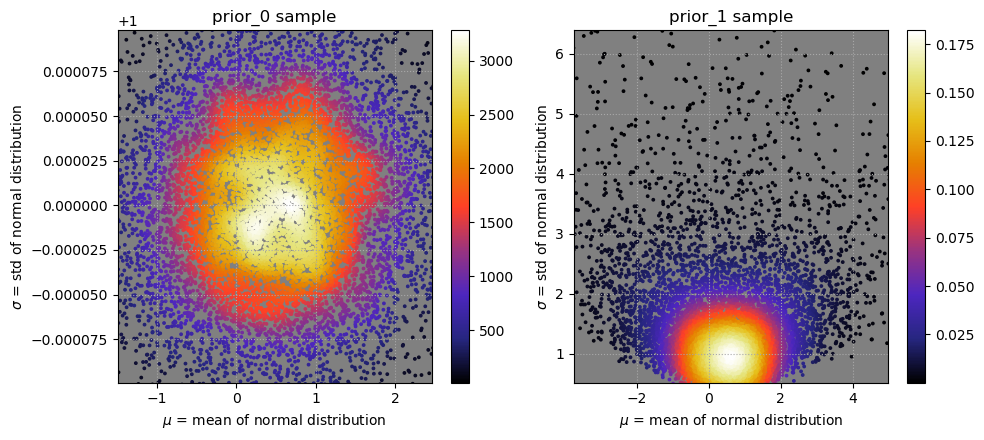

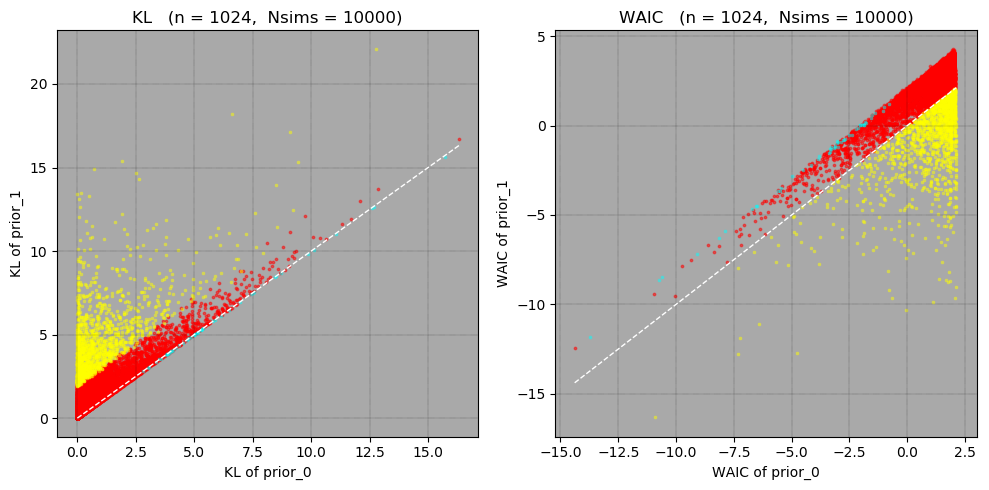

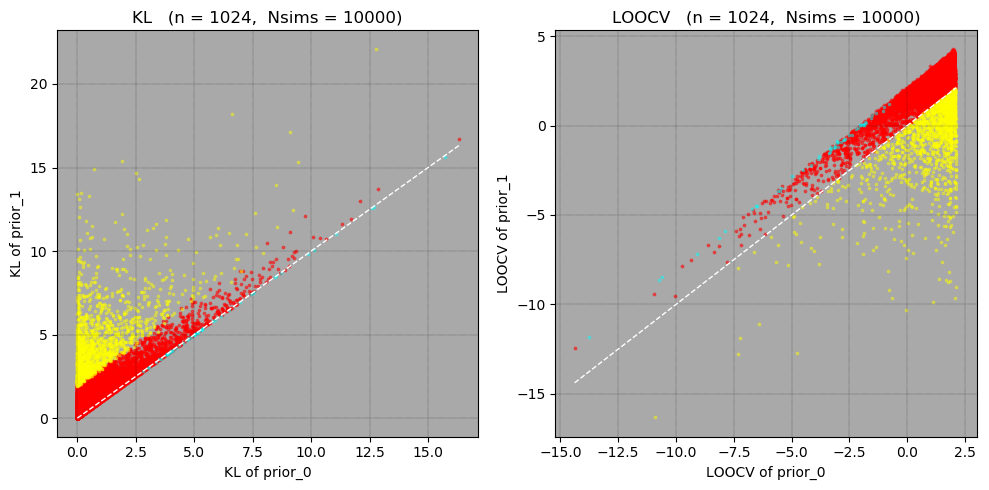

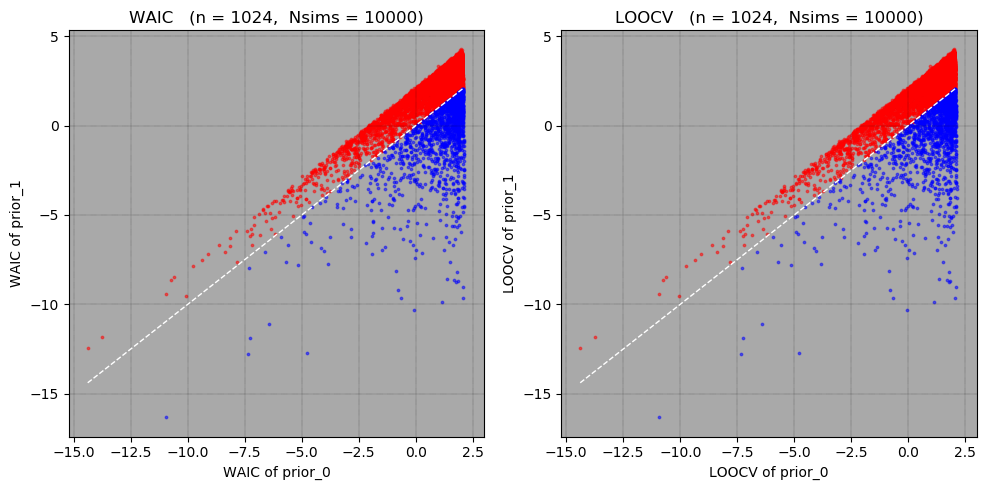

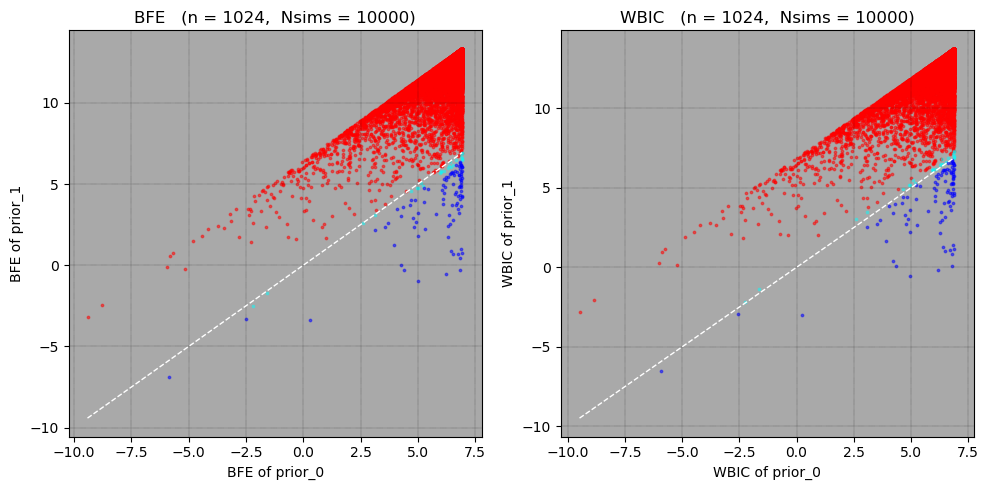

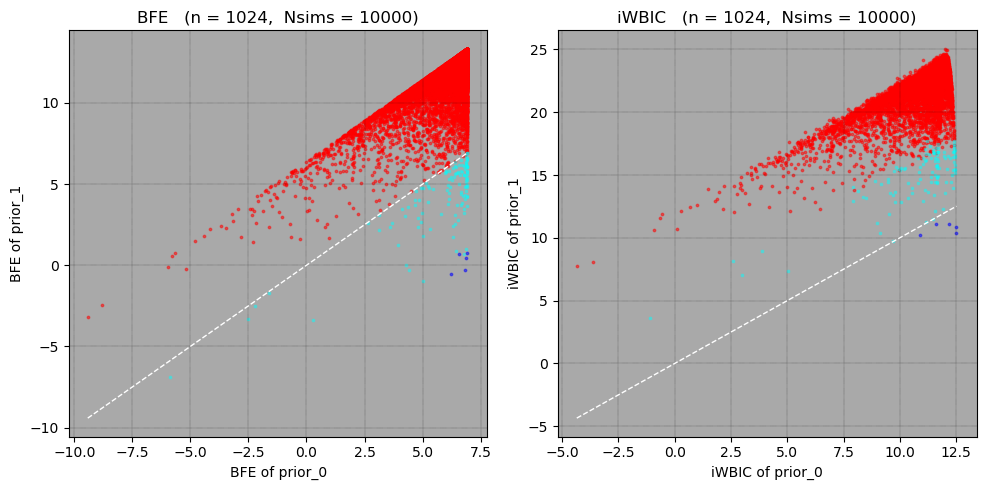

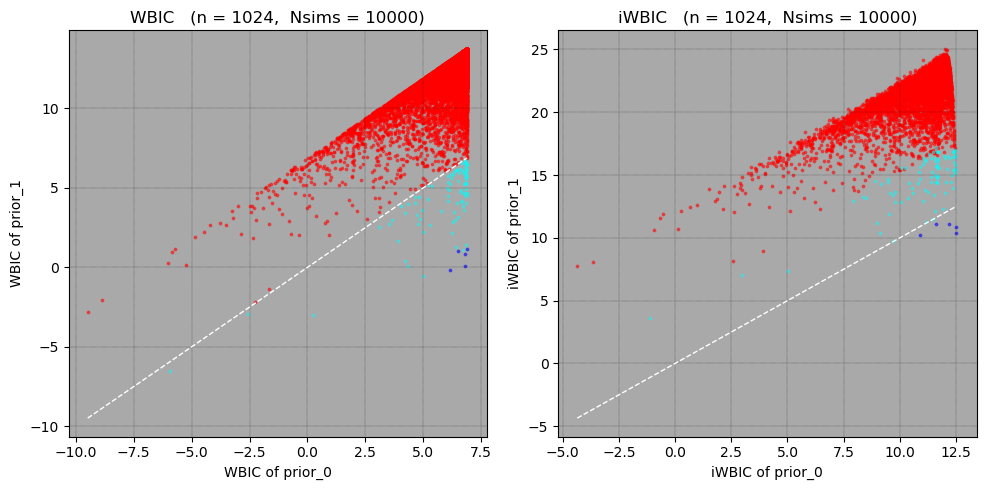

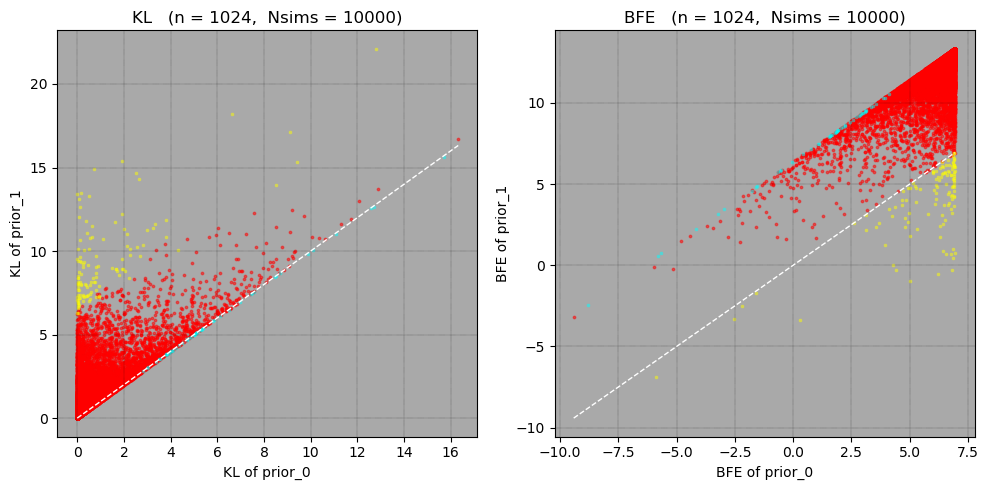

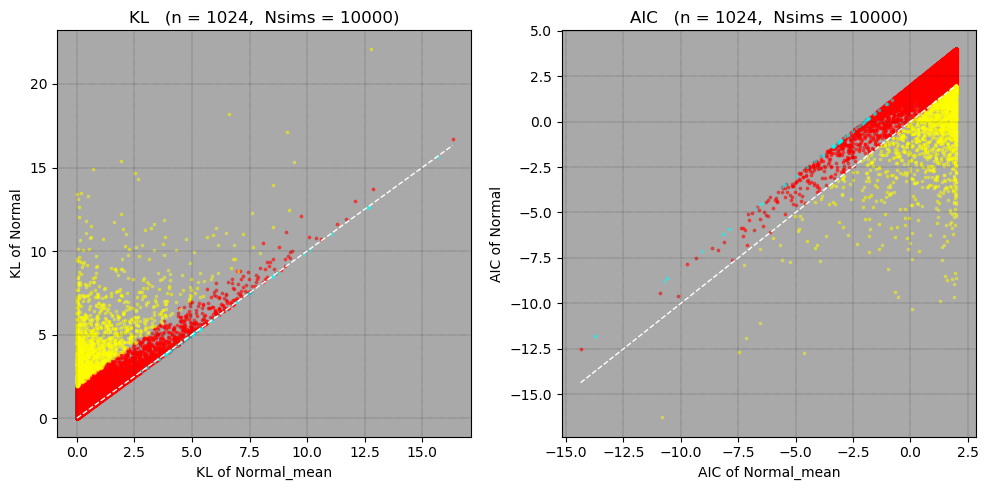

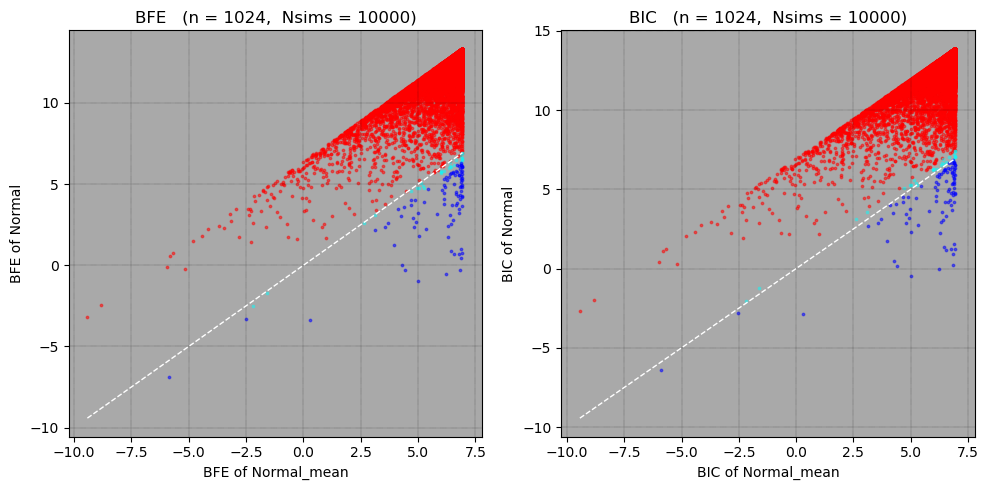

 35.177007 seconds (55.24 M allocations: 4.910 GiB, 2.32% gc time)


In [27]:
@show Nsims = 10000
@show μ₀, μ_λ = 0.5, 1.0
@show dist_true = Normal(μ₀, 1/sqrt(μ_λ))
@show n = 2^10
@show prior0 = NormalGamma(μ₀, 1.0, 1e8, μ_λ/1e8) # Nearly λ=μ_λ
@show prior1 = NormalGamma(μ₀, 1.0, 1.0, μ_λ/1.0)
println()
@time show_everything(dist_true, n, prior0, prior1, Nsims=Nsims);

Nsims = 1000 = 1000
(μ₀, μ_λ) = (0.5, 1.0) = (0.5, 1.0)
dist_true = Normal(μ₀, 1 / sqrt(μ_λ - 0.5)) = Normal{Float64}(μ=0.5, σ=1.414213562373095)
n = 2 ^ 5 = 32
prior0 = NormalGamma(μ₀, 1.0, 1.0e8, μ_λ / 1.0e8) = NormalGamma{Float64}(μ₀=0.5, λ₀=1.0, α=1.0e8, θ=1.0e-8)
prior1 = NormalGamma(μ₀, 1.0, 1.0, μ_λ / 1.0) = NormalGamma{Float64}(μ₀=0.5, λ₀=1.0, α=1.0, θ=1.0)

count(KL0s .< KL1s) / Nsims = 0.008
count(WAIC0s .< WAIC1s) / Nsims = 0.121
count(LOOCV0s .< LOOCV1s) / Nsims = 0.125
count(AICms .< AICs) / Nsims = 0.15
count(AICss .< AICs) / Nsims = 0.288

count(BFE0s .< BFE1s) / Nsims = 0.213
count(WBIC0s .< WBIC1s) / Nsims = 0.207
count(iWBIC0s .< iWBIC1s) / Nsims = 0.285
count(BICms .< BICs) / Nsims = 0.235
count(BICss .< BICs) / Nsims = 0.464

cor(KL1s - KL0s, WAIC1s - WAIC0s) = 0.11043386777987138
cor(KL1s - KL0s, LOOCV1s - LOOCV0s) = 0.11012013745081929
cor(WAIC1s - WAIC0s, LOOCV1s - LOOCV0s) = 0.999975534303916
(mean(KL1s - KL0s), std(KL1s - KL0s)) = (-8.619831358374753, 2.1977668

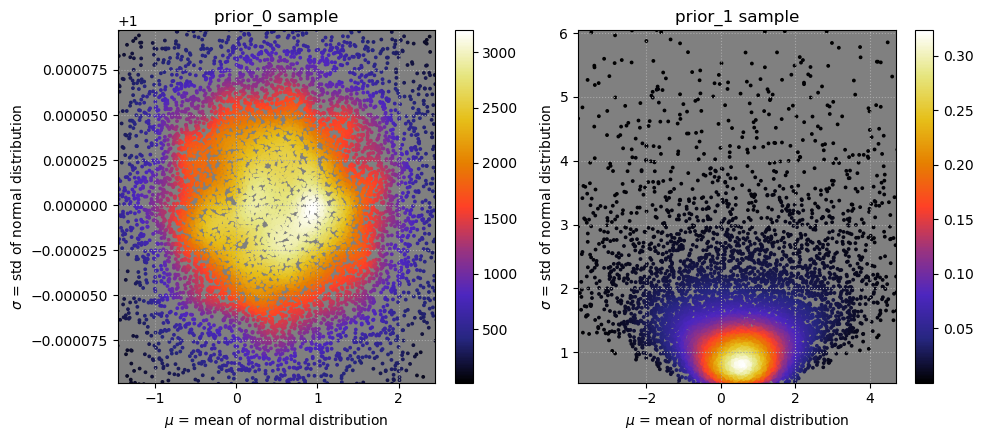

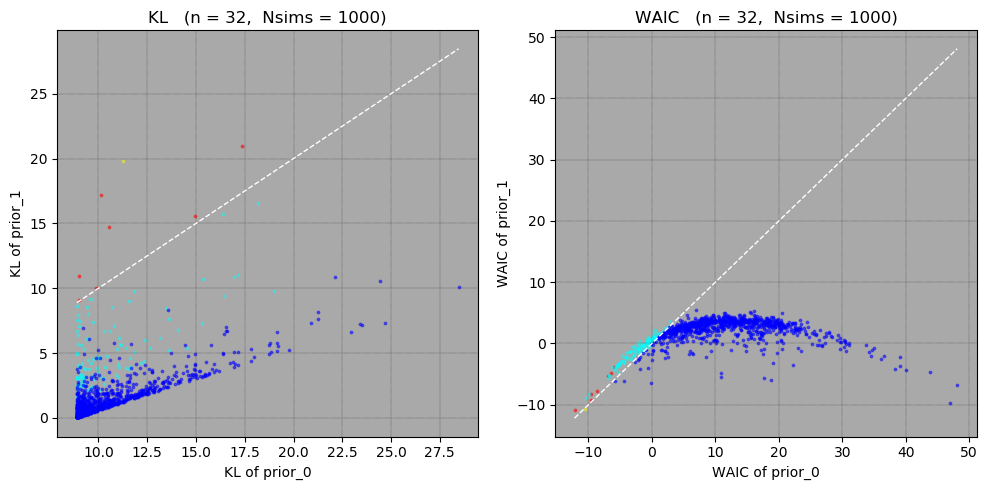

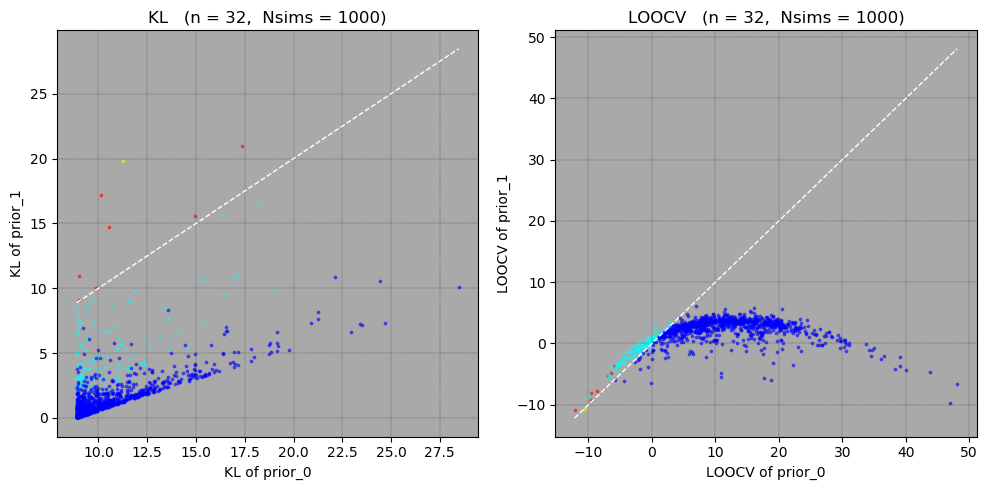

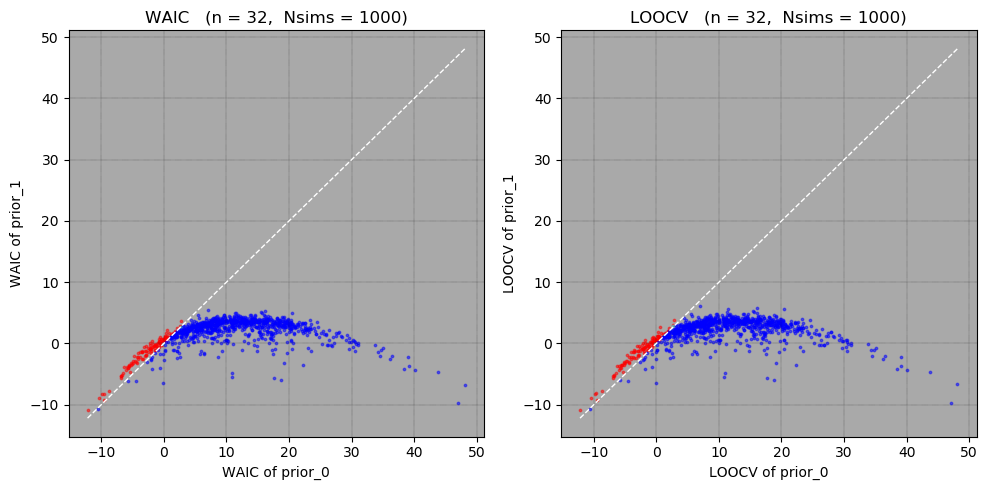

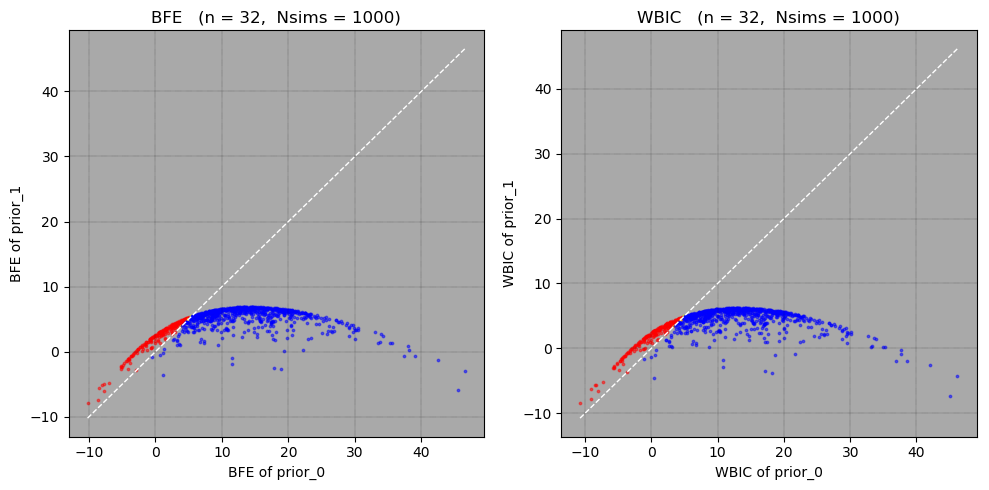

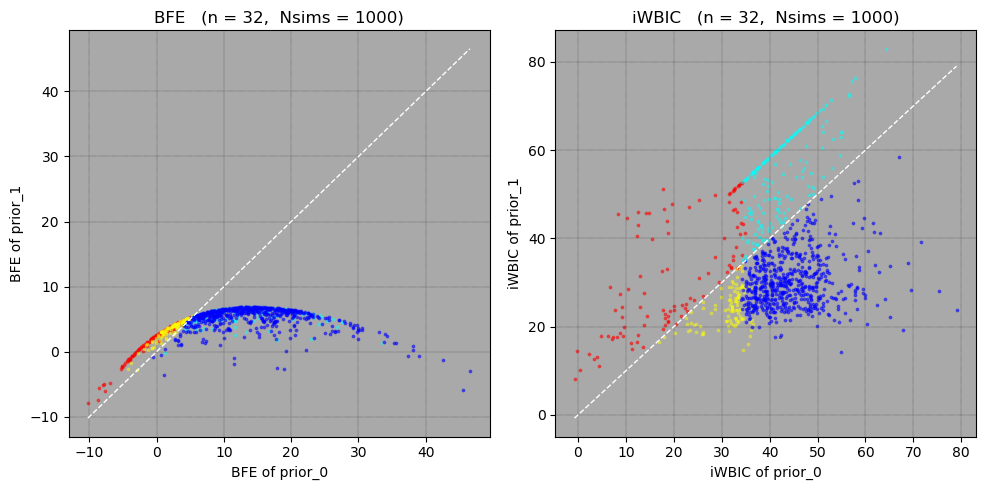

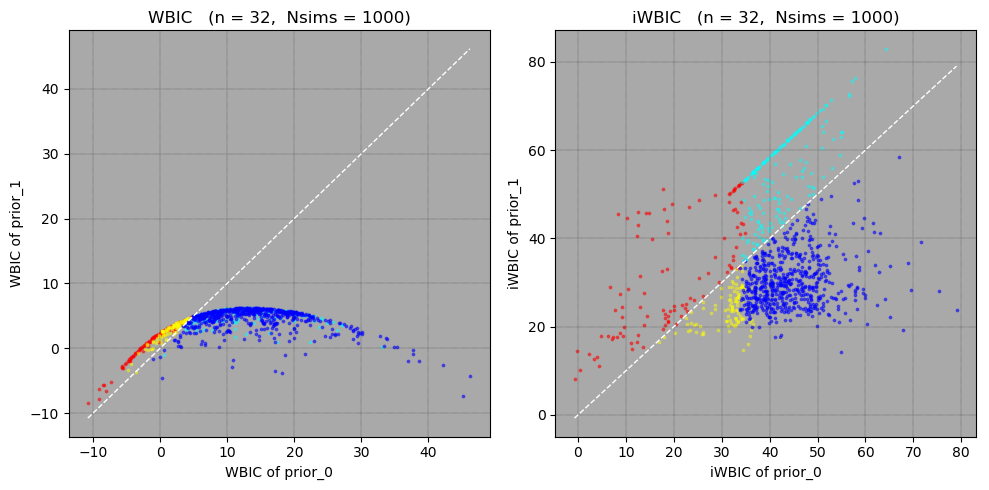

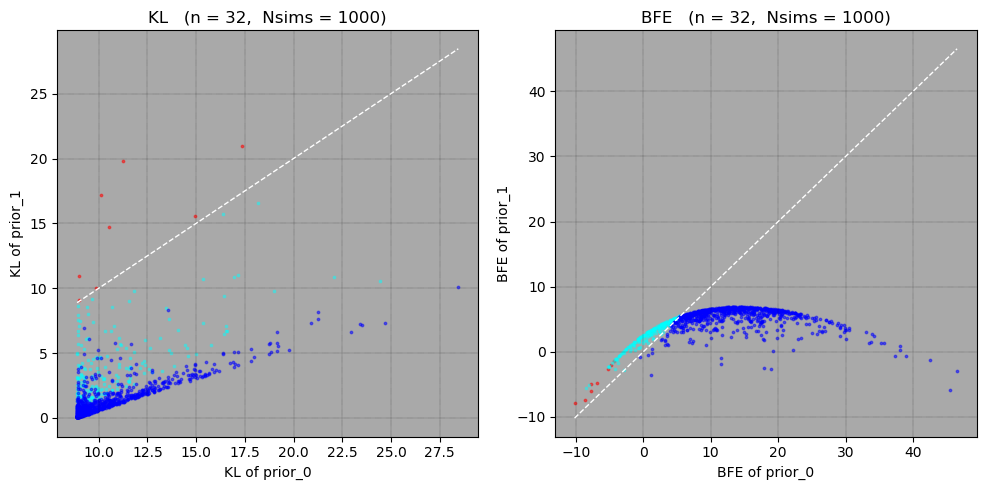

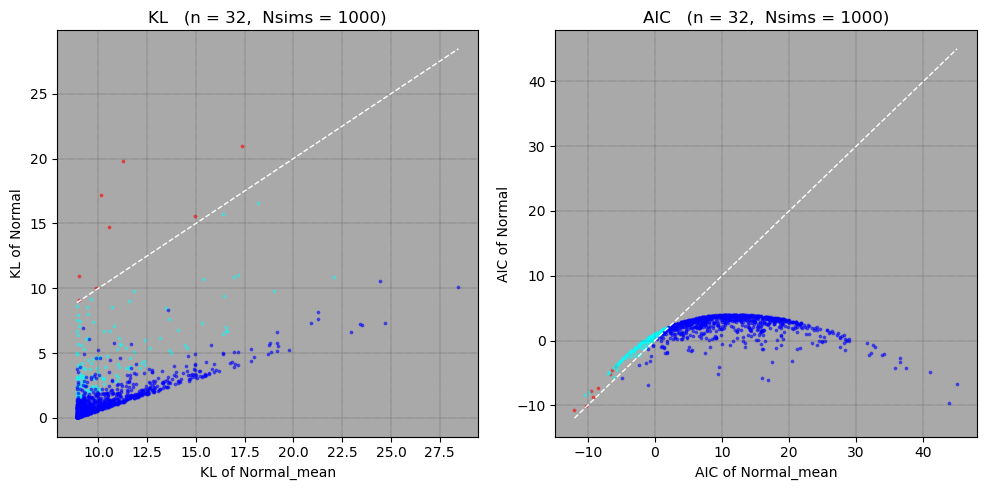

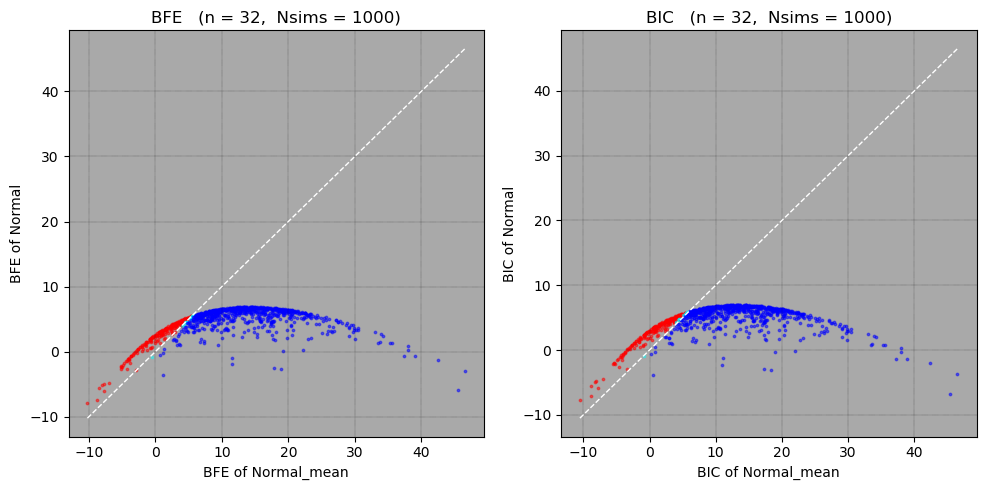

  1.455351 seconds (1.41 M allocations: 57.274 MiB, 0.85% gc time)


In [28]:
@show Nsims = 1000
@show μ₀, μ_λ = 0.5, 1.0
@show dist_true = Normal(μ₀, 1/sqrt(μ_λ-0.5))
@show n = 2^5
@show prior0 = NormalGamma(μ₀, 1.0, 1e8, μ_λ/1e8) # Nearly λ=μ_λ
@show prior1 = NormalGamma(μ₀, 1.0, 1.0, μ_λ/1.0)
println()
@time show_everything(dist_true, n, prior0, prior1, Nsims=Nsims);

Nsims = 1000 = 1000
(μ₀, μ_λ) = (0.0, 1.5) = (0.0, 1.5)
dist_true = Normal(μ₀, 1 / sqrt(μ_λ)) = Normal{Float64}(μ=0.0, σ=0.8164965809277261)
n = 2 ^ 5 = 32
prior0 = NormalGamma(μ₀, 1.0e8, 1.0, μ_λ / 1.0) = NormalGamma{Float64}(μ₀=0.0, λ₀=1.0e8, α=1.0, θ=1.5)
prior1 = NormalGamma(μ₀, 1.0, 1.0, μ_λ / 1.0) = NormalGamma{Float64}(μ₀=0.0, λ₀=1.0, α=1.0, θ=1.5)

count(KL0s .< KL1s) / Nsims = 0.876
count(WAIC0s .< WAIC1s) / Nsims = 0.815
count(LOOCV0s .< LOOCV1s) / Nsims = 0.815
count(AICms .< AICs) / Nsims = 0.366
count(AICss .< AICs) / Nsims = 0.815

count(BFE0s .< BFE1s) / Nsims = 0.923
count(WBIC0s .< WBIC1s) / Nsims = 0.9
count(iWBIC0s .< iWBIC1s) / Nsims = 1.0
count(BICms .< BICs) / Nsims = 0.579
count(BICss .< BICs) / Nsims = 0.916

cor(KL1s - KL0s, WAIC1s - WAIC0s) = -0.9767628794634486
cor(KL1s - KL0s, LOOCV1s - LOOCV0s) = -0.9759543527104668
cor(WAIC1s - WAIC0s, LOOCV1s - LOOCV0s) = 0.9999220283383324
(mean(KL1s - KL0s), std(KL1s - KL0s)) = (1.0201889286045163, 1.4918160024991671)
(

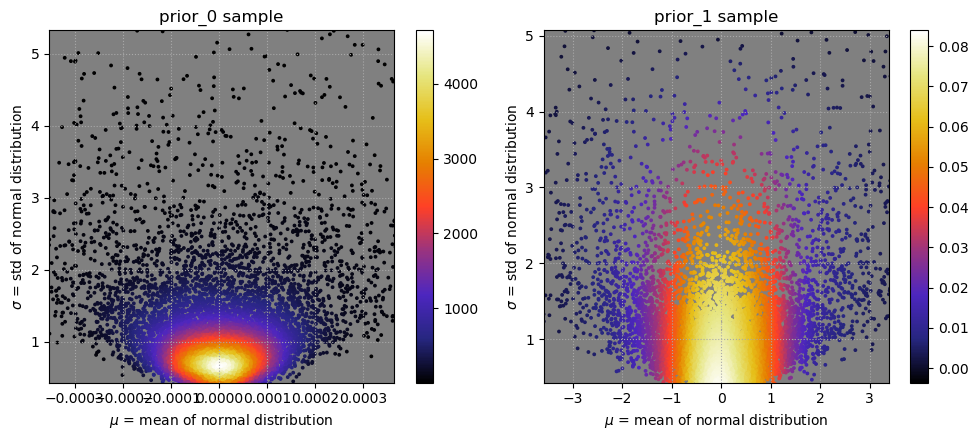

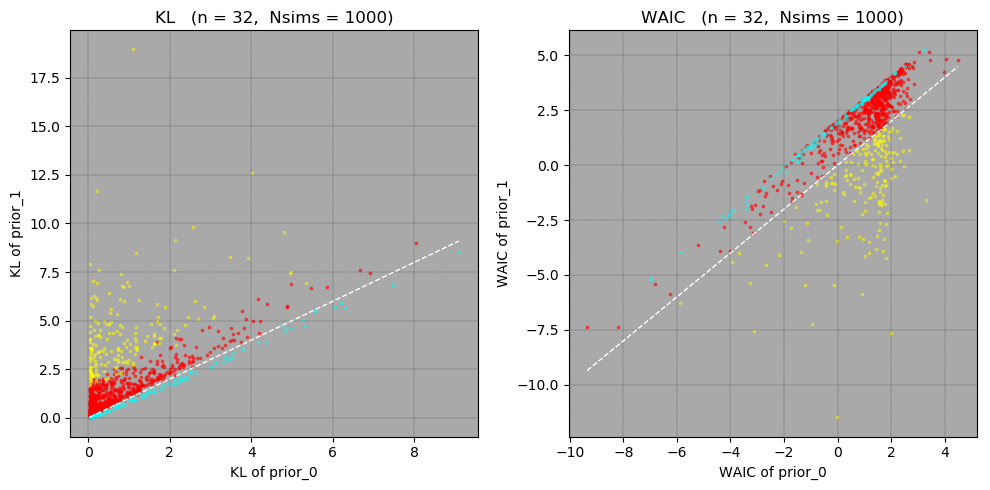

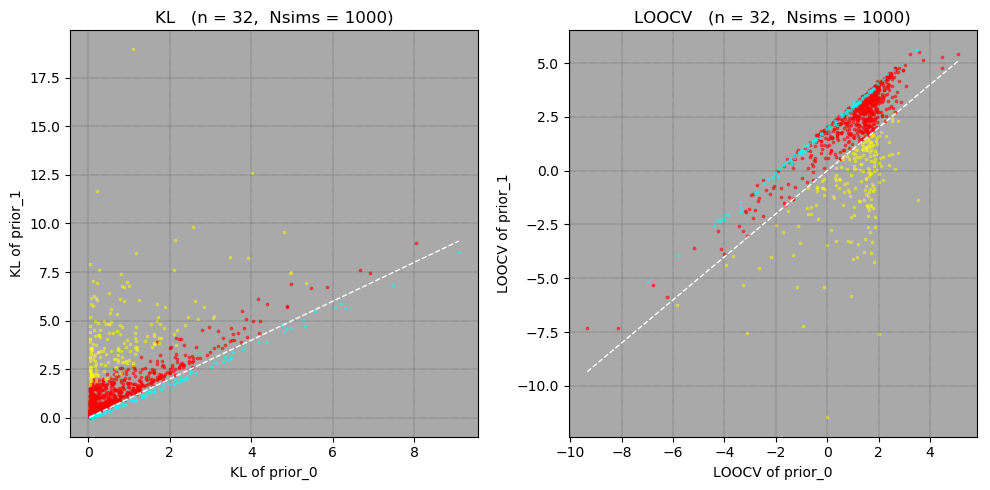

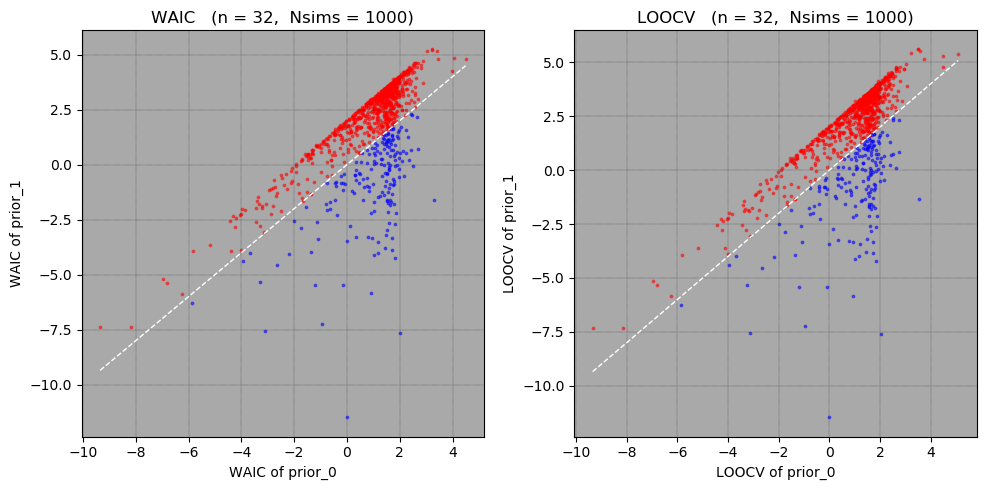

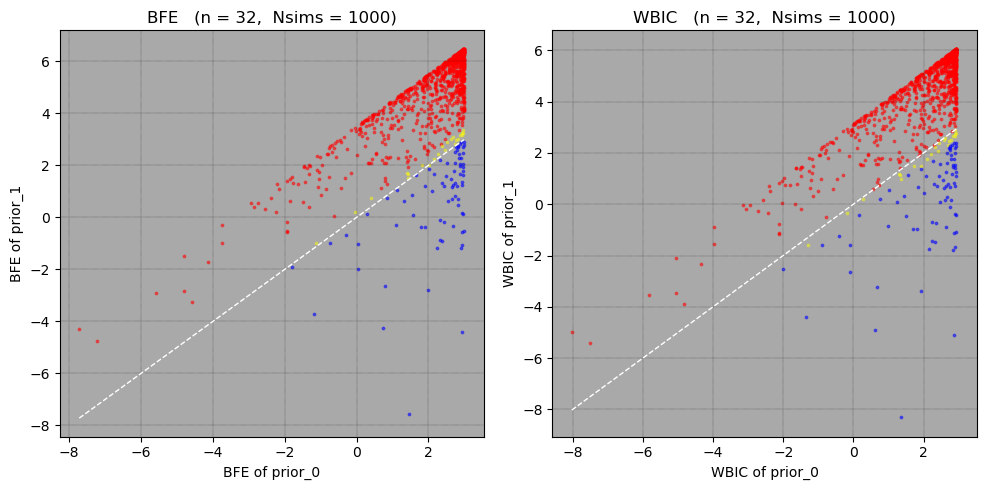

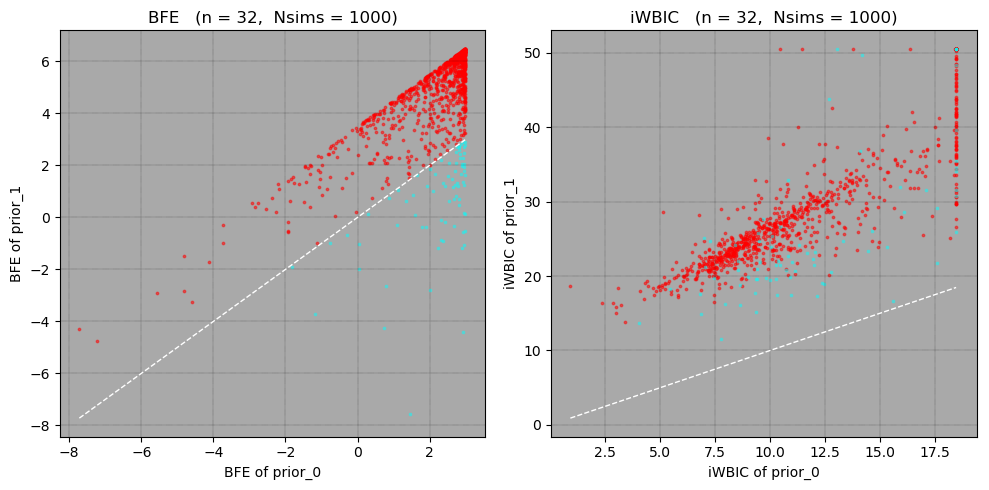

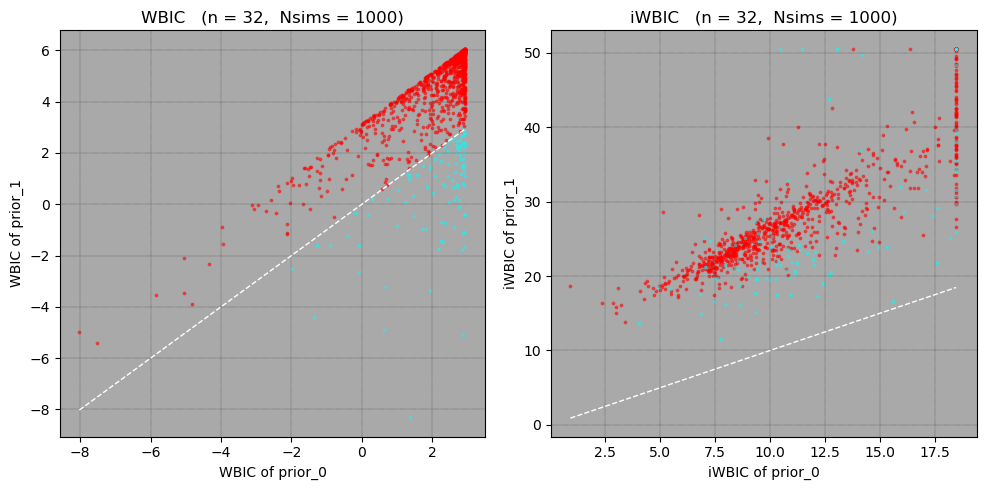

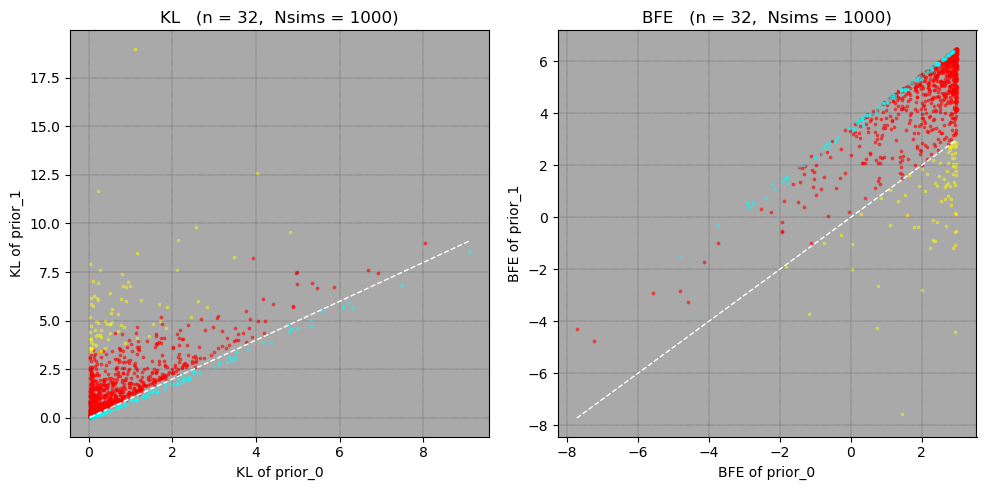

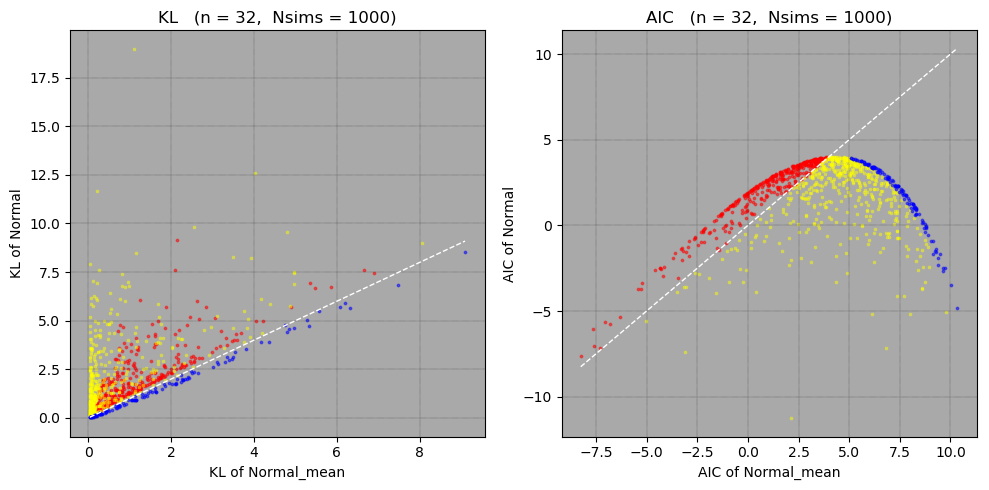

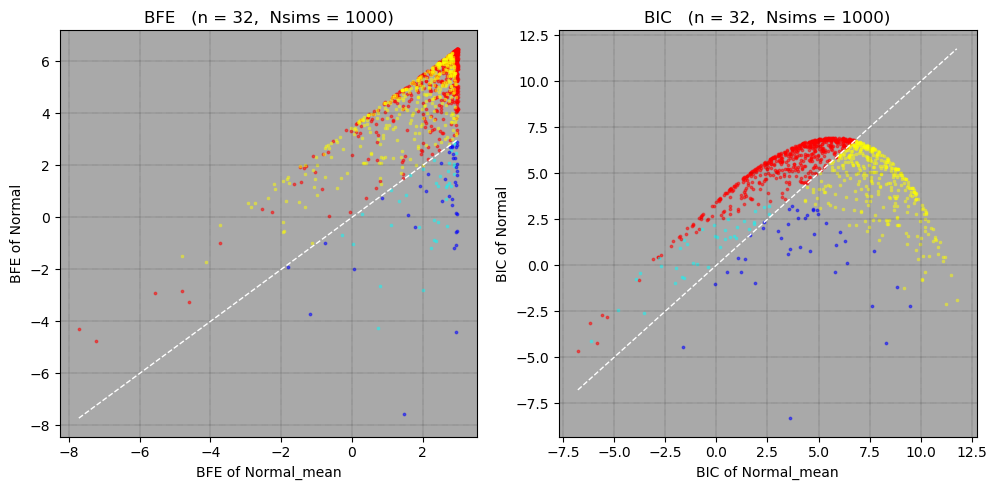

  1.435978 seconds (1.60 M allocations: 61.171 MiB, 0.78% gc time)


In [29]:
@show Nsims = 1000
@show μ₀, μ_λ = 0.0, 1.5
@show dist_true = Normal(μ₀, 1/sqrt(μ_λ))
@show n = 2^5
@show prior0 = NormalGamma(μ₀, 1e8, 1.0, μ_λ/1.0) # Nearly μ=μ₀
@show prior1 = NormalGamma(μ₀, 1.0, 1.0, μ_λ/1.0)
println()
@time show_everything(dist_true, n, prior0, prior1, Nsims=Nsims);

Nsims = 10000 = 10000
(μ₀, μ_λ) = (0.0, 1.5) = (0.0, 1.5)
dist_true = Normal(μ₀, 1 / sqrt(μ_λ)) = Normal{Float64}(μ=0.0, σ=0.8164965809277261)
n = 2 ^ 10 = 1024
prior0 = NormalGamma(μ₀, 1.0e8, 1.0, μ_λ / 1.0) = NormalGamma{Float64}(μ₀=0.0, λ₀=1.0e8, α=1.0, θ=1.5)
prior1 = NormalGamma(μ₀, 1.0, 1.0, μ_λ / 1.0) = NormalGamma{Float64}(μ₀=0.0, λ₀=1.0, α=1.0, θ=1.5)

count(KL0s .< KL1s) / Nsims = 0.9348
count(WAIC0s .< WAIC1s) / Nsims = 0.8435
count(LOOCV0s .< LOOCV1s) / Nsims = 0.8435
count(AICms .< AICs) / Nsims = 0.0
count(AICss .< AICs) / Nsims = 0.8435

count(BFE0s .< BFE1s) / Nsims = 0.99
count(WBIC0s .< WBIC1s) / Nsims = 0.9895
count(iWBIC0s .< iWBIC1s) / Nsims = 0.9998
count(BICms .< BICs) / Nsims = 0.0
count(BICss .< BICs) / Nsims = 0.9899

cor(KL1s - KL0s, WAIC1s - WAIC0s) = -0.9990975283247249
cor(KL1s - KL0s, LOOCV1s - LOOCV0s) = -0.9990975242344285
cor(WAIC1s - WAIC0s, LOOCV1s - LOOCV0s) = 0.9999999999939595
(mean(KL1s - KL0s), std(KL1s - KL0s)) = (1.0027376360742626, 1.43590698

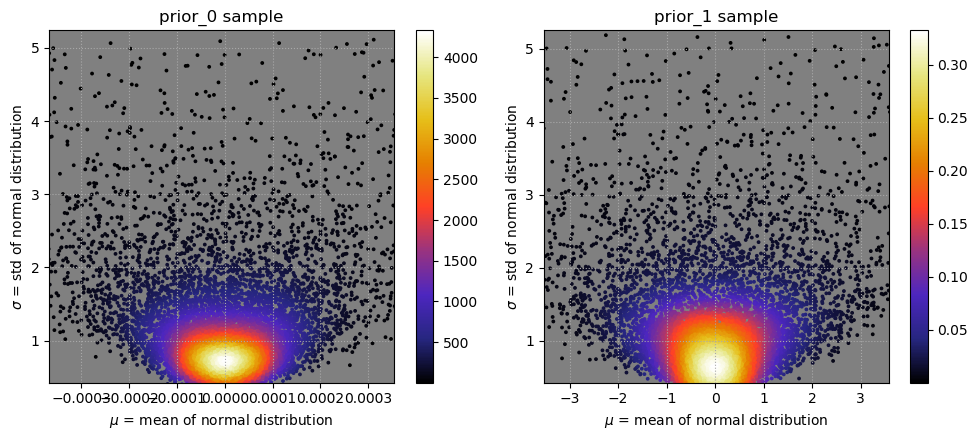

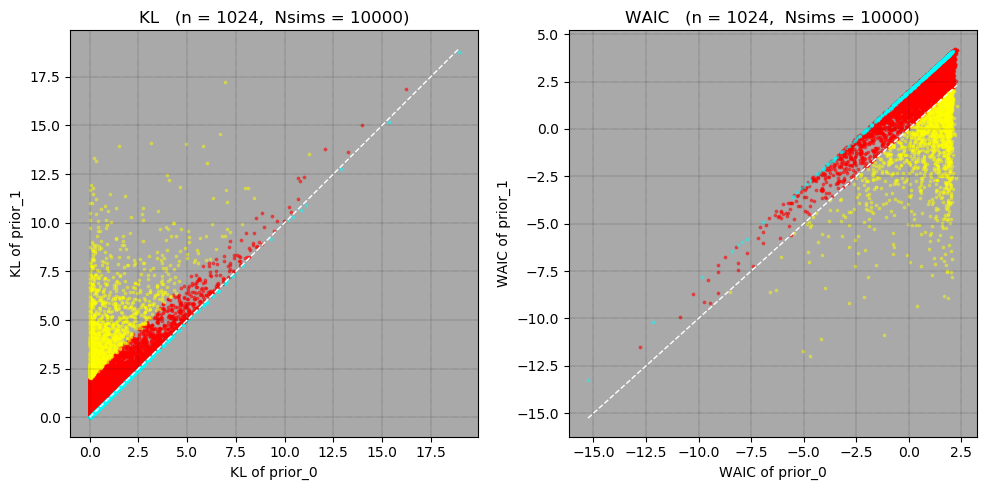

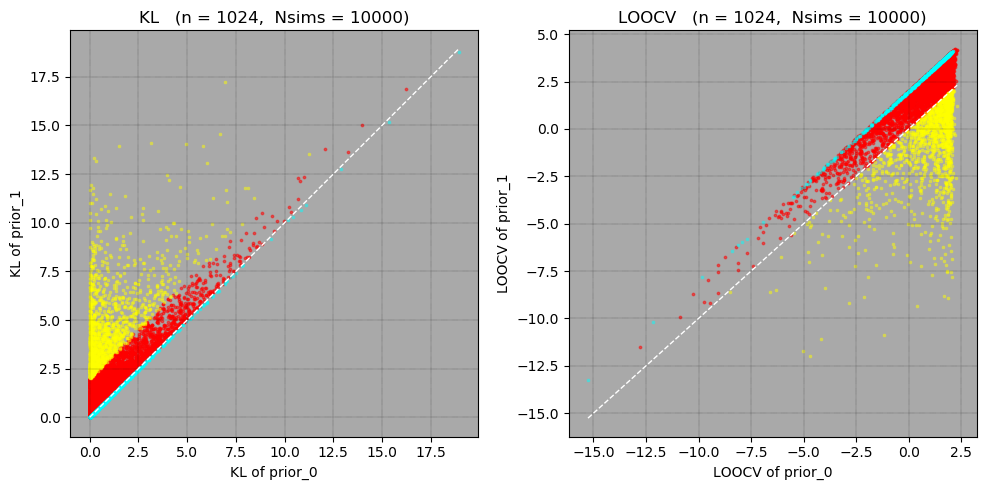

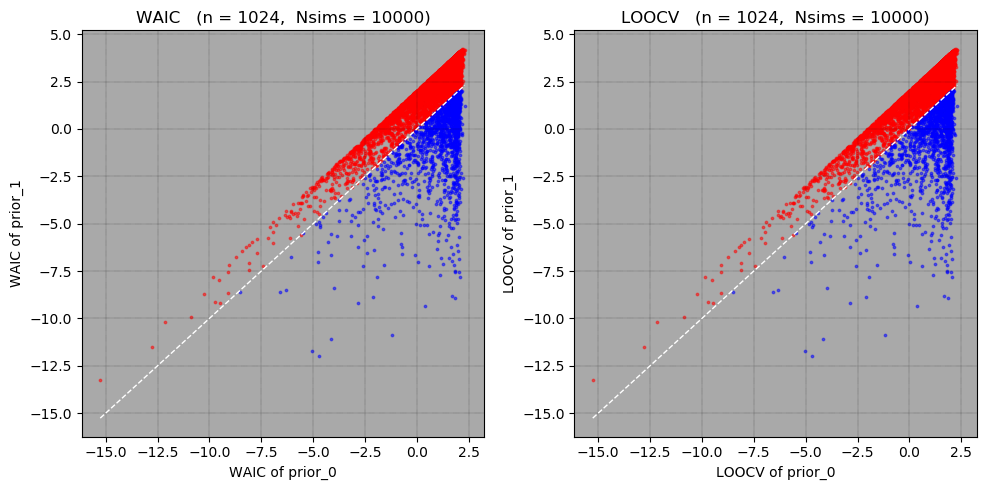

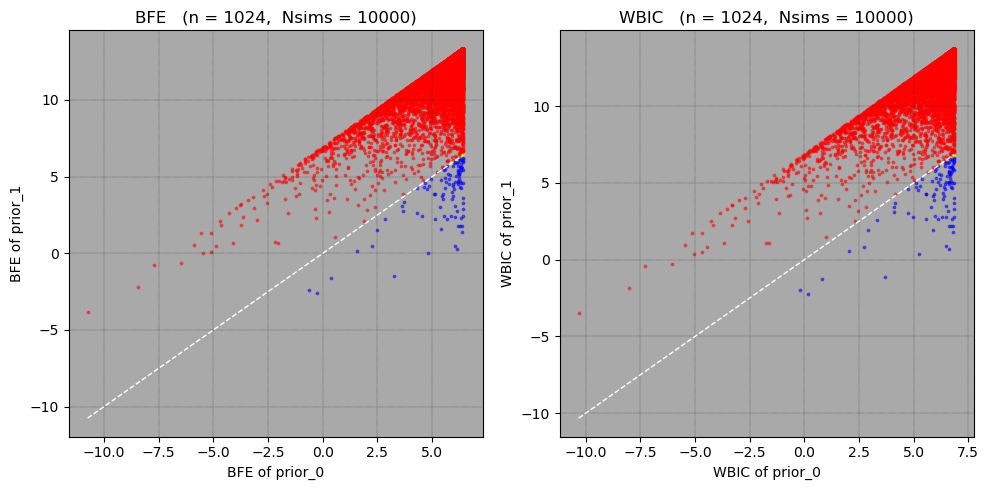

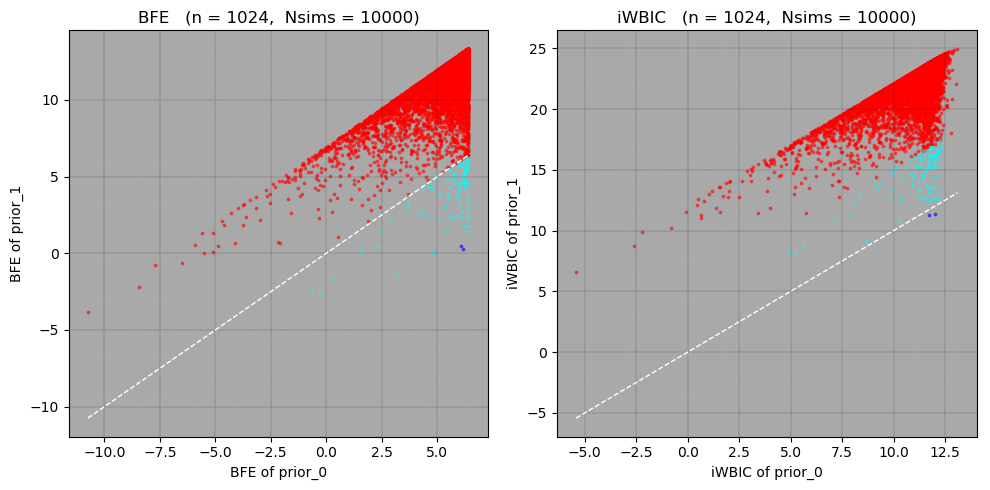

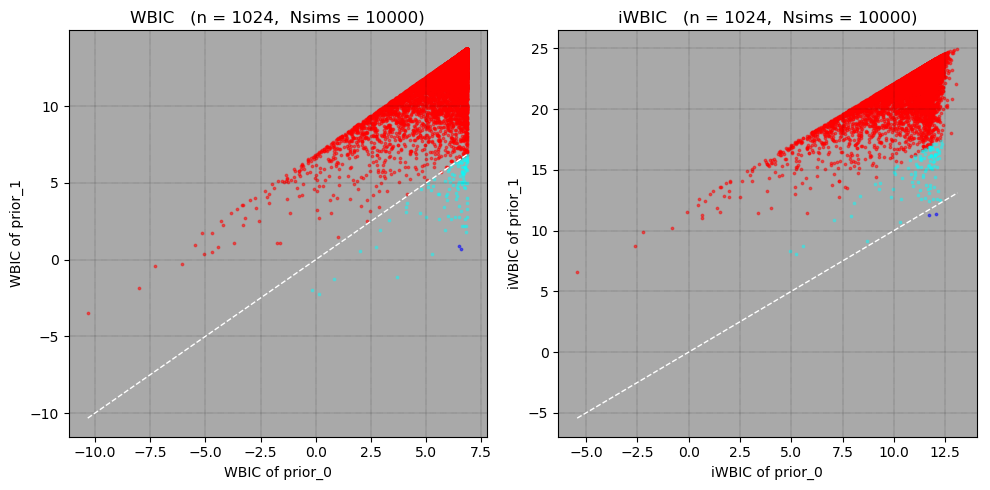

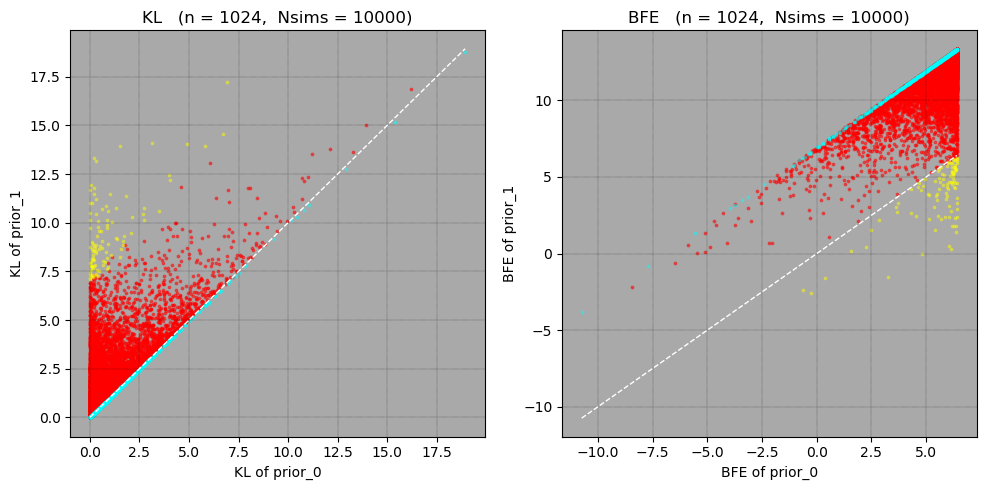

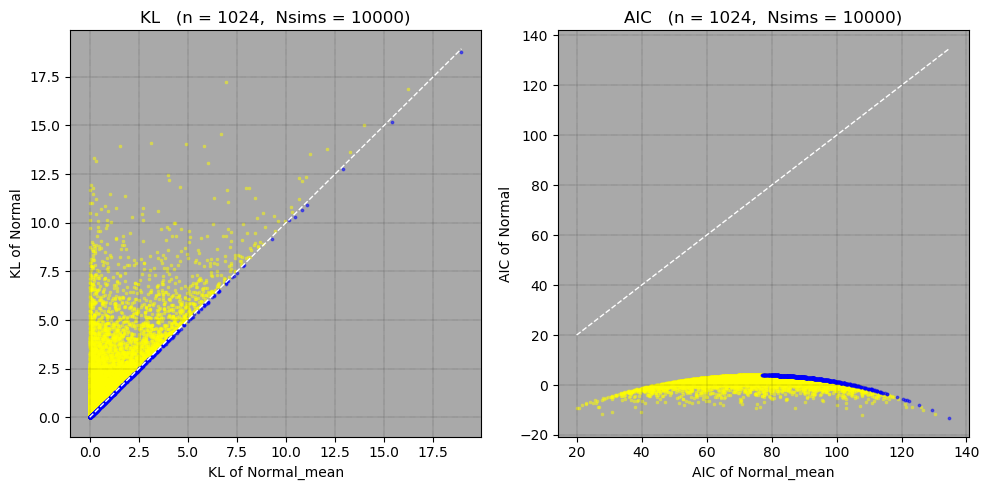

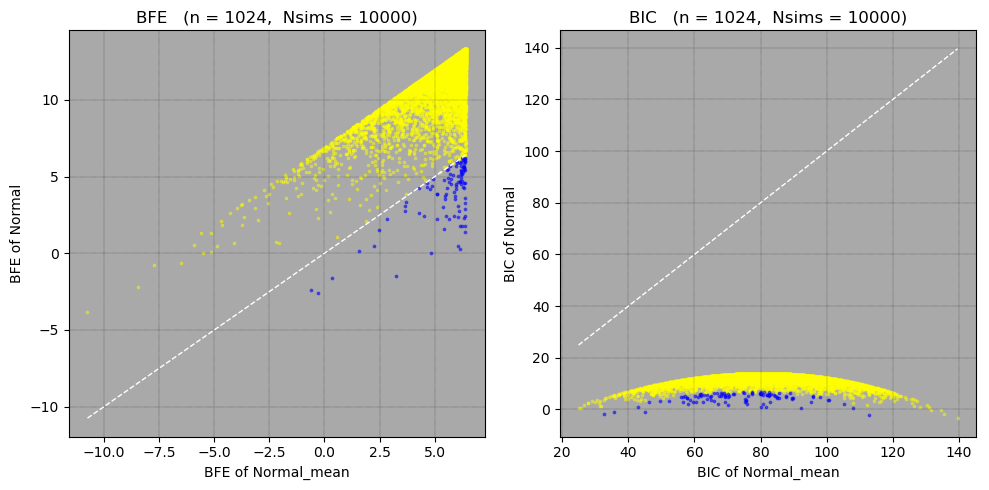

 35.588946 seconds (55.24 M allocations: 4.910 GiB, 2.18% gc time)


In [30]:
@show Nsims = 10000
@show μ₀, μ_λ = 0.0, 1.5
@show dist_true = Normal(μ₀, 1/sqrt(μ_λ))
@show n = 2^10
@show prior0 = NormalGamma(μ₀, 1e8, 1.0, μ_λ/1.0) # Nearly μ=μ₀
@show prior1 = NormalGamma(μ₀, 1.0, 1.0, μ_λ/1.0)
println()
@time show_everything(dist_true, n, prior0, prior1, Nsims=Nsims);

Nsims = 1000 = 1000
(μ₀, μ_λ) = (0.0, 1.5) = (0.0, 1.5)
dist_true = Normal(μ₀ + 0.3, 1 / sqrt(μ_λ)) = Normal{Float64}(μ=0.3, σ=0.8164965809277261)
n = 2 ^ 5 = 32
prior0 = NormalGamma(μ₀, 1.0e8, 1.0, μ_λ / 1.0) = NormalGamma{Float64}(μ₀=0.0, λ₀=1.0e8, α=1.0, θ=1.5)
prior1 = NormalGamma(μ₀, 1.0, 1.0, μ_λ / 1.0) = NormalGamma{Float64}(μ₀=0.0, λ₀=1.0, α=1.0, θ=1.5)

count(KL0s .< KL1s) / Nsims = 0.041
count(WAIC0s .< WAIC1s) / Nsims = 0.306
count(LOOCV0s .< LOOCV1s) / Nsims = 0.309
count(AICms .< AICs) / Nsims = 0.371
count(AICss .< AICs) / Nsims = 0.301

count(BFE0s .< BFE1s) / Nsims = 0.466
count(WBIC0s .< WBIC1s) / Nsims = 0.424
count(iWBIC0s .< iWBIC1s) / Nsims = 0.978
count(BICms .< BICs) / Nsims = 0.576
count(BICss .< BICs) / Nsims = 0.449

cor(KL1s - KL0s, WAIC1s - WAIC0s) = -0.296350387155424
cor(KL1s - KL0s, LOOCV1s - LOOCV0s) = -0.2958206909999285
cor(WAIC1s - WAIC0s, LOOCV1s - LOOCV0s) = 0.9999740265241517
(mean(KL1s - KL0s), std(KL1s - KL0s)) = (-3.052497848991759, 1.4809760991

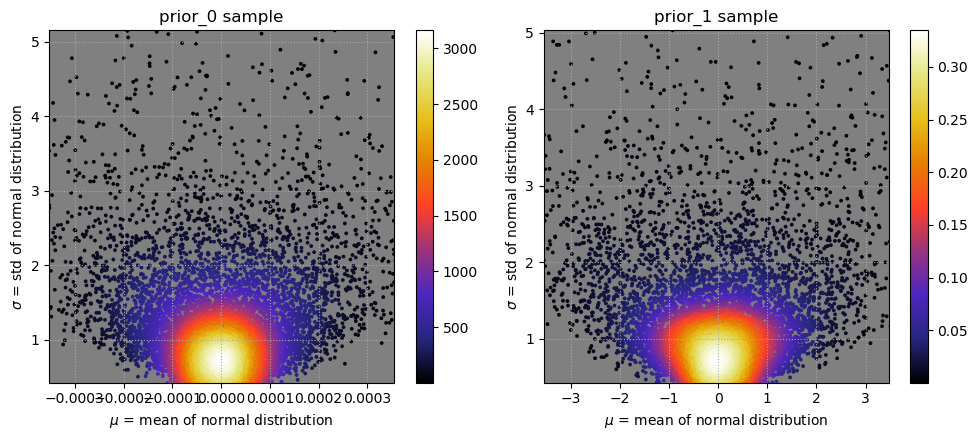

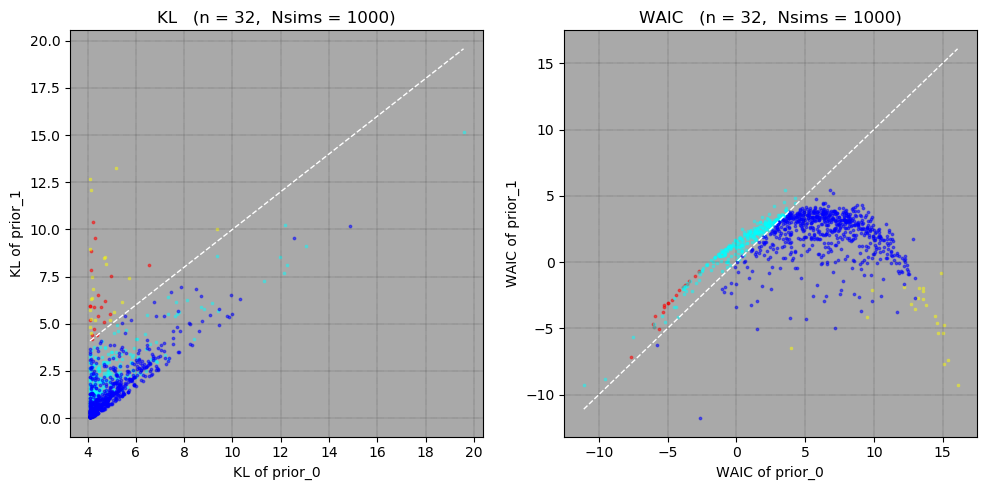

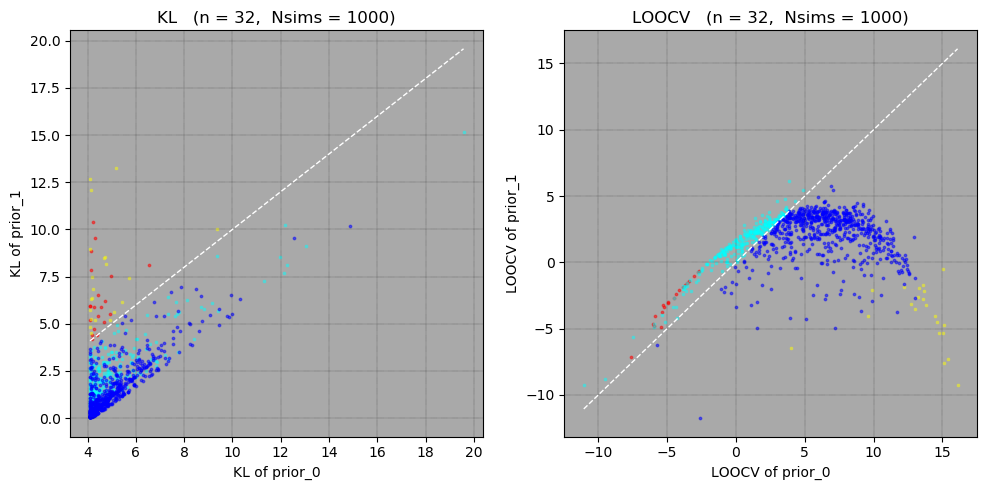

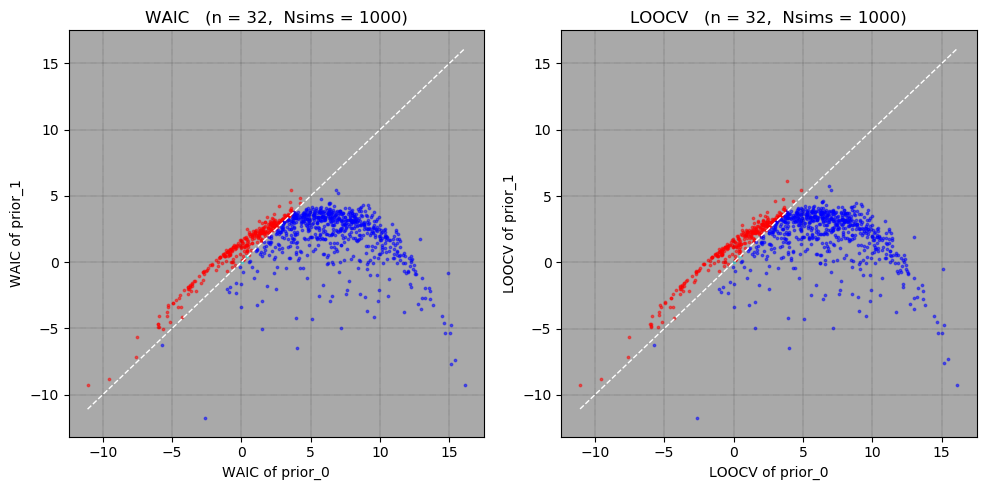

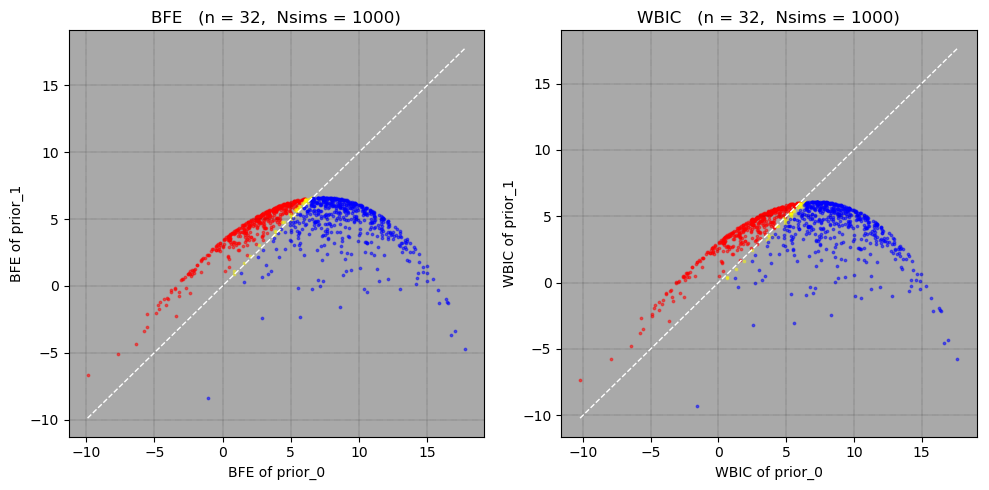

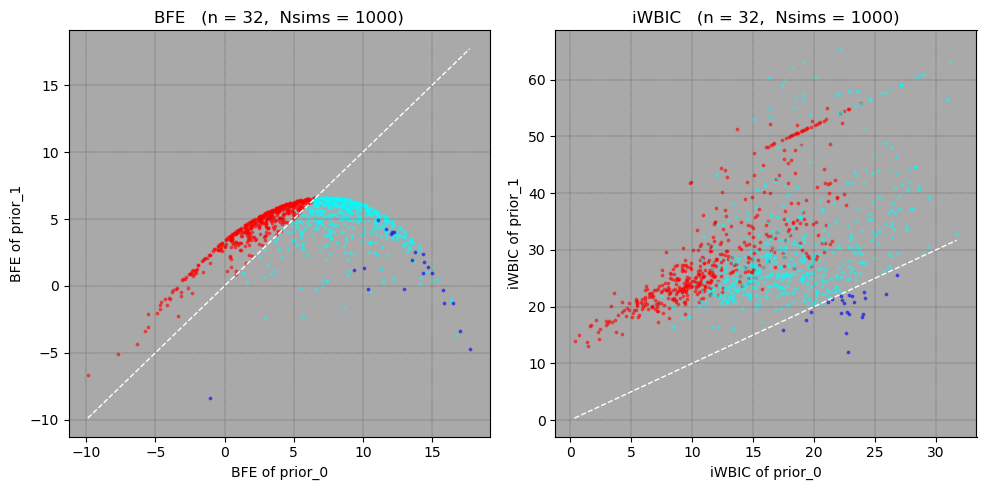

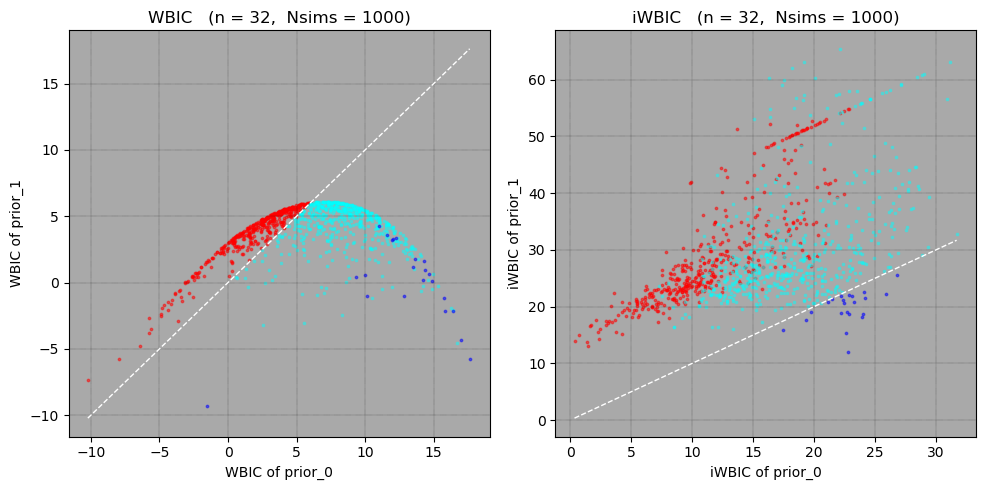

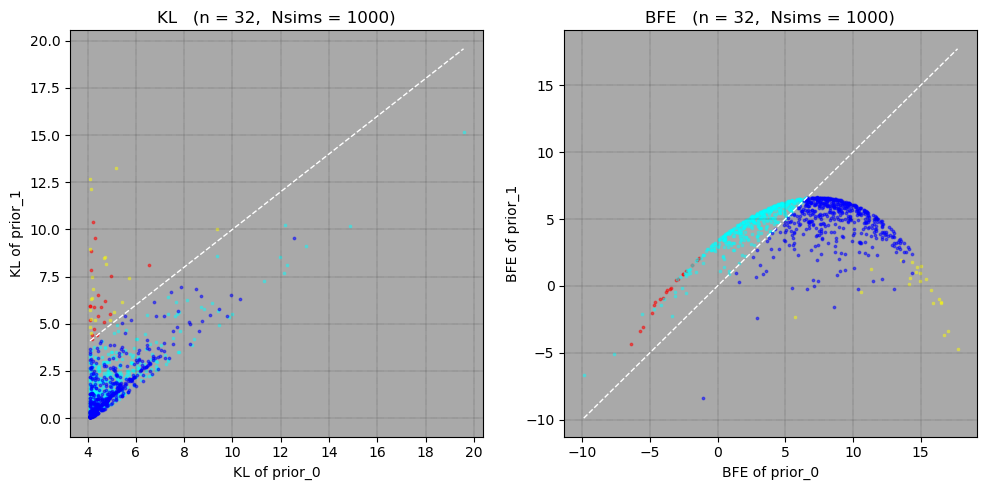

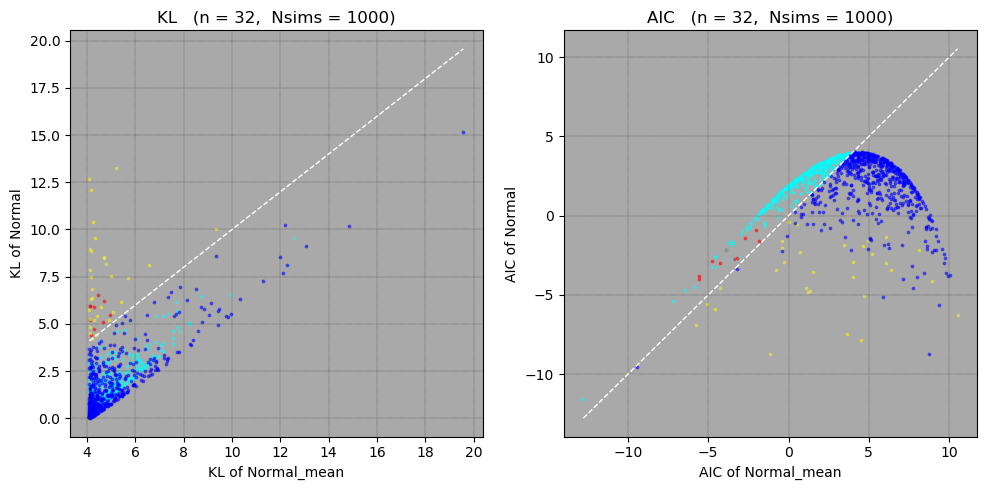

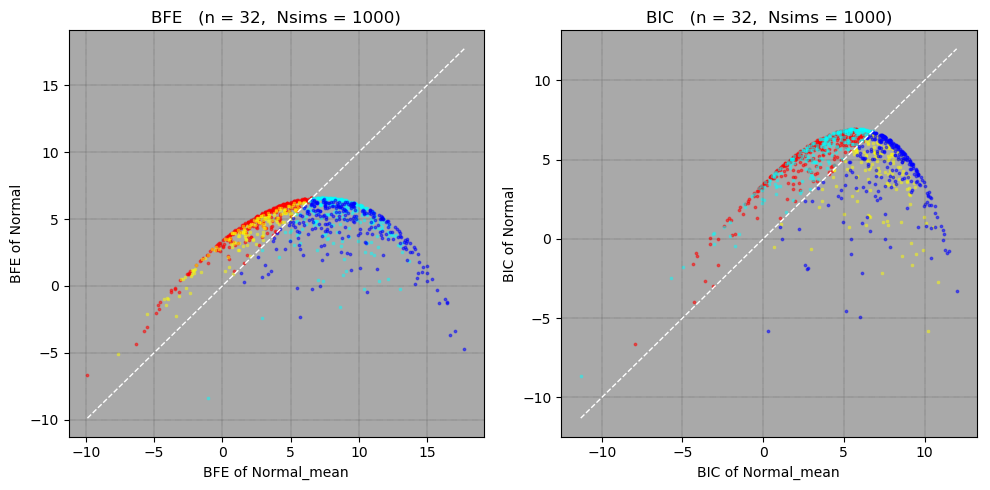

  1.529565 seconds (1.60 M allocations: 61.149 MiB, 1.06% gc time)


In [31]:
@show Nsims = 1000
@show μ₀, μ_λ = 0.0, 1.5
@show dist_true = Normal(μ₀+0.3, 1/sqrt(μ_λ))
@show n = 2^5
@show prior0 = NormalGamma(μ₀, 1e8, 1.0, μ_λ/1.0) # Nearly μ=μ₀
@show prior1 = NormalGamma(μ₀, 1.0, 1.0, μ_λ/1.0)
println()
@time show_everything(dist_true, n, prior0, prior1, Nsims=Nsims);

Nsims = 1000 = 1000
(μ₀, μ_λ) = (0.0, 1.0) = (0.0, 1.0)
dist_true = Normal(μ₀, 1 / sqrt(μ_λ)) = Normal{Float64}(μ=0.0, σ=1.0)
n = 2 ^ 5 = 32
prior0 = NormalGamma(μ₀, 1.0e8, 1.0e8, μ_λ / 1.0e8) = NormalGamma{Float64}(μ₀=0.0, λ₀=1.0e8, α=1.0e8, θ=1.0e-8)
prior1 = NormalGamma(μ₀, 1.0, 1.0, μ_λ / 1.0) = NormalGamma{Float64}(μ₀=0.0, λ₀=1.0, α=1.0, θ=1.0)

count(KL0s .< KL1s) / Nsims = 1.0
count(WAIC0s .< WAIC1s) / Nsims = 0.845
count(LOOCV0s .< LOOCV1s) / Nsims = 0.848
count(AICms .< AICs) / Nsims = 0.843
count(AICss .< AICs) / Nsims = 0.828

count(BFE0s .< BFE1s) / Nsims = 0.964
count(WBIC0s .< WBIC1s) / Nsims = 0.949
count(iWBIC0s .< iWBIC1s) / Nsims = 1.0
count(BICms .< BICs) / Nsims = 0.938
count(BICss .< BICs) / Nsims = 0.929

cor(KL1s - KL0s, WAIC1s - WAIC0s) = -0.9584014282569133
cor(KL1s - KL0s, LOOCV1s - LOOCV0s) = -0.9541144671107721
cor(WAIC1s - WAIC0s, LOOCV1s - LOOCV0s) = 0.9997064849738178
(mean(KL1s - KL0s), std(KL1s - KL0s)) = (1.8483815352131014, 1.9093821341775594)
(mean(W

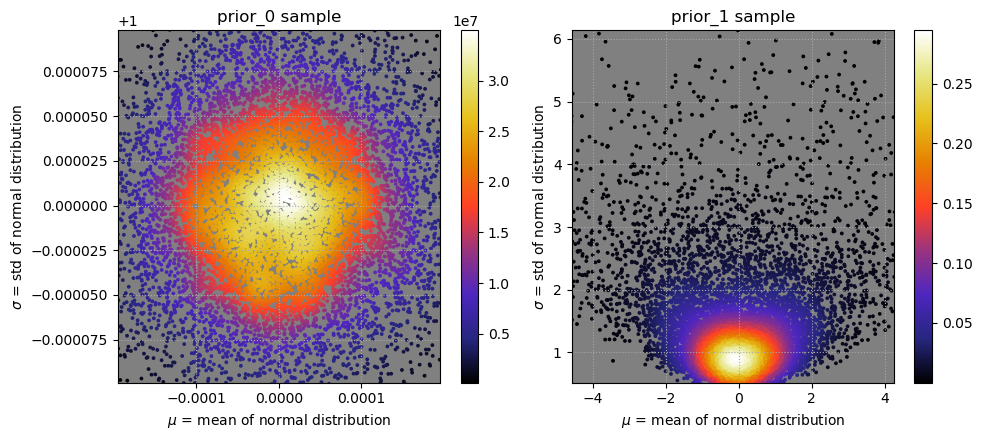

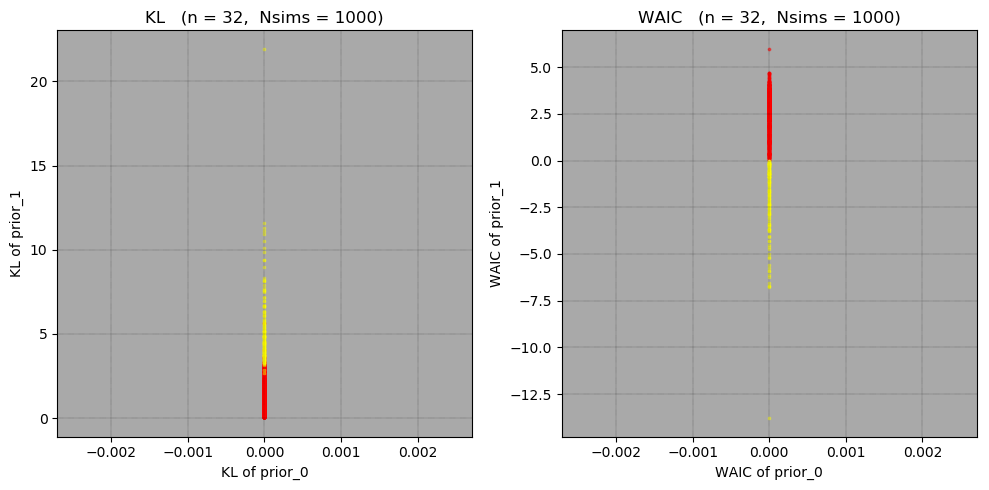

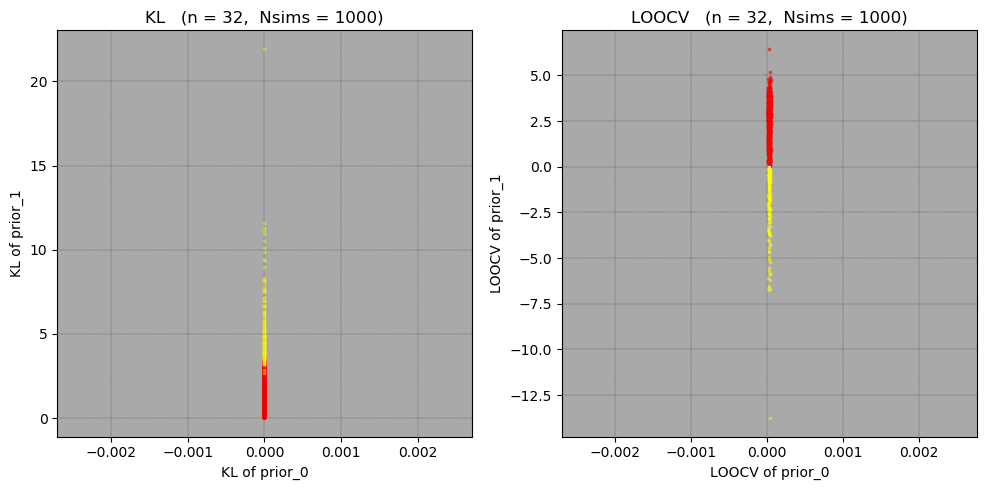

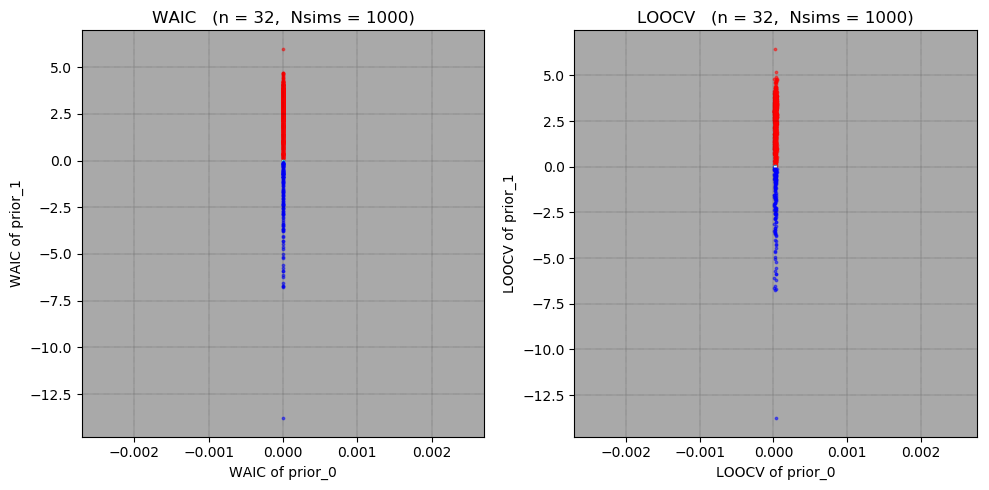

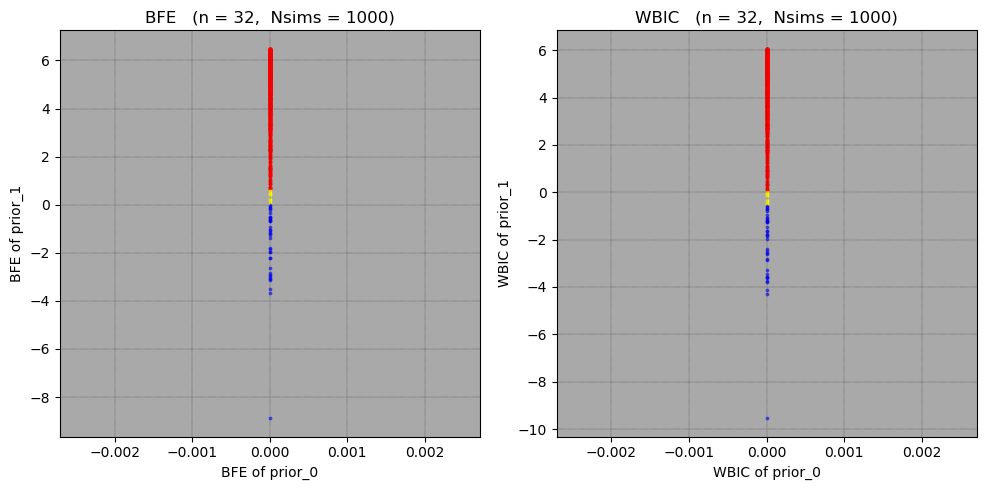

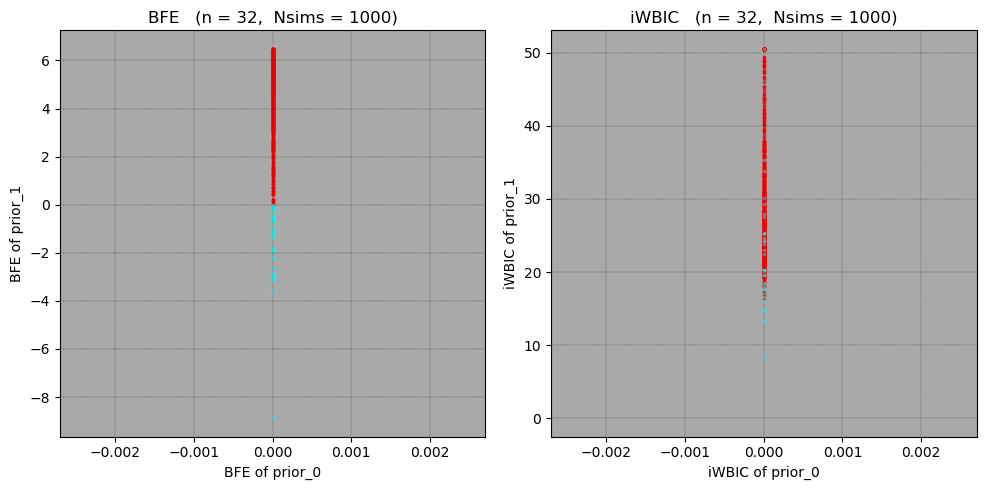

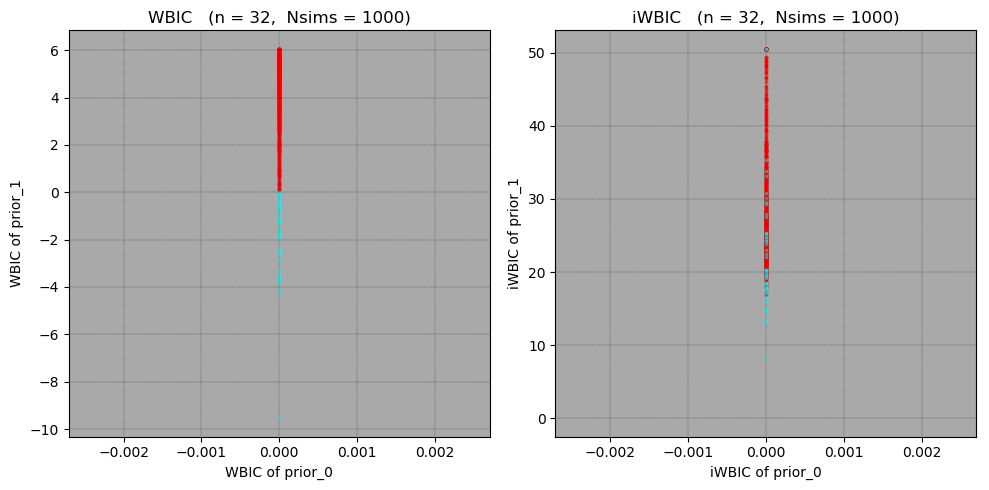

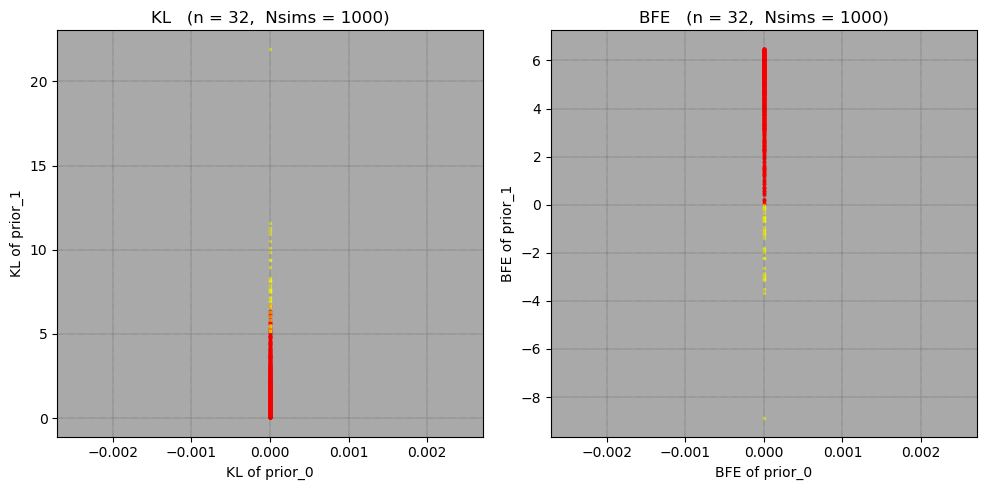

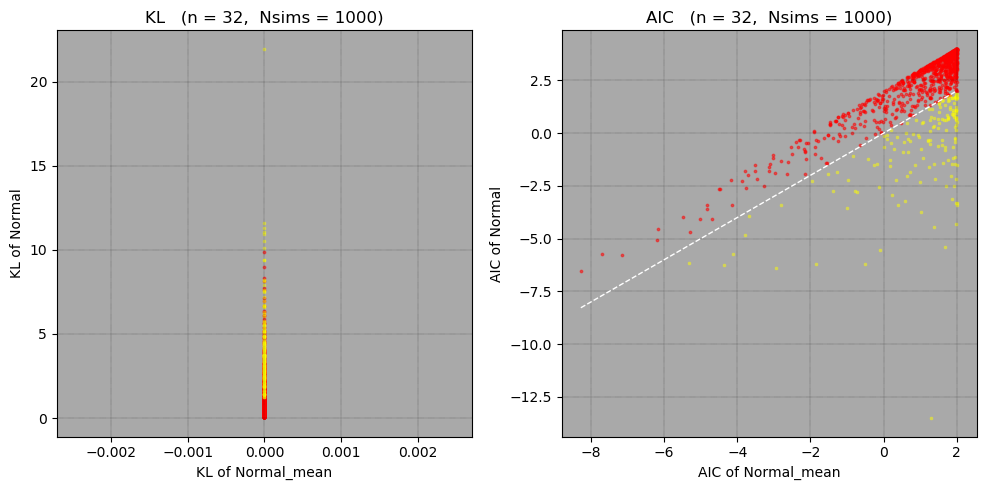

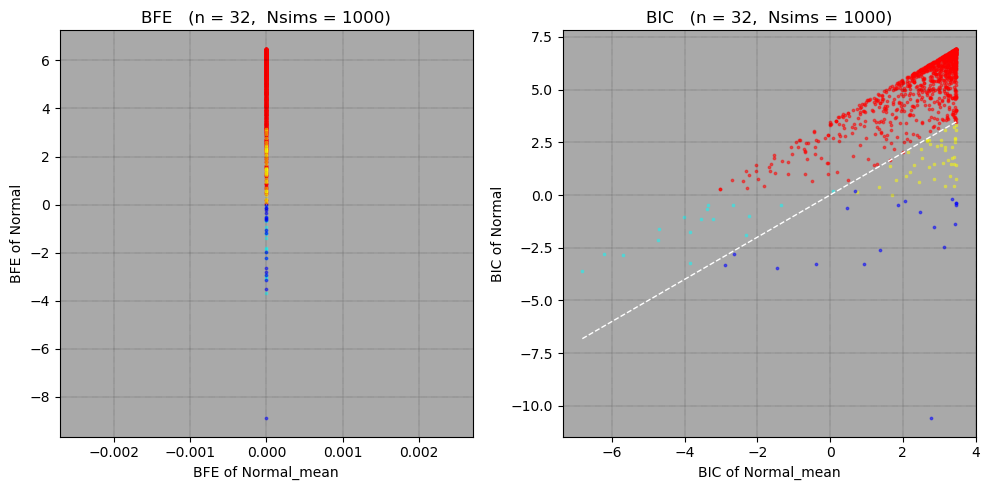

  1.458687 seconds (1.60 M allocations: 61.176 MiB, 0.83% gc time)


In [32]:
@show Nsims = 1000
@show μ₀, μ_λ = 0.0, 1.0
@show dist_true = Normal(μ₀, 1/sqrt(μ_λ))
@show n = 2^5
@show prior0 = NormalGamma(μ₀, 1e8, 1e8, μ_λ/1e8) # Nearly μ=μ₀ and λ=μ_λ
@show prior1 = NormalGamma(μ₀, 1.0, 1.0, μ_λ/1.0)
println()
@time show_everything(dist_true, n, prior0, prior1, Nsims=Nsims);

Nsims = 10000 = 10000
(μ₀, μ_λ) = (0.0, 1.0) = (0.0, 1.0)
dist_true = Normal(μ₀, 1 / sqrt(μ_λ)) = Normal{Float64}(μ=0.0, σ=1.0)
n = 2 ^ 10 = 1024
prior0 = NormalGamma(μ₀, 1.0e8, 1.0e8, μ_λ / 1.0e8) = NormalGamma{Float64}(μ₀=0.0, λ₀=1.0e8, α=1.0e8, θ=1.0e-8)
prior1 = NormalGamma(μ₀, 1.0, 1.0, μ_λ / 1.0) = NormalGamma{Float64}(μ₀=0.0, λ₀=1.0, α=1.0, θ=1.0)

count(KL0s .< KL1s) / Nsims = 1.0
count(WAIC0s .< WAIC1s) / Nsims = 0.8635
count(LOOCV0s .< LOOCV1s) / Nsims = 0.8635
count(AICms .< AICs) / Nsims = 0.8361
count(AICss .< AICs) / Nsims = 0.8384

count(BFE0s .< BFE1s) / Nsims = 0.9987
count(WBIC0s .< WBIC1s) / Nsims = 0.9987
count(iWBIC0s .< iWBIC1s) / Nsims = 1.0
count(BICms .< BICs) / Nsims = 0.9918
count(BICss .< BICs) / Nsims = 0.9914

cor(KL1s - KL0s, WAIC1s - WAIC0s) = -0.9981581628469638
cor(KL1s - KL0s, LOOCV1s - LOOCV0s) = -0.998157870309833
cor(WAIC1s - WAIC0s, LOOCV1s - LOOCV0s) = 0.9999999923857622
(mean(KL1s - KL0s), std(KL1s - KL0s)) = (2.0174152058952792, 2.0459149533560

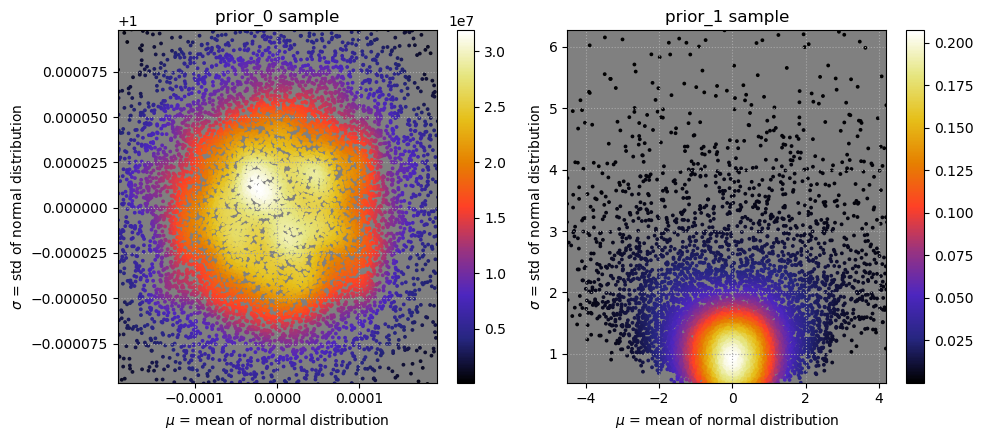

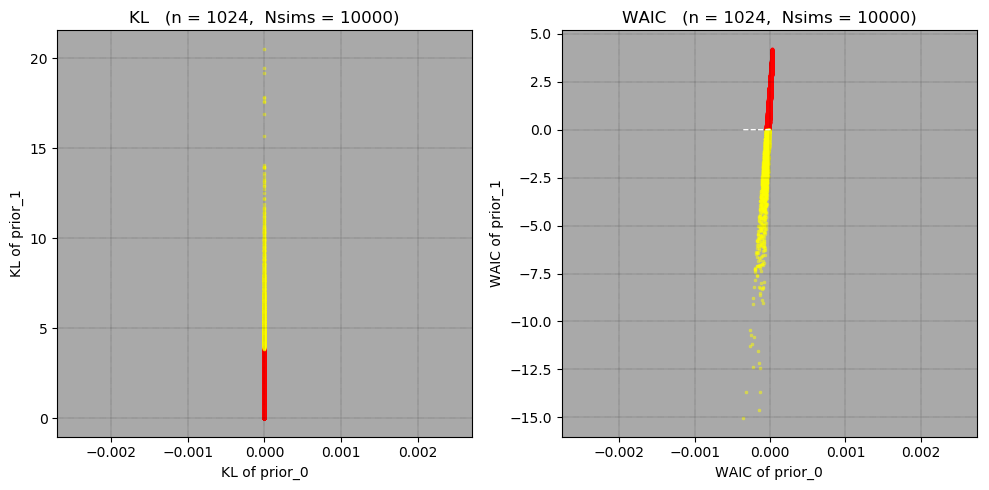

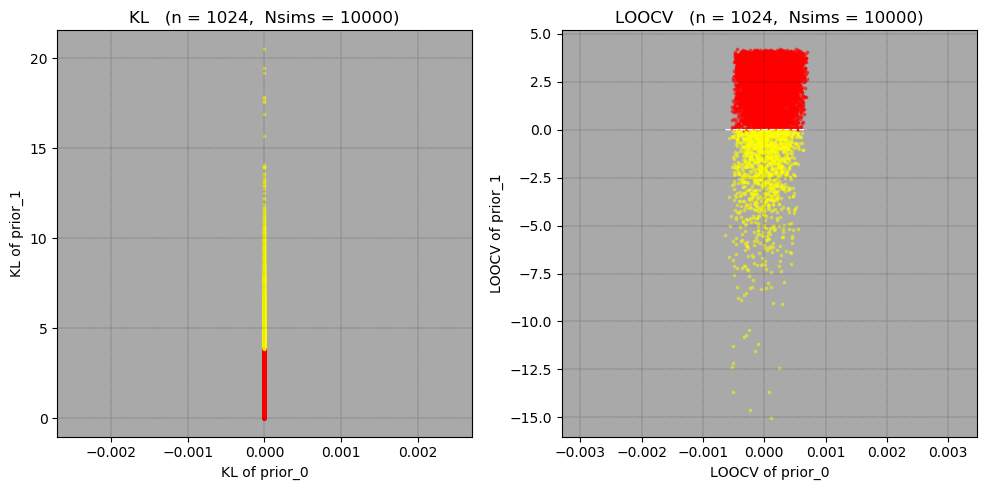

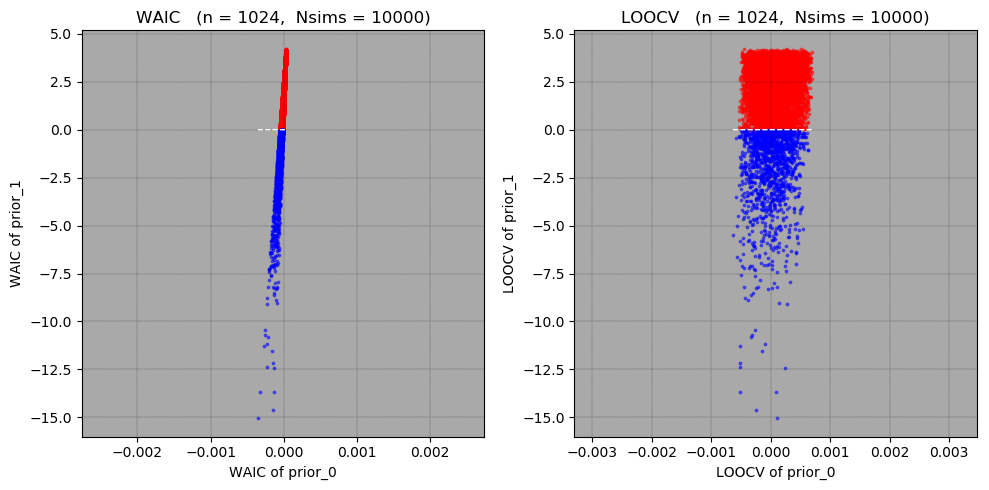

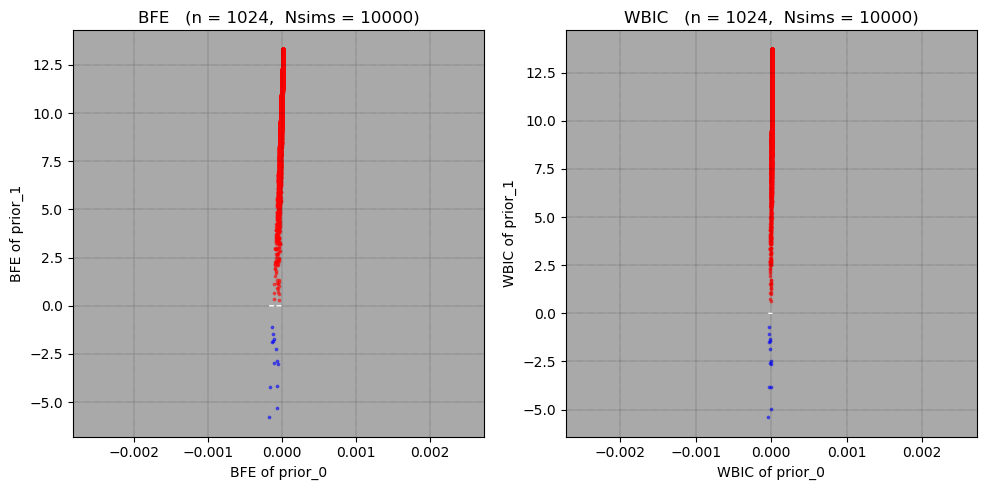

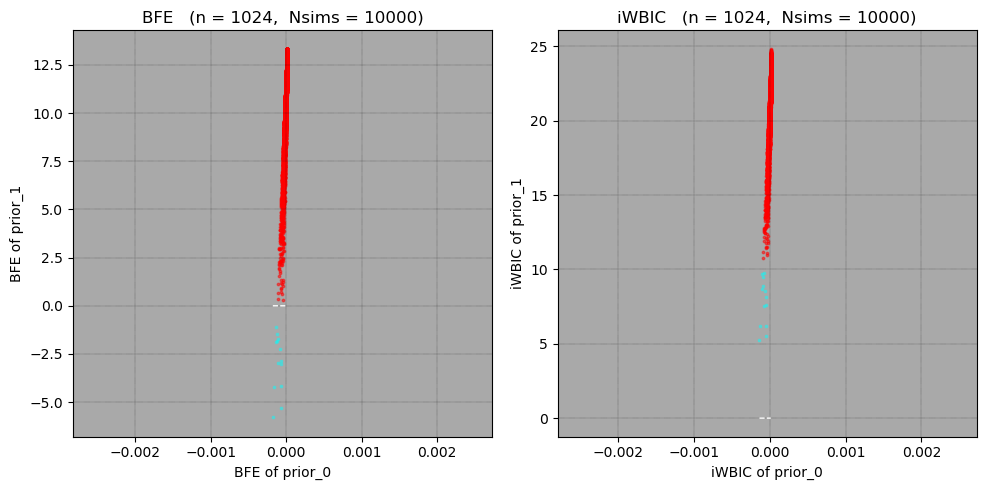

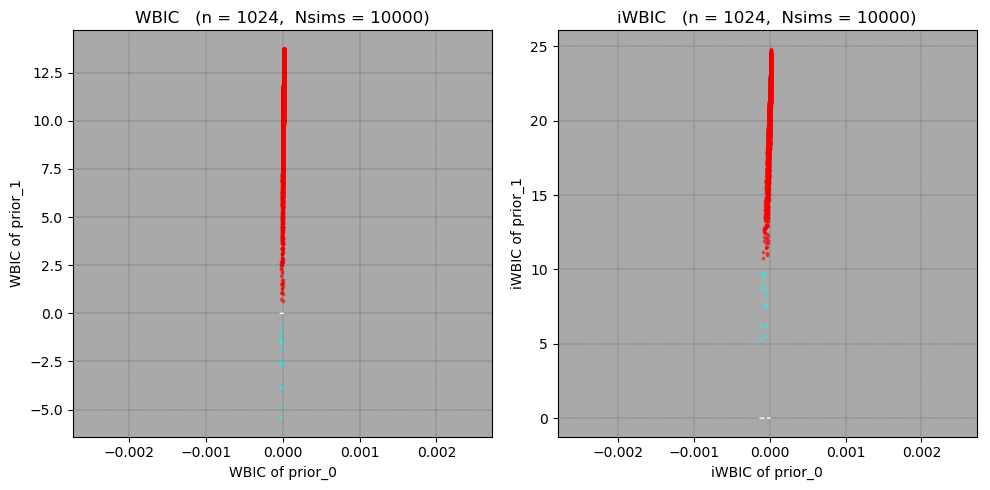

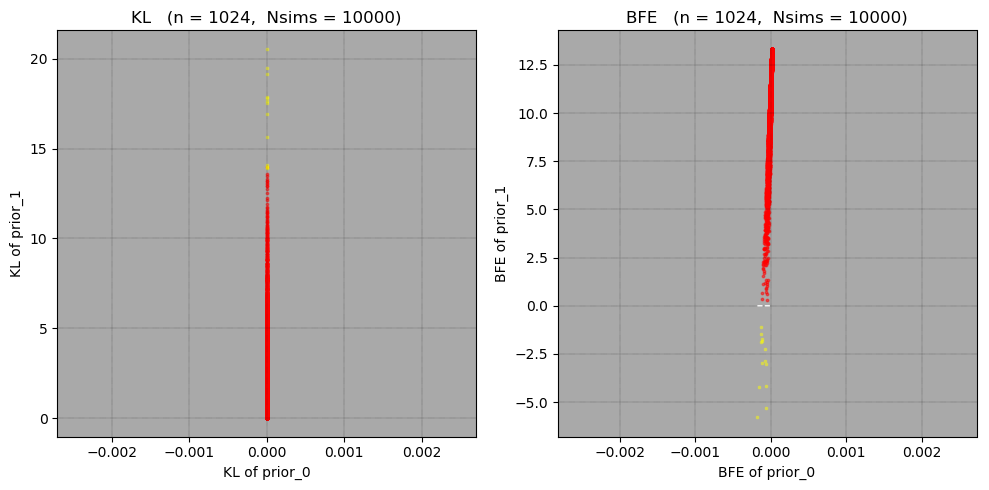

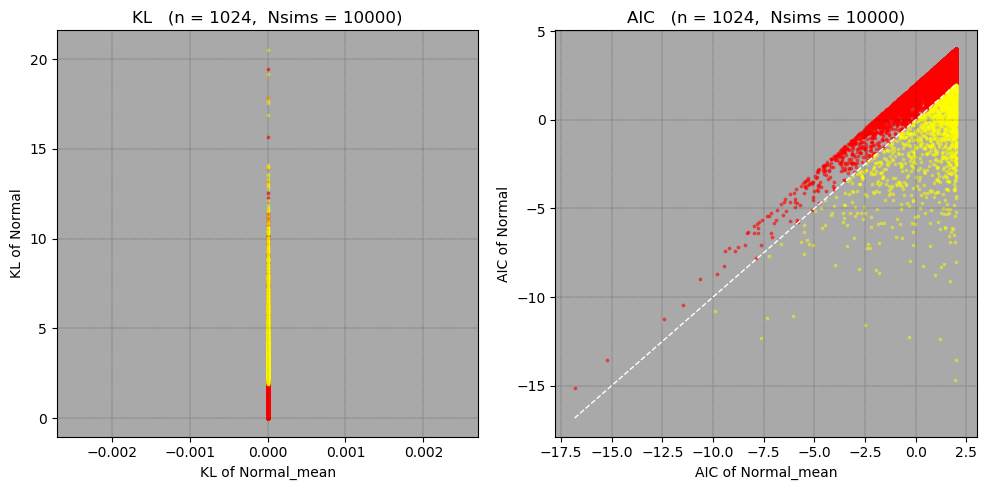

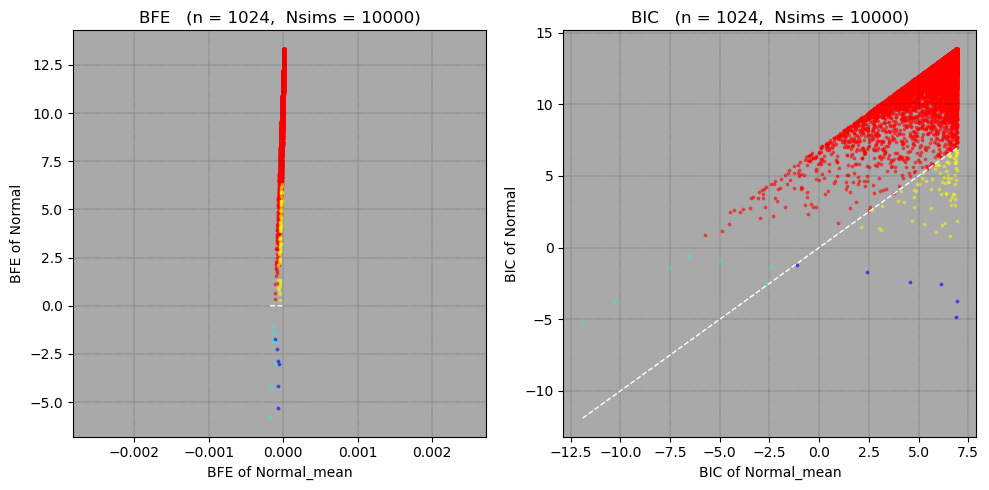

 33.771234 seconds (55.24 M allocations: 4.910 GiB, 2.32% gc time)


In [33]:
@show Nsims = 10000
@show μ₀, μ_λ = 0.0, 1.0
@show dist_true = Normal(μ₀, 1/sqrt(μ_λ))
@show n = 2^10
@show prior0 = NormalGamma(μ₀, 1e8, 1e8, μ_λ/1e8) # Nearly μ=μ₀ and λ=μ_λ
@show prior1 = NormalGamma(μ₀, 1.0, 1.0, μ_λ/1.0)
println()
@time show_everything(dist_true, n, prior0, prior1, Nsims=Nsims);

Nsims = 1000 = 1000
(μ₀, μ_λ) = (0.0, 1.0) = (0.0, 1.0)
dist_true = Normal(μ₀ + 0.2, 1 / sqrt(μ_λ - 0.4)) = Normal{Float64}(μ=0.2, σ=1.2909944487358056)
n = 2 ^ 5 = 32
prior0 = NormalGamma(μ₀, 1.0e16, 1.0e16, μ_λ / 1.0e16) = NormalGamma{Float64}(μ₀=0.0, λ₀=1.0e16, α=1.0e16, θ=1.0e-16)
prior1 = NormalGamma(μ₀, 1.0, 1.0, μ_λ / 1.0) = NormalGamma{Float64}(μ₀=0.0, λ₀=1.0, α=1.0, θ=1.0)

count(KL0s .< KL1s) / Nsims = 0.043
count(WAIC0s .< WAIC1s) / Nsims = 0.287
count(LOOCV0s .< LOOCV1s) / Nsims = 1.0
count(AICms .< AICs) / Nsims = 0.34
count(AICss .< AICs) / Nsims = 0.683

count(BFE0s .< BFE1s) / Nsims = 1.0
count(WBIC0s .< WBIC1s) / Nsims = 0.46
count(iWBIC0s .< iWBIC1s) / Nsims = 0.862
count(BICms .< BICs) / Nsims = 0.463
count(BICss .< BICs) / Nsims = 0.832

cor(KL1s - KL0s, WAIC1s - WAIC0s) = -0.24260850222255856
cor(KL1s - KL0s, LOOCV1s - LOOCV0s) = -0.3305021088295908
cor(WAIC1s - WAIC0s, LOOCV1s - LOOCV0s) = -0.6998453123668417
(mean(KL1s - KL0s), std(KL1s - KL0s)) = (-4.28734683224

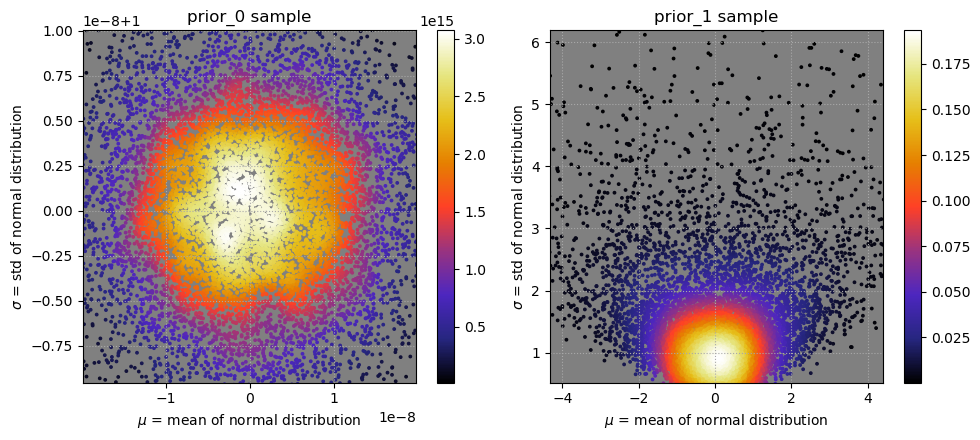

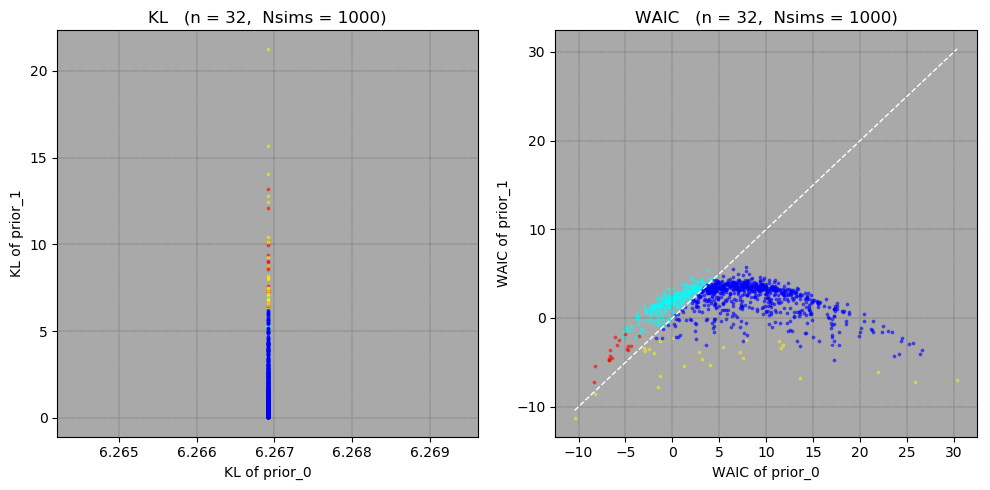

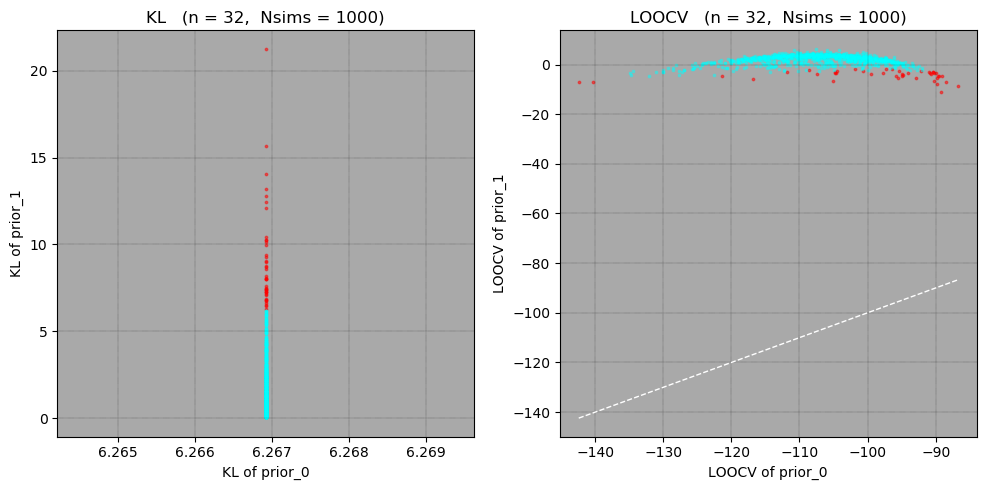

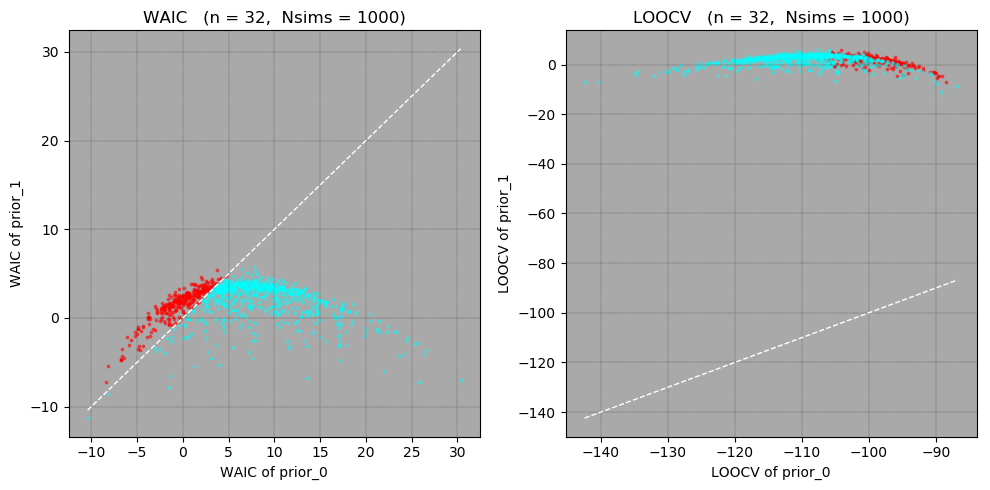

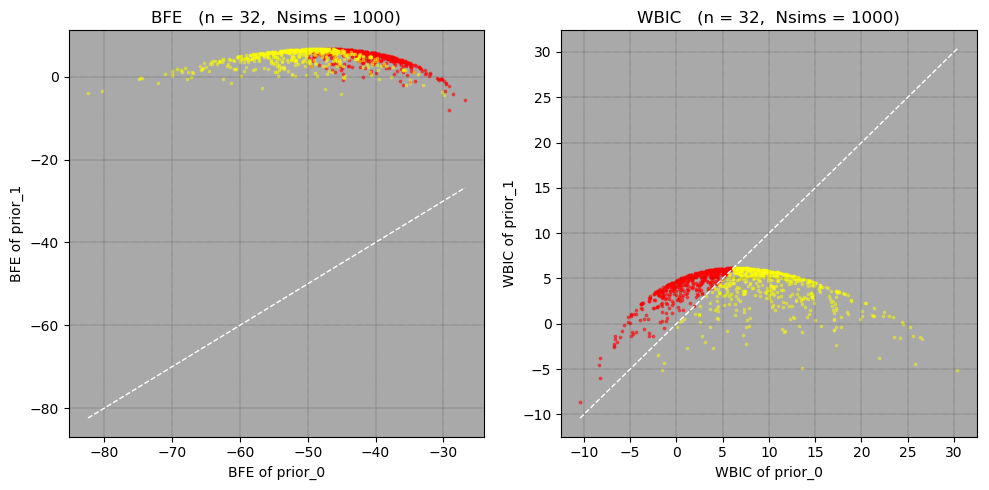

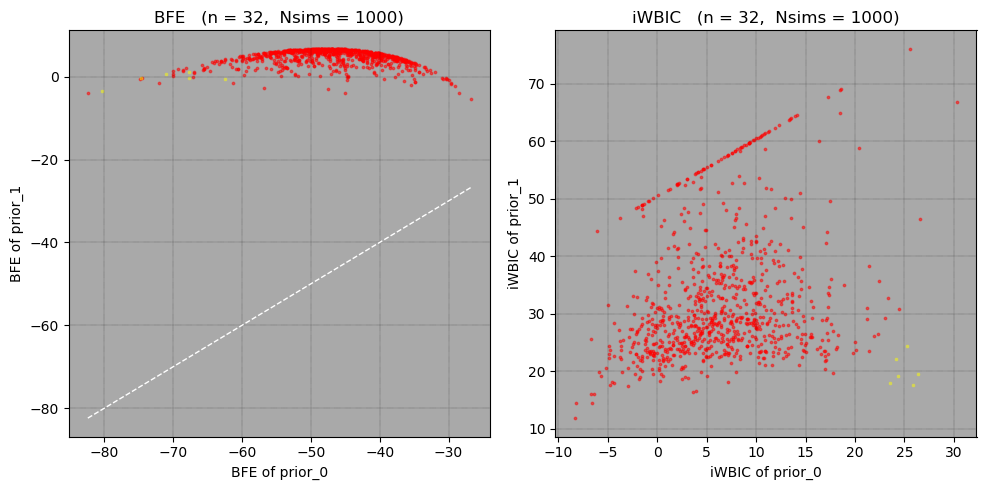

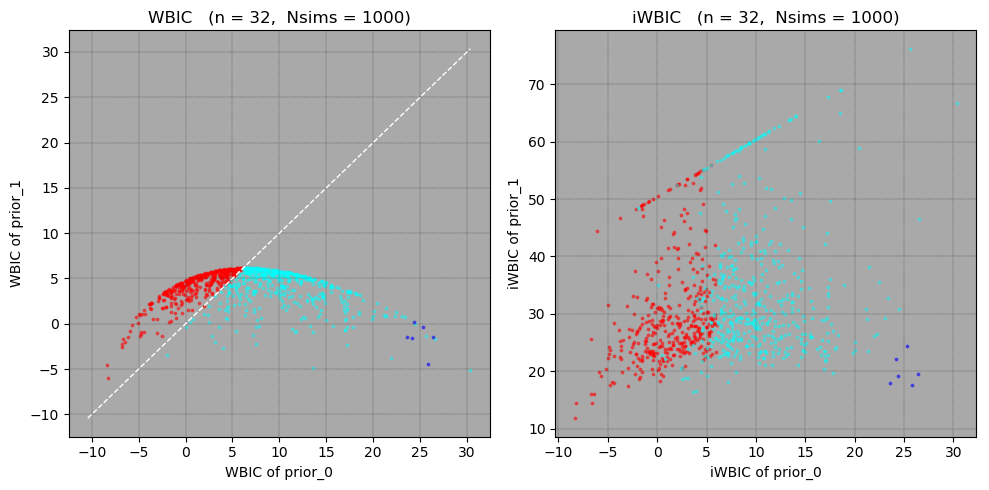

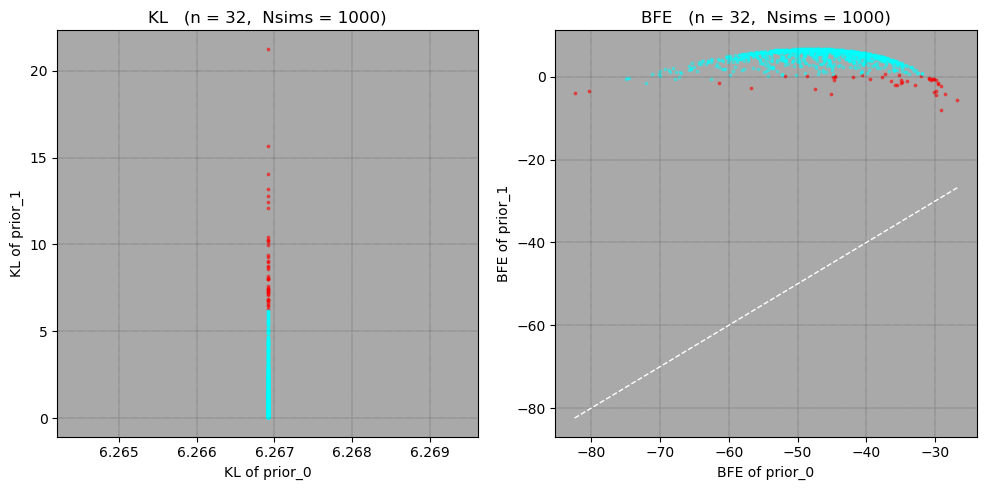

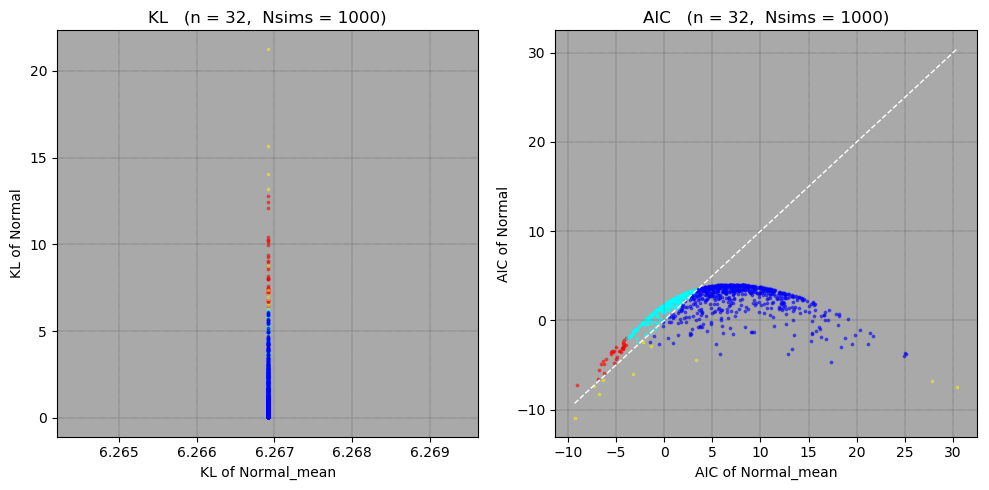

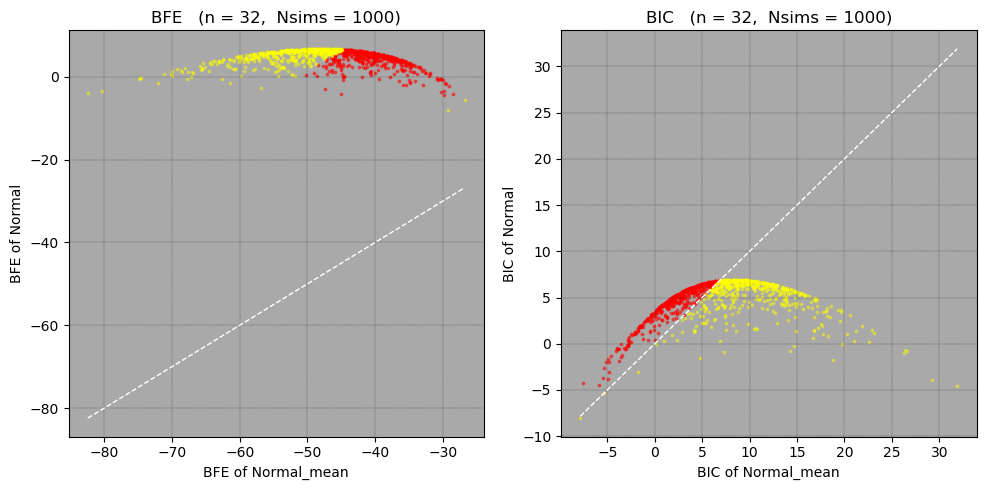

  1.671403 seconds (1.41 M allocations: 57.263 MiB, 0.68% gc time)


In [34]:
@show Nsims = 1000
@show μ₀, μ_λ = 0.0, 1.0
@show dist_true = Normal(μ₀+0.2, 1/sqrt(μ_λ-0.4))
@show n = 2^5
@show prior0 = NormalGamma(μ₀, 1e16, 1e16, μ_λ/1e16) # Nearly μ=μ₀ and λ=μ_λ
@show prior1 = NormalGamma(μ₀, 1.0, 1.0, μ_λ/1.0)
println()
@time show_everything(dist_true, n, prior0, prior1, Nsims=Nsims);